In [ ]:
#!pip install bayesian-optimization  # for google collab
#!pip3 install git+https://github.com/slremy/netsapi --user --upgrade


In [1]:
from bayes_opt import BayesianOptimization
from bayes_opt.util import UtilityFunction
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import mlab
from matplotlib import gridspec
%matplotlib inline

In [2]:
#challenge import
from netsapi.challenge import *
 
from sys import exit, exc_info, argv
from multiprocessing import Pool, current_process
import random as rand
import json
import requests
import numpy as np
import pandas as pd


import statistics
from IPython.display import clear_output

from contextlib import contextmanager
import sys, os
@contextmanager
def suppress_stdout():
    with open(os.devnull, "w") as devnull:
        old_stdout = sys.stdout
        sys.stdout = devnull
        try:  
            yield
        finally:
            sys.stdout = old_stdout

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
print("done")

done


In [3]:
envSeqDec = ChallengeSeqDecEnvironment()
x_start = 0.0
x_end = 1.0

VAL_Max = 1.2 # fel heat map

def target1(x, y):
    x = np.asscalar(x)
    y = np.asscalar(y)
    envSeqDec.reset()
    action = [x , y]
    print("action",action)
    s,r,d,_ = envSeqDec.evaluateAction(action)
    return r/90.0    

def target(x,y):
    if type(x) is np.ndarray:
        result = []
        for a,b in zip(x,y):
            reward = target1(a,b)
            result.append( reward )
            #print((len(result) % 30 ) )
            #if ((len(result) % 30 ) > 25) : 
            #    global envSeqDec
            #    envSeqDec = ChallengeSeqDecEnvironment()
        return result
    else:
        return target1(x,y)


In [4]:
# for the training
n = 1e5
x = y = np.linspace(x_start, x_end, 300)# was 300
X, Y = np.meshgrid(x, y)
x = X.ravel()
y = Y.ravel()
X = np.vstack([x, y]).T[:, [1, 0]]

In [35]:
def posterior(bo, X):
    #ur = unique_rows(bo.X)
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    y_obs = np.array([res["target"] for res in bo.res])
    
    bo._gp.fit(x_obs, y_obs)
    
    mu, sigma = bo._gp.predict(X, return_std=True)
    return mu, sigma

def plot_2d(name=None):

    #mu, s, ut = posterior(bo, X)
    mu, s = posterior(bo, X)

    fig, ax = plt.subplots(2, 2, figsize=(14, 10))
    gridsize=150

    # fig.suptitle('Bayesian Optimization in Action', fontdict={'size':30})
    x_obs = np.array([[res["params"]["x"], res["params"]["y"]] for res in bo.res])
    # GP regression output
    ax[0][0].set_title('Gausian Process Predicted Mean; max='+str(round(np.amax(mu)*90,0))+" min="+str(round(np.amin(mu)*90,0)), fontdict={'size':15})
    im00 = ax[0][0].hexbin(x, y, C=mu, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][0].axis([x.min(), x.max(), y.min(), y.max()])
    ax[0][0].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k', label='Observations')

    ax[0][1].set_title('Target Function', fontdict={'size':15})
    """
    im10 = ax[0][1].hexbin(x, y, C=z, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=-VAL_Max, vmax=VAL_Max)
    ax[0][1].axis([x.min(), x.max(), y.min(), y.max()])
    #ax[0][1].plot(bo.X[:, 1], bo.X[:, 0], 'D', markersize=4, color='k')
    ax[0][1].plot(x_obs[:, 1], x_obs[:, 0], 'D', markersize=4, color='k')
    """

    ax[1][0].set_title('Gausian Process Variance', fontdict={'size':15})
    im01 = ax[1][0].hexbin(x, y, C=s, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=1)
    ax[1][0].axis([x.min(), x.max(), y.min(), y.max()])

    ax[1][1].set_title('Acquisition Function', fontdict={'size':15})
    # acquisition func
    """
    im11 = ax[1][1].hexbin(x, y, C=ut, gridsize=gridsize, cmap=cm.jet, bins=None, vmin=0, vmax=8)

    np.where(ut.reshape((300, 300)) == ut.max())[0]
    np.where(ut.reshape((300, 300)) == ut.max())[1]

    ax[1][1].plot([np.where(ut.reshape((300, 300)) == ut.max())[1]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[1]/50.], 
                  [0, 6], 
                  'k-', lw=2, color='k')

    ax[1][1].plot([0, 6],
                  [np.where(ut.reshape((300, 300)) == ut.max())[0]/50., 
                   np.where(ut.reshape((300, 300)) == ut.max())[0]/50.], 
                  'k-', lw=2, color='k')

    ax[1][1].axis([x.min(), x.max(), y.min(), y.max()])
    """
    for im, axis in zip([im00, im01], ax.flatten()):#, im10, im11
        cb = fig.colorbar(im, ax=axis)
        # cb.set_label('Value')

    if name is None:
        name = '_'

    plt.tight_layout()

    # Save or show figure?
    # fig.savefig('bo_eg_' + name + '.png')
    plt.show()
    plt.close(fig)


|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1377861850253913, 0.21685444537600307]
105  Evaluations Remaining
|  1        |  0.04746  |  0.1378   |  0.2169   |
action [0.5245858139463382, 0.06398910188455631]
104  Evaluations Remaining
|  2        |  0.3178   |  0.5246   |  0.06399  |
action [0.9774283025653429, 0.26455788802804536]
103  Evaluations Remaining
|  3        |  0.2215   |  0.9774   |  0.2646   |
action [0.01244899248725928, 0.7218685319512997]
102  Evaluations Remaining
|  4        |  0.881    |  0.01245  |  0.7219   |
action [0.7061699520197193, 0.7965733077247269]
101  Evaluations Remaining
|  5        |  0.4252   |  0.7062   |  0.7966   |


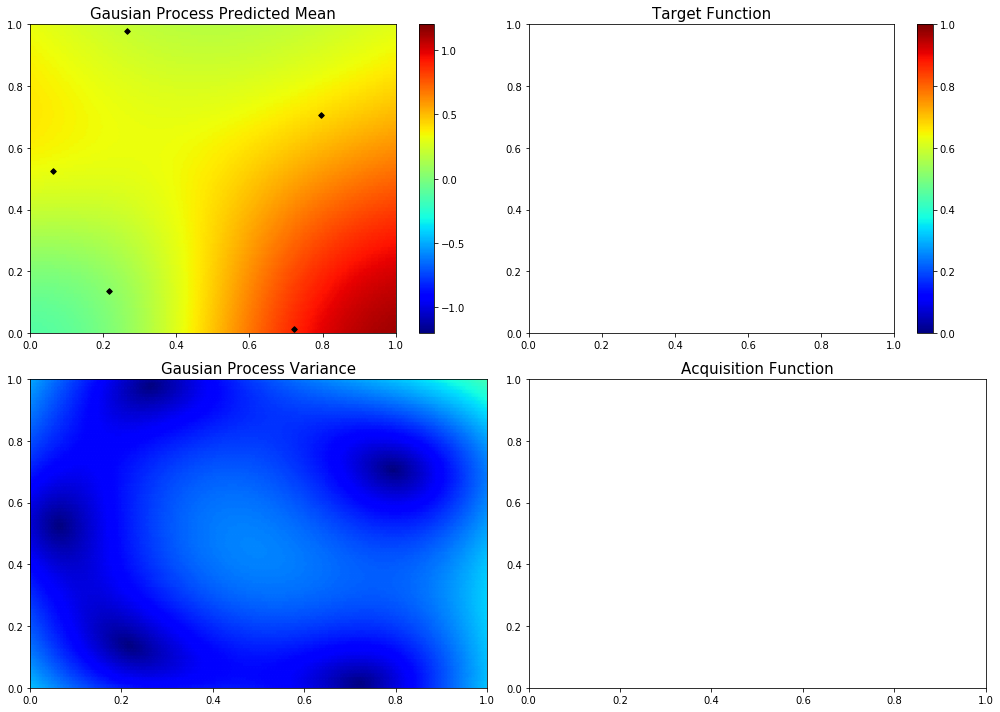

In [6]:
bo = BayesianOptimization(target, {'x': (x_start, x_end), 'y': (x_start, x_end)})

used_kappa = 10

bo.maximize(init_points=5, n_iter=0, acq='ucb', kappa=used_kappa)

plot_2d()

In [20]:
def invRL(policy):
    old_policy = [0.0, 0.0]
    tot = [] # 0.0
    for year in range(5):
        trans_policy = policy[year]
        trans_policy[0] *= (1.0 - old_policy[0])
        trans_policy[1] *= (1.0 - old_policy[1])

        r_mu, r_sigma = bo._gp.predict([trans_policy], return_std=True)
        print("invRL y", year+1 , ": ",r_mu," +- ", r_sigma) # ben lezem +- el racine bte3ha
        old_policy = policy[year]
        tot.append(r_mu*90) 
    return tot


def testHolePolicy(policy):
    global envSeqDec
    envSeqDec.reset()
    year=0
    tot=0.0
    while True:
        action =  policy[year]
        nextstate, reward, done, _ = envSeqDec.evaluateAction(list(action))
        print("test y", year+1 , ": ",reward)
        tot += reward
        if done:
            break
        year+=1
    return tot

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 1.0]
100  Evaluations Remaining
|  6        |  0.1815   |  1.0      |  1.0      |
myplot:  006


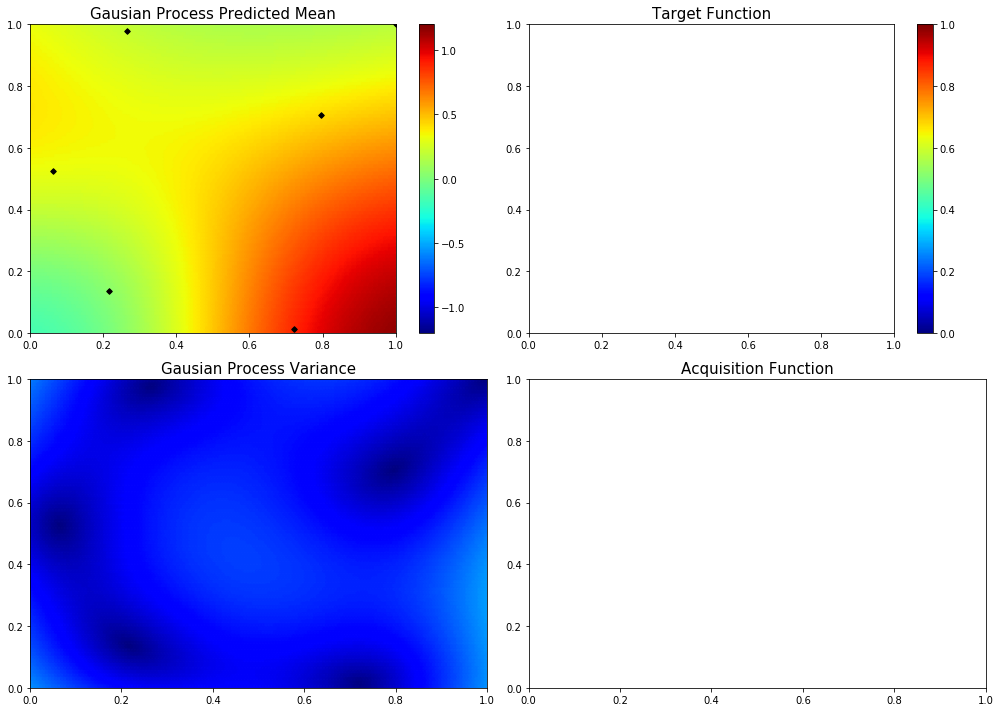

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 1.0]
99  Evaluations Remaining
|  7        |  1.113    |  0.0      |  1.0      |
myplot:  007


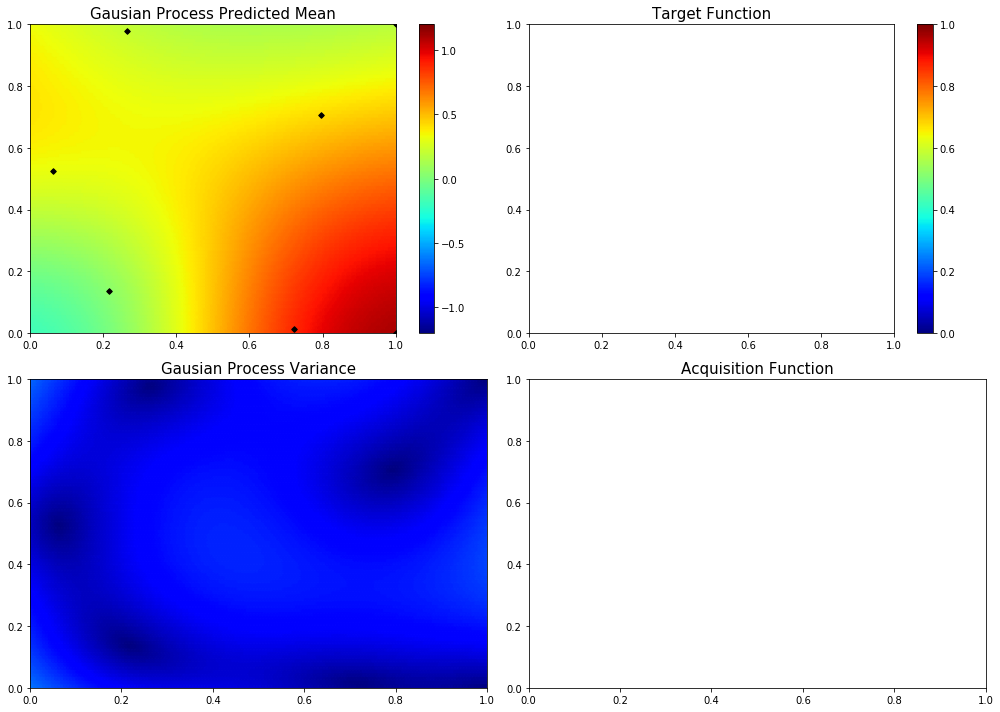

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3628013876017434, 1.0]
98  Evaluations Remaining
|  8        |  0.6485   |  0.3628   |  1.0      |
myplot:  008


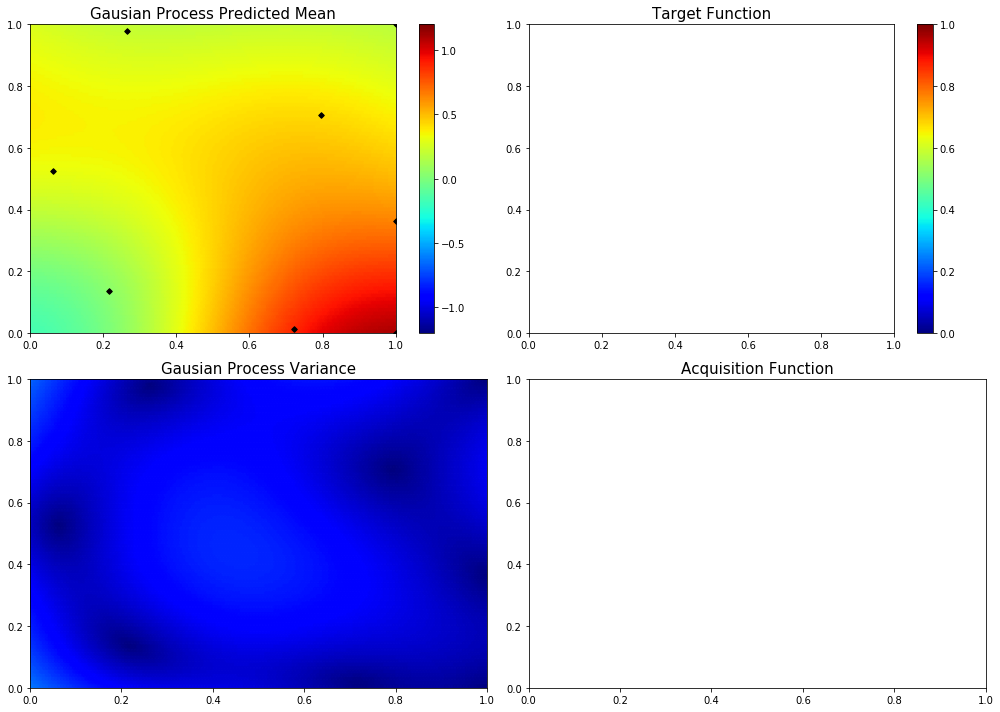

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.0]
97  Evaluations Remaining
|  9        |  1.053    |  1.0      |  0.0      |
myplot:  009


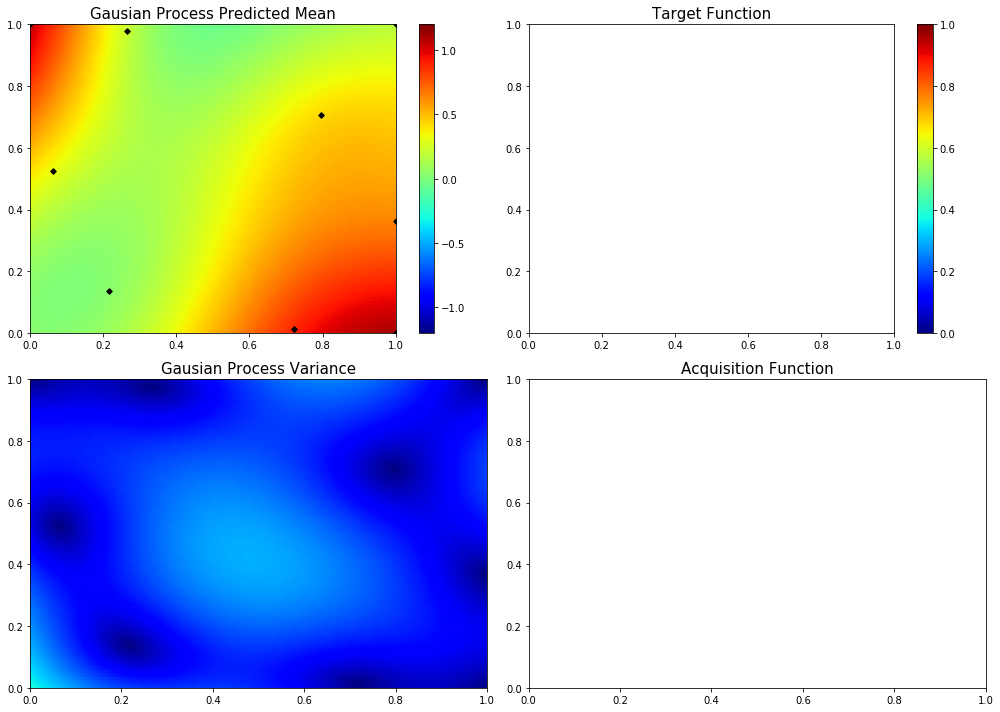

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.0]
96  Evaluations Remaining
|  10       |  0.03079  |  0.0      |  0.0      |
myplot:  010


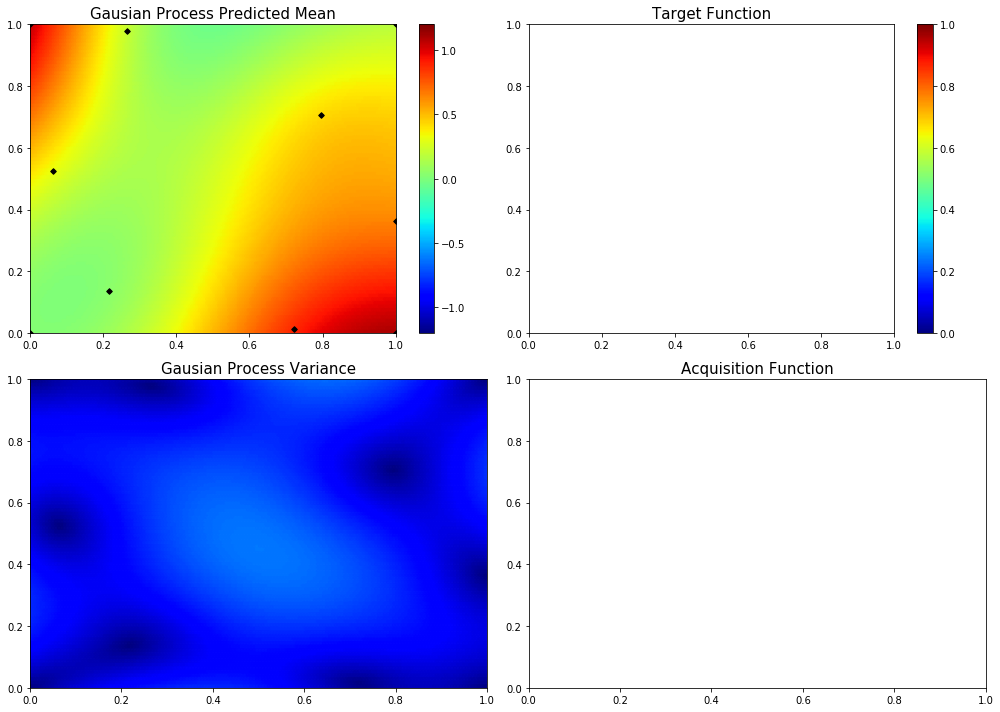

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.39679180406016956, 0.5753634459394127]
95  Evaluations Remaining
|  11       |  0.1182   |  0.3968   |  0.5754   |
myplot:  011


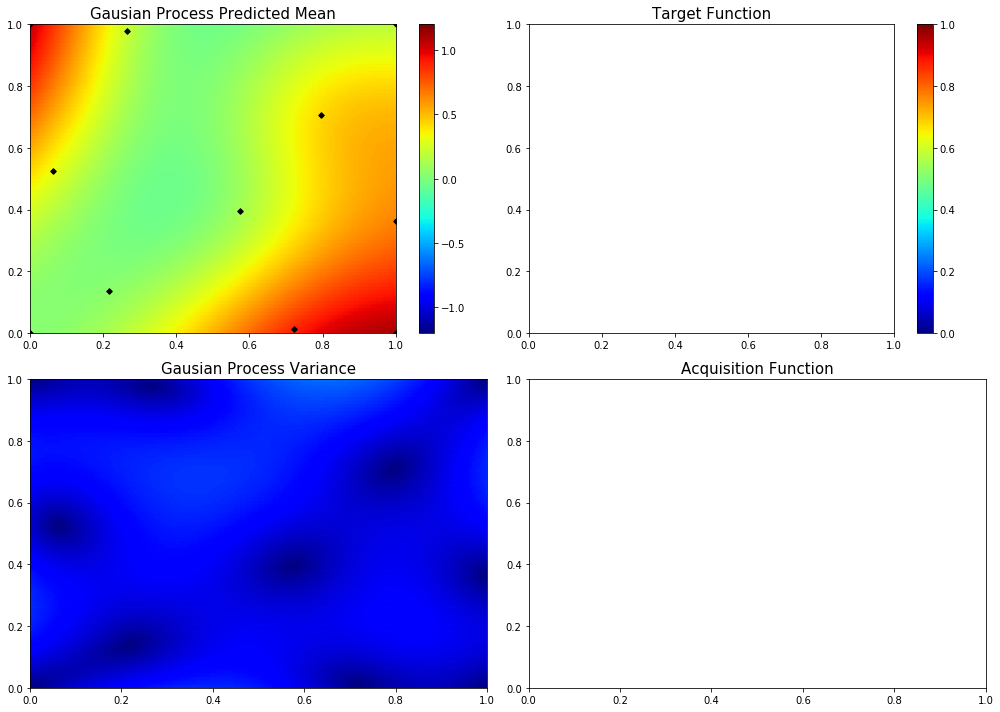

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.66603856853249]
94  Evaluations Remaining
|  12       | -0.06265  |  1.0      |  0.666    |
myplot:  012


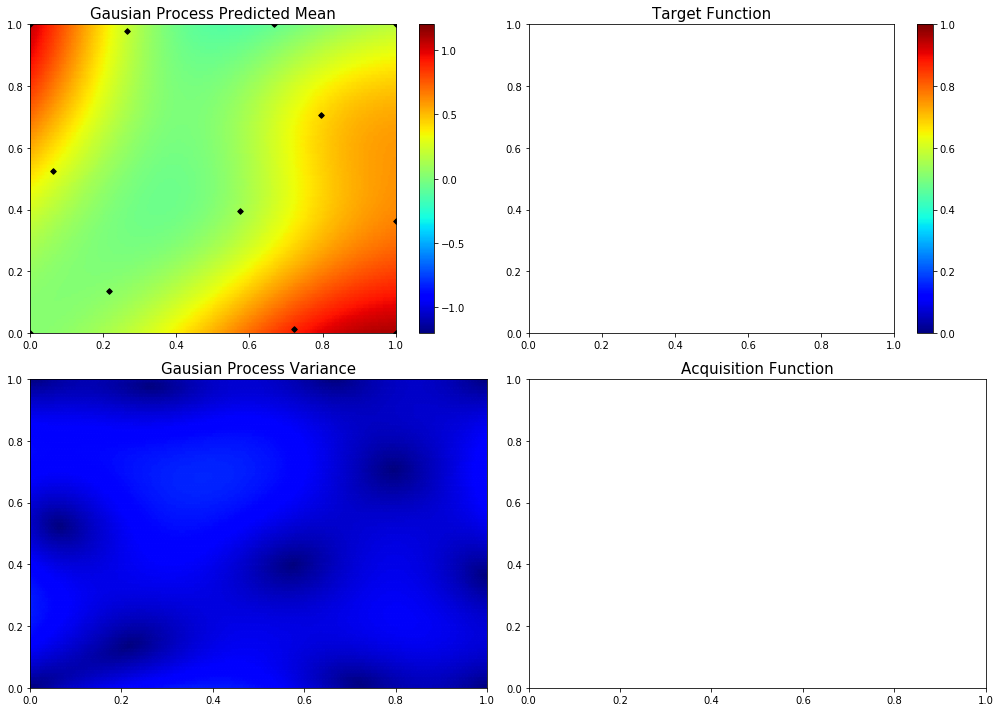

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7959505360621757, 0.0]
93  Evaluations Remaining
|  13       |  0.7331   |  0.796    |  0.0      |
myplot:  013


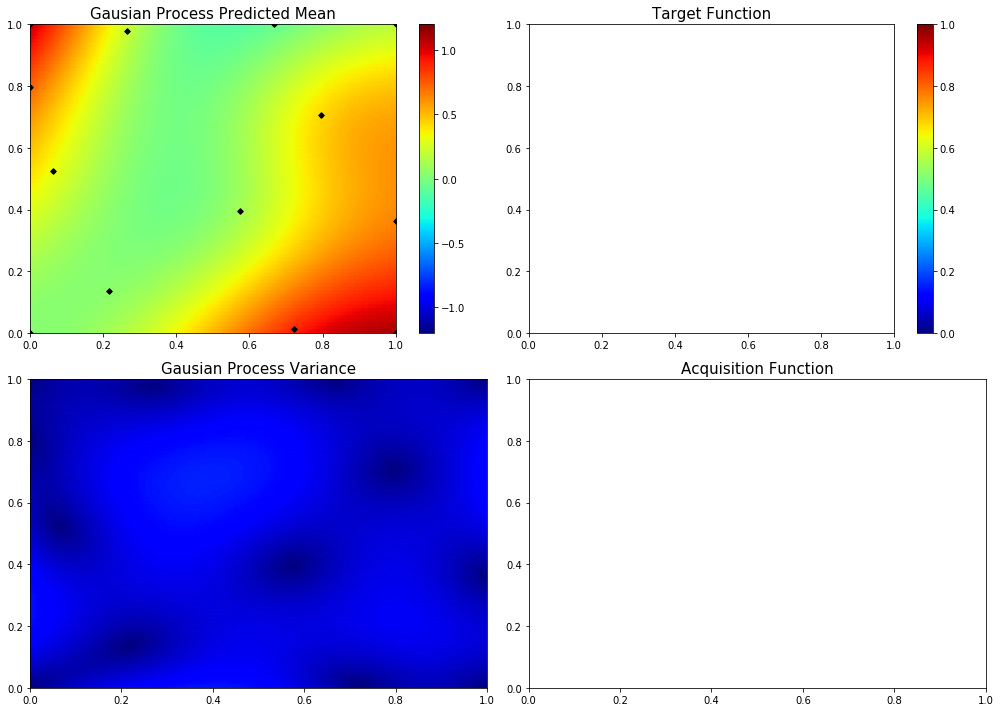

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.4552377410336608]
92  Evaluations Remaining
|  14       |  0.2466   |  0.0      |  0.4552   |
myplot:  014


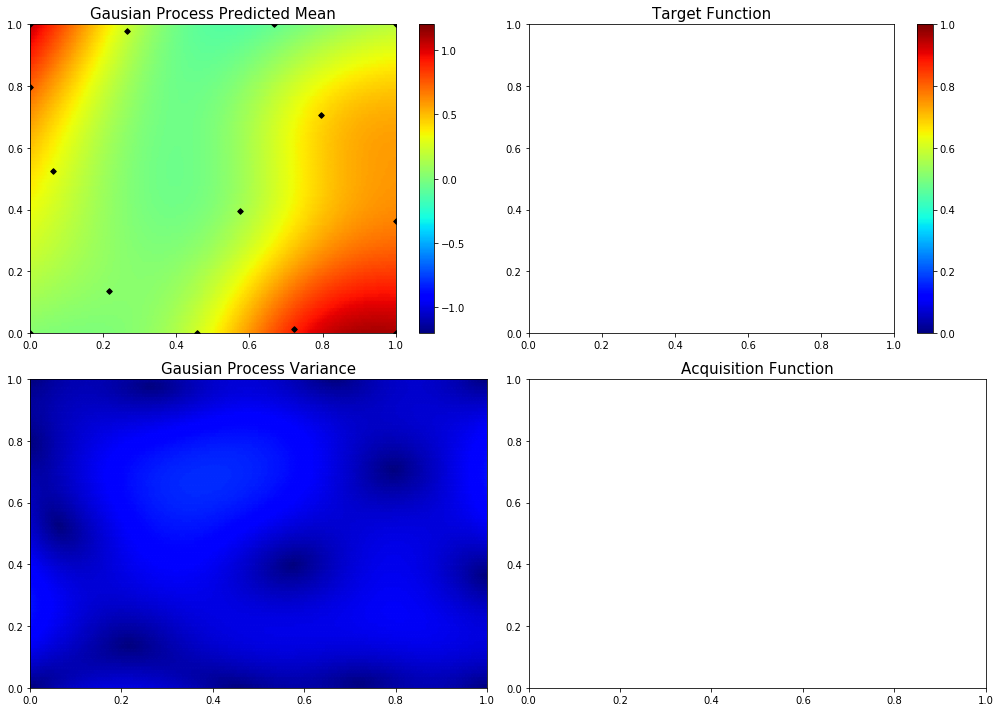

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6733994424307627, 1.0]
91  Evaluations Remaining
|  15       |  0.1362   |  0.6734   |  1.0      |
myplot:  015


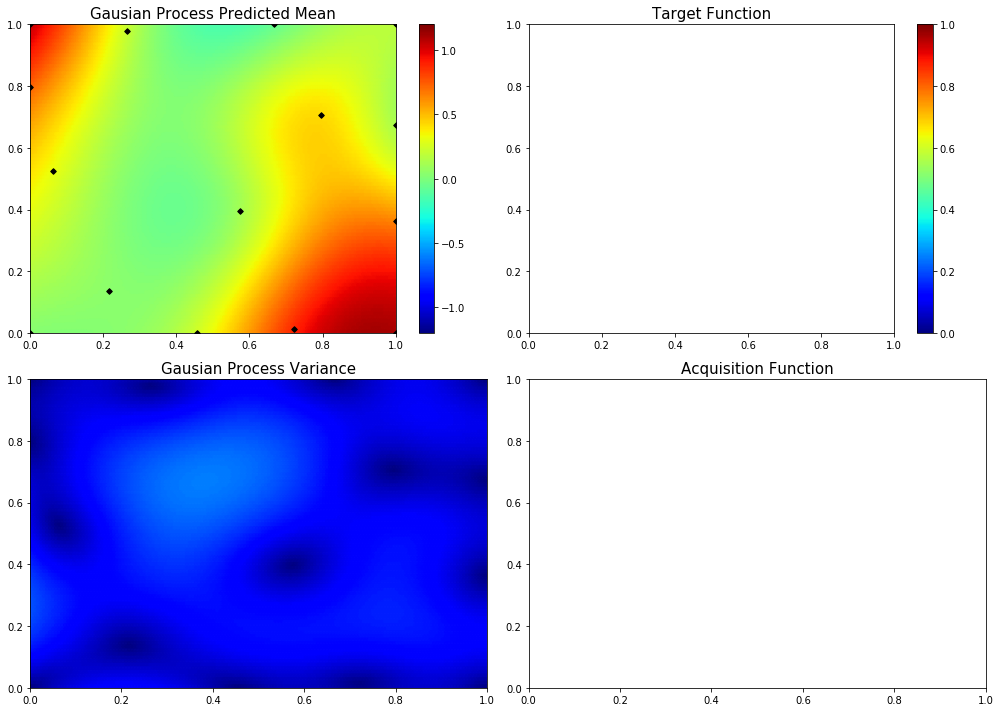

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6733004644570401, 0.382590296216793]
90  Evaluations Remaining
|  16       |  0.103    |  0.6733   |  0.3826   |
myplot:  016


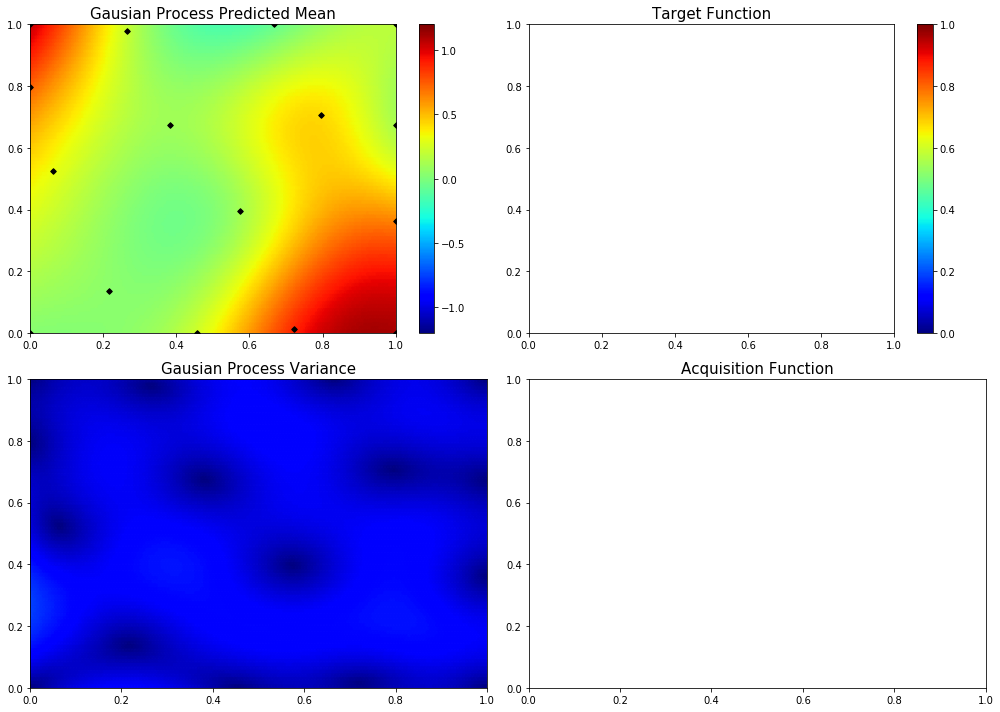

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.17267991125009047, 0.8669069483445004]
89  Evaluations Remaining
|  17       |  0.4399   |  0.1727   |  0.8669   |
myplot:  017


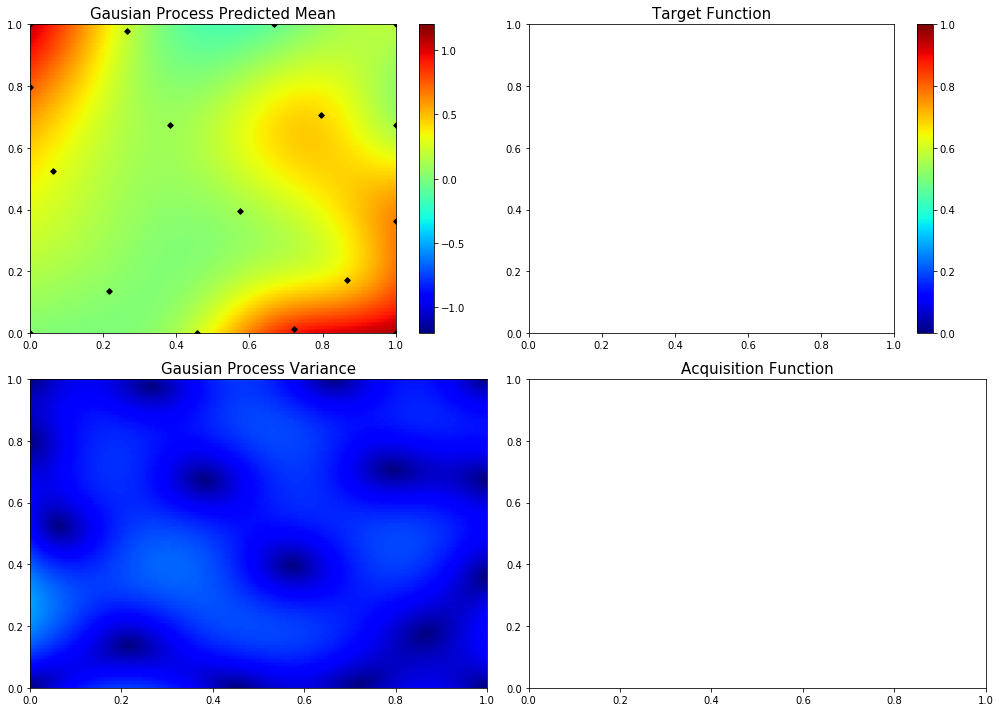

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2763410026214647, 0.0]
88  Evaluations Remaining
|  18       |  0.0615   |  0.2763   |  0.0      |
myplot:  018


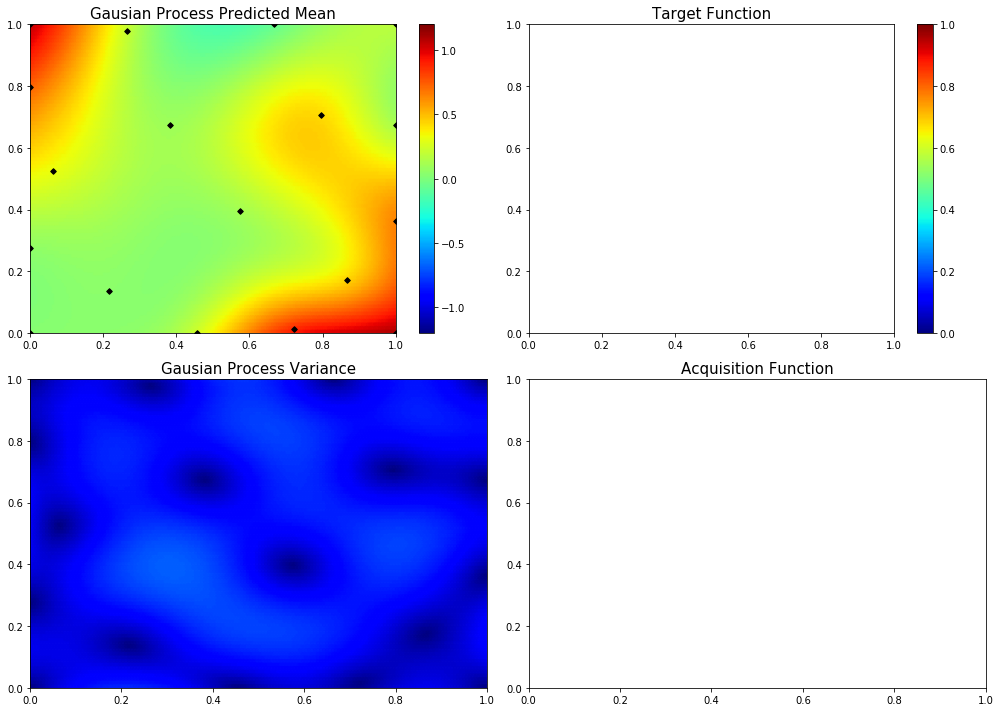

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4740689538795288, 0.8185973366057042]
87  Evaluations Remaining
|  19       |  0.1267   |  0.4741   |  0.8186   |
myplot:  019


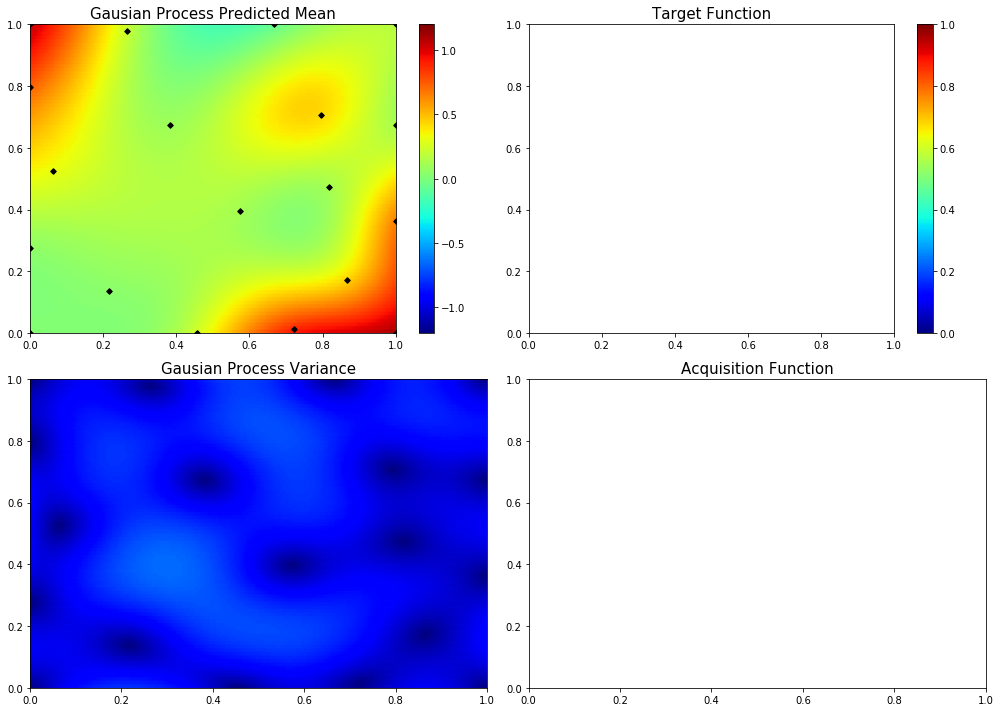

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3987659876251516, 0.297750746482043]
86  Evaluations Remaining
|  20       | -0.04997  |  0.3988   |  0.2978   |
myplot:  020


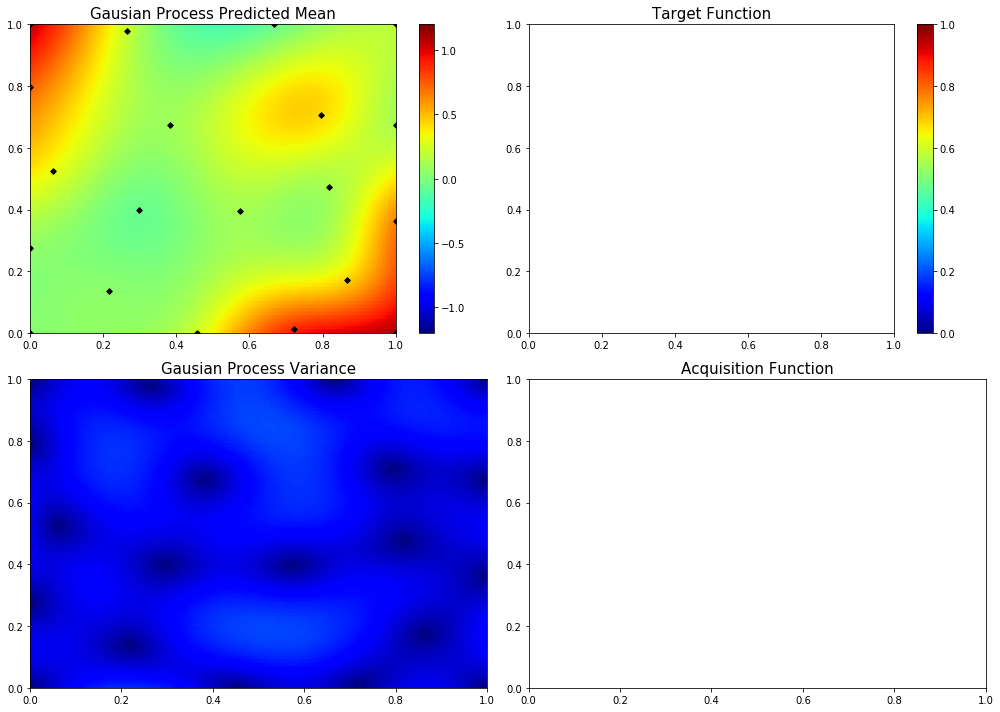

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.16249475819669368, 0.5751631426794437]
85  Evaluations Remaining
|  21       |  0.195    |  0.1625   |  0.5752   |
myplot:  021


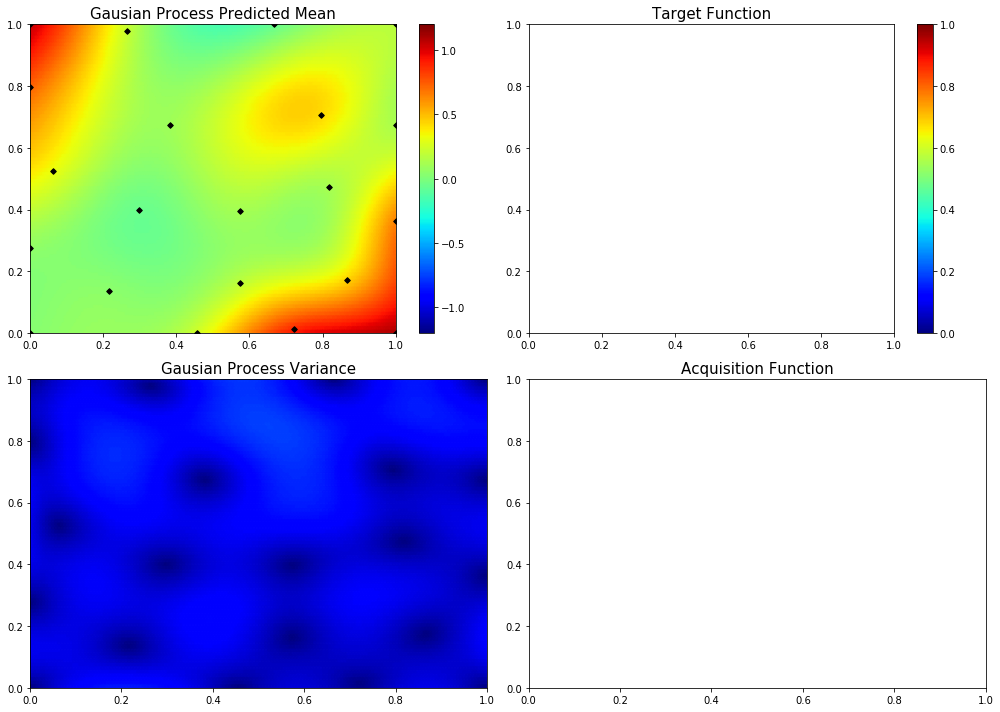

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7774407398053742, 0.5814760413804043]
84  Evaluations Remaining
|  22       |  0.0521   |  0.7774   |  0.5815   |
myplot:  022


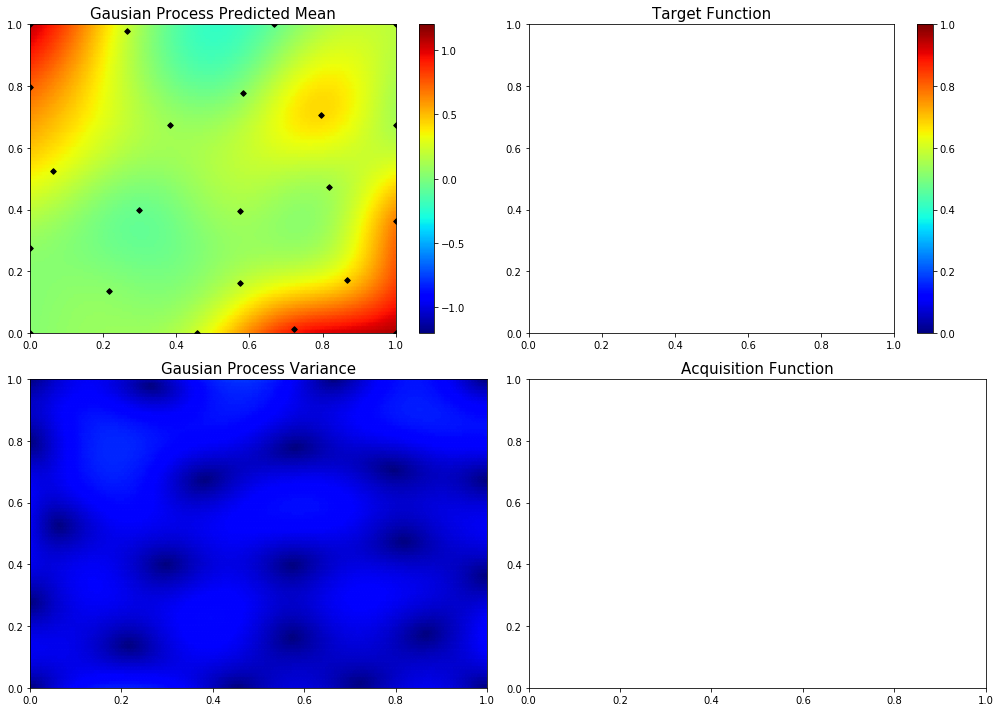

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7932884530903305, 0.16045457672898]
83  Evaluations Remaining
|  23       |  0.3891   |  0.7933   |  0.1605   |
myplot:  023


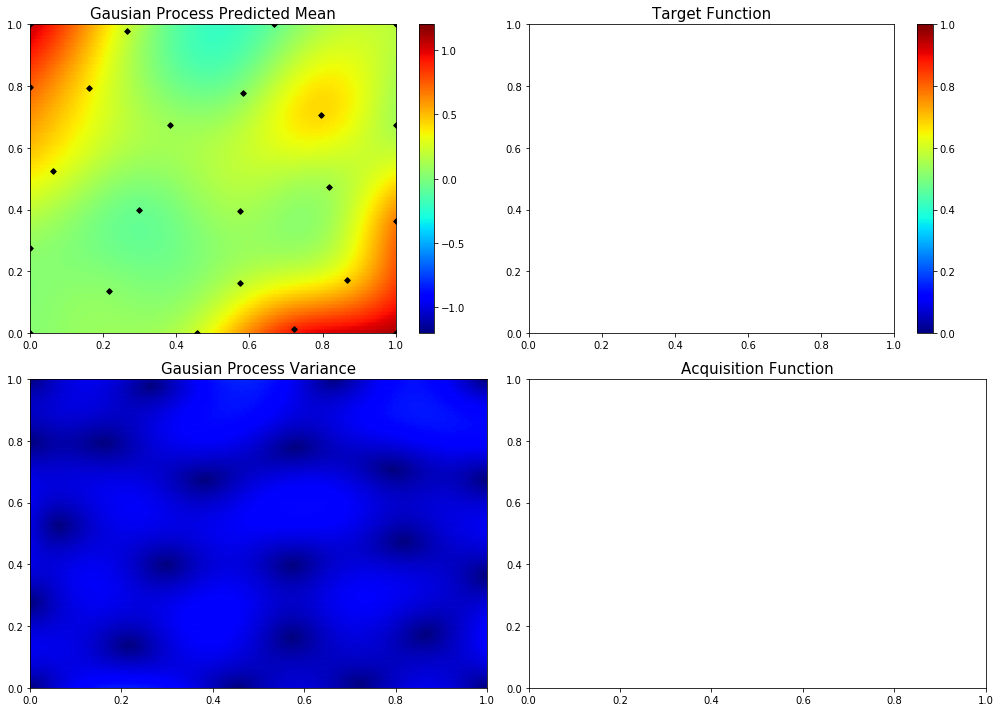

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1487319803032771, 1.0]
82  Evaluations Remaining
|  24       |  0.7611   |  0.1487   |  1.0      |
myplot:  024


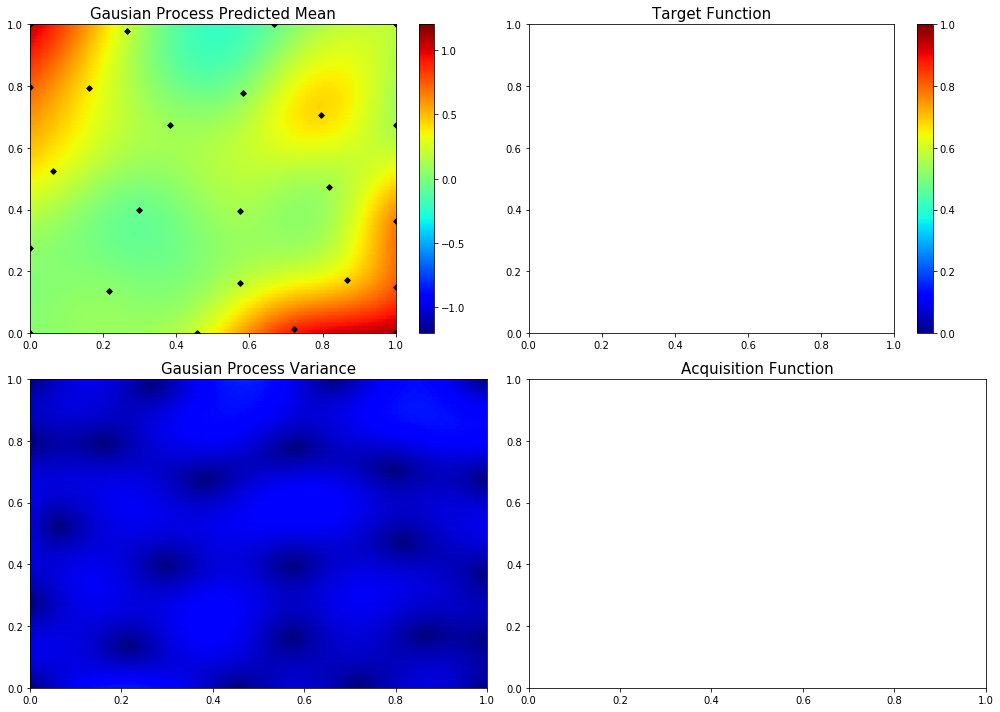

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8738261978766781]
81  Evaluations Remaining
|  25       |  0.9437   |  0.0      |  0.8738   |
myplot:  025


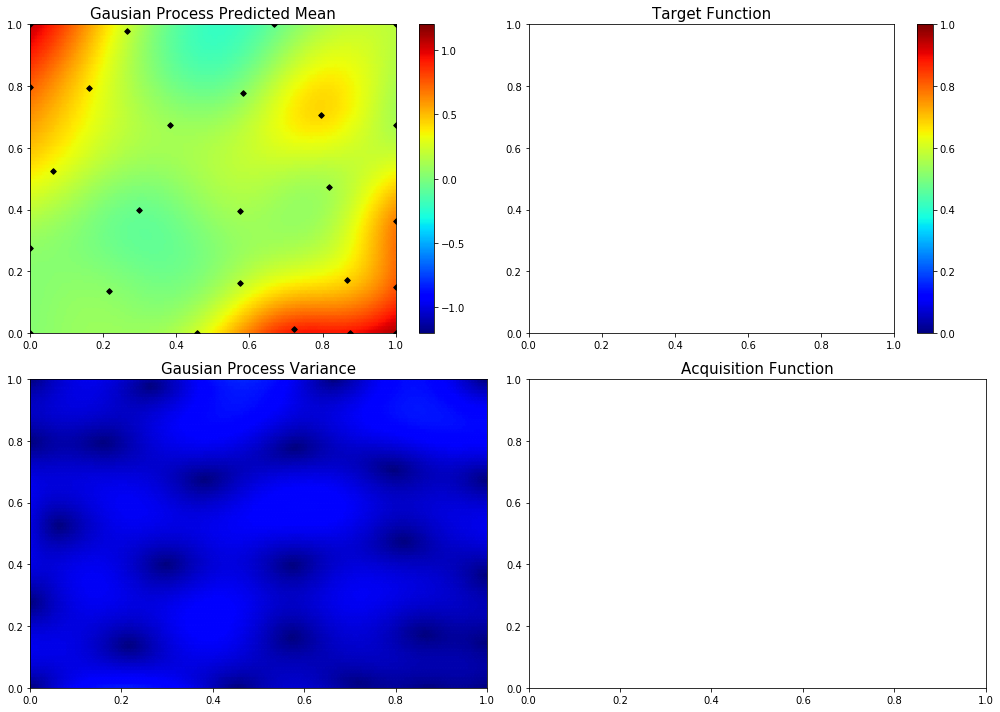

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8856162916419534, 0.858006807820586]
80  Evaluations Remaining
|  26       | -0.4901   |  0.8856   |  0.858    |
myplot:  026


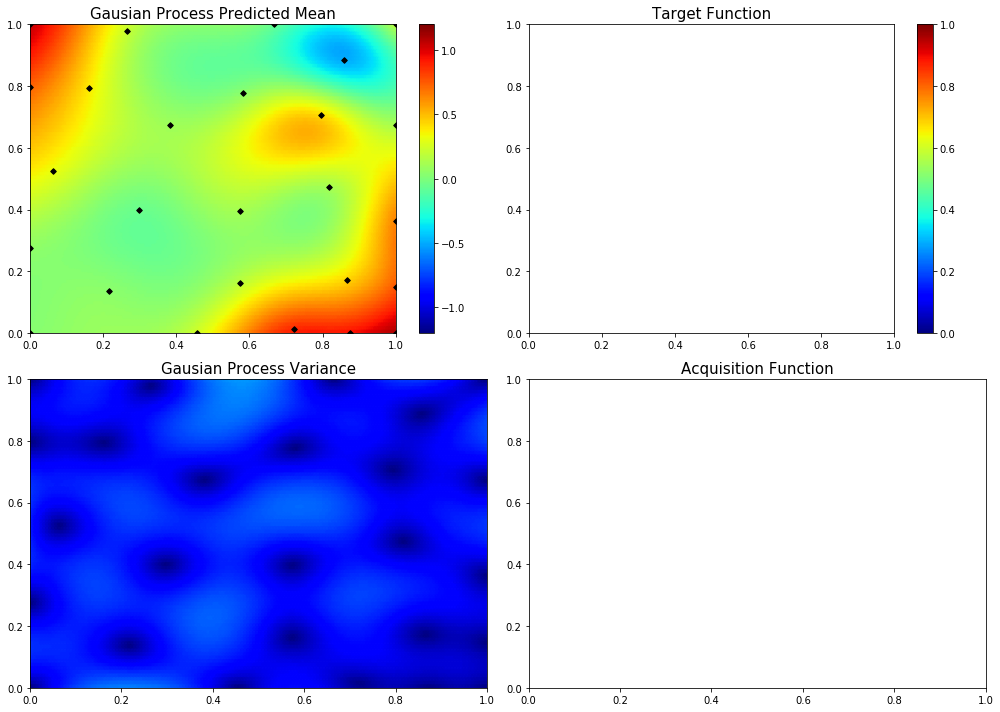

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.4627177491800858]
79  Evaluations Remaining
|  27       |  0.6259   |  1.0      |  0.4627   |
myplot:  027


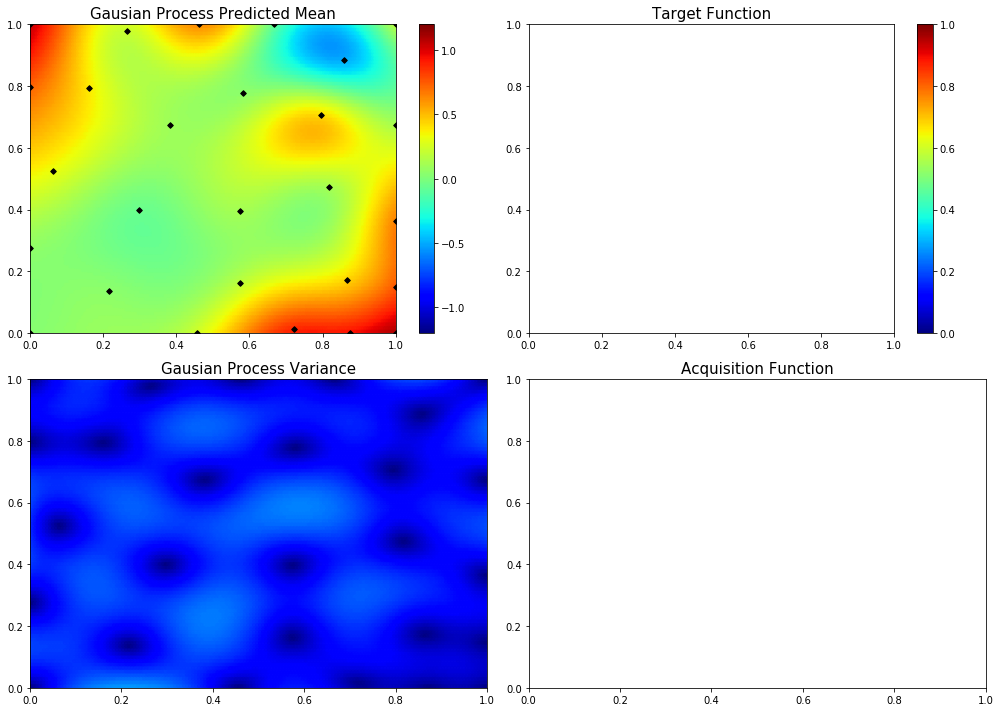

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.217125781310647]
78  Evaluations Remaining
|  28       |  0.3691   |  0.0      |  0.2171   |
myplot:  028


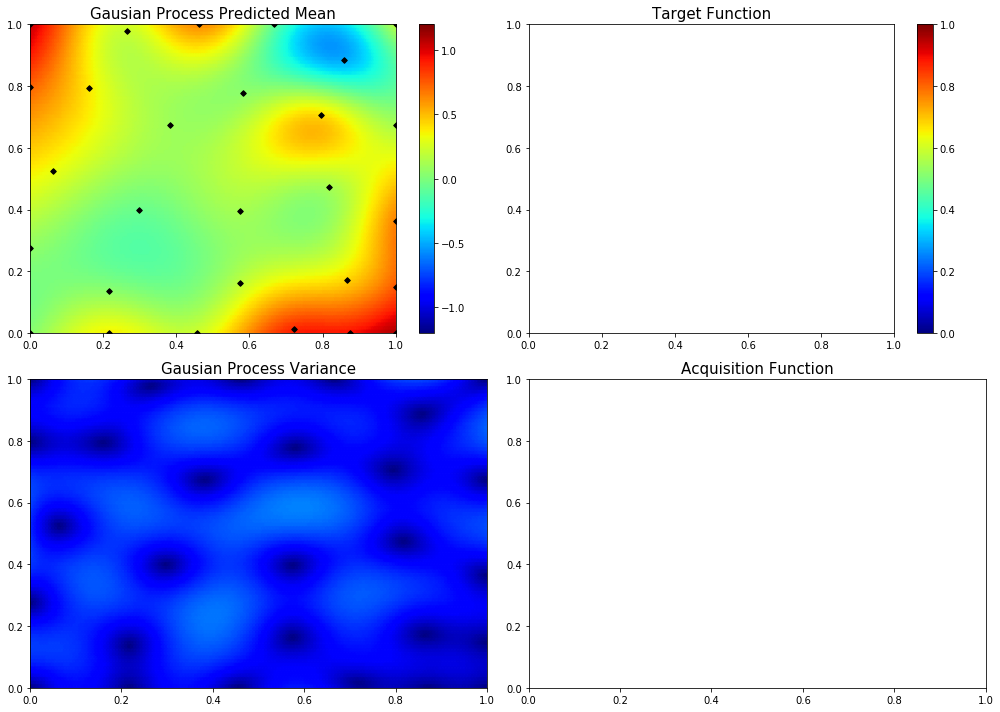

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5877988378749417, 0.6140430740240984]
77  Evaluations Remaining
|  29       |  0.02253  |  0.5878   |  0.614    |
myplot:  029


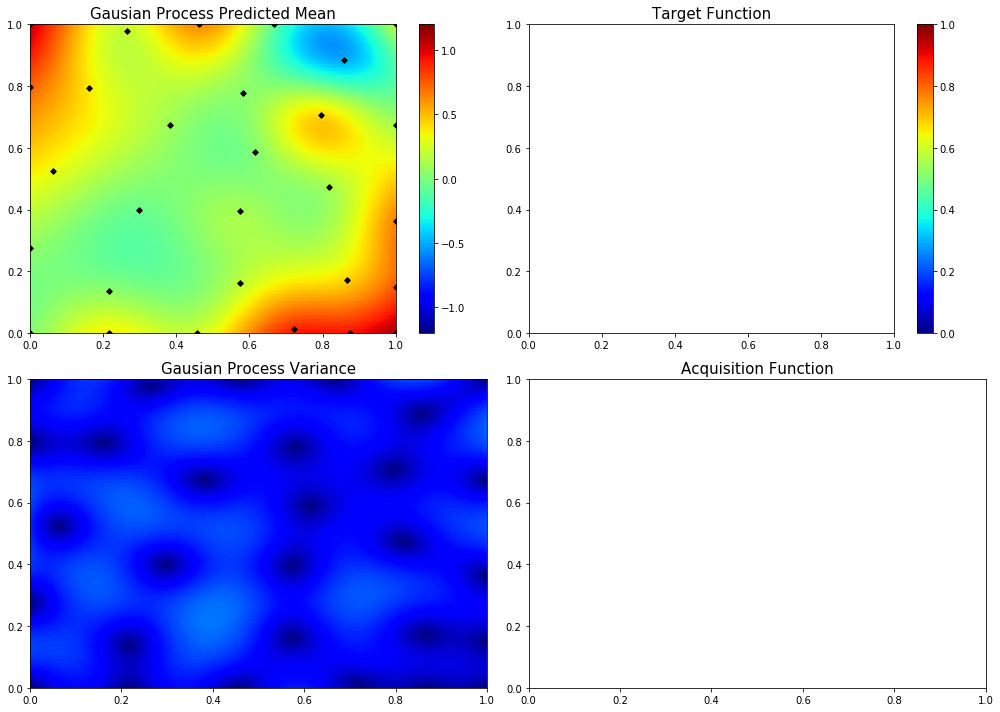

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6426586823557667, 0.0]
76  Evaluations Remaining
|  30       |  0.44     |  0.6427   |  0.0      |
myplot:  030


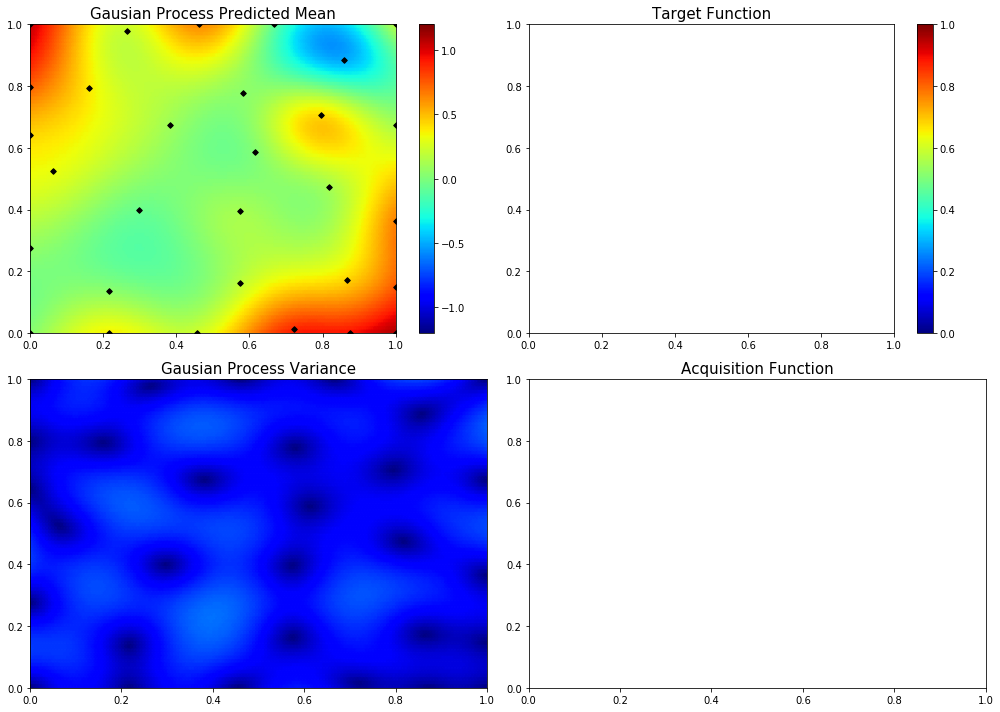

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8562607267348509, 0.38498279527366713]
75  Evaluations Remaining
|  31       |  0.3421   |  0.8563   |  0.385    |
myplot:  031


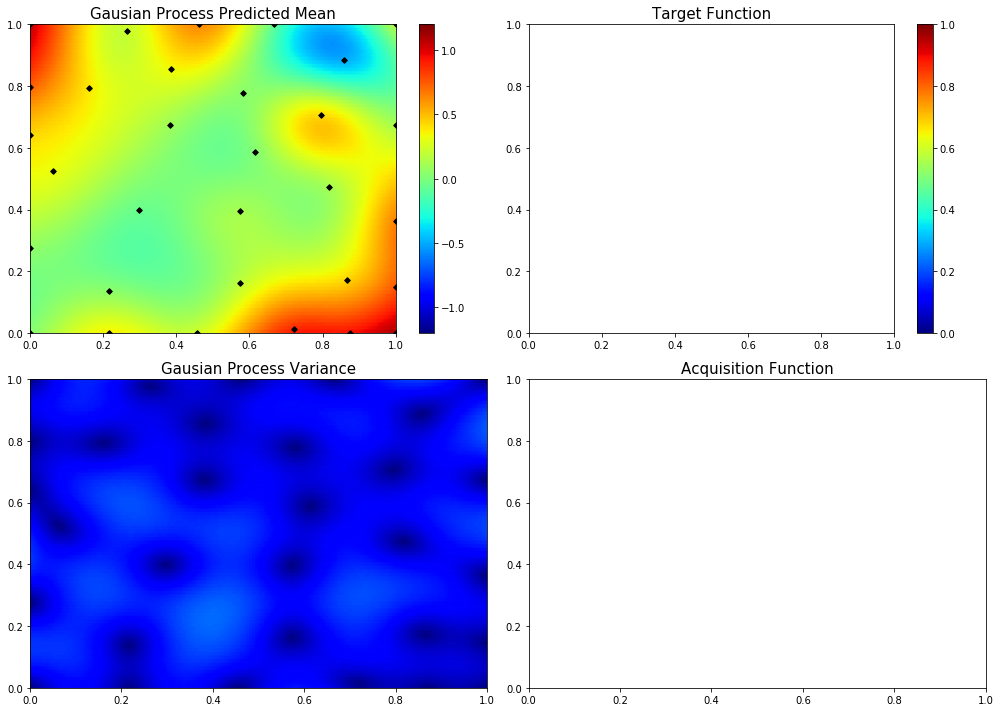

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5139854024658626, 1.0]
74  Evaluations Remaining
|  32       |  0.265    |  0.514    |  1.0      |
myplot:  032


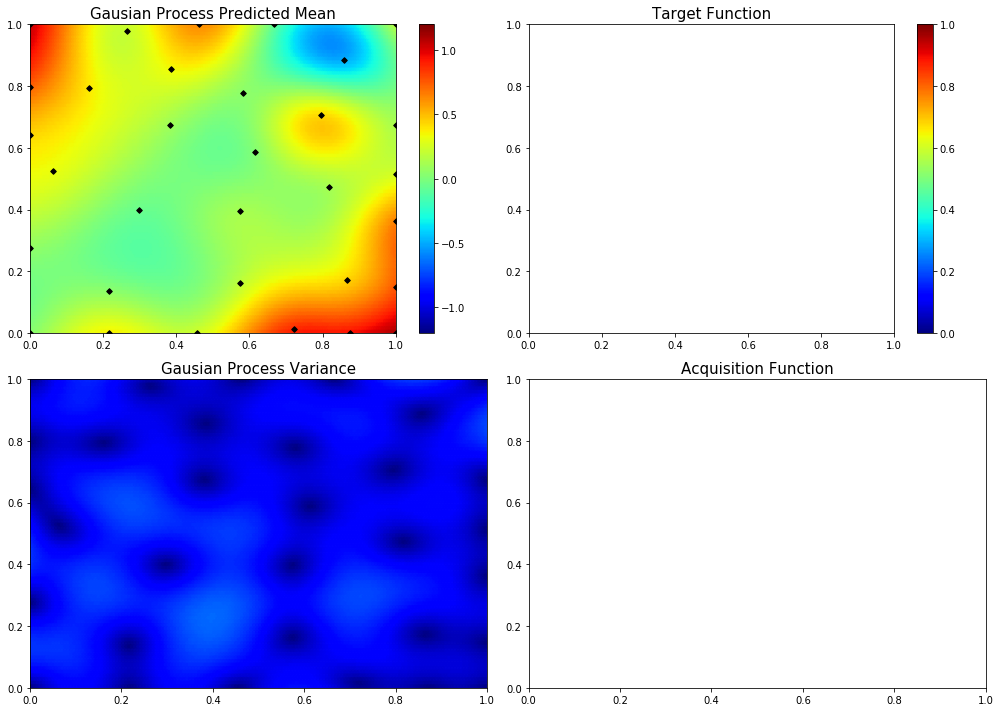

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6057699971220508, 0.20467492299351467]
73  Evaluations Remaining
|  33       |  0.5644   |  0.6058   |  0.2047   |
myplot:  033


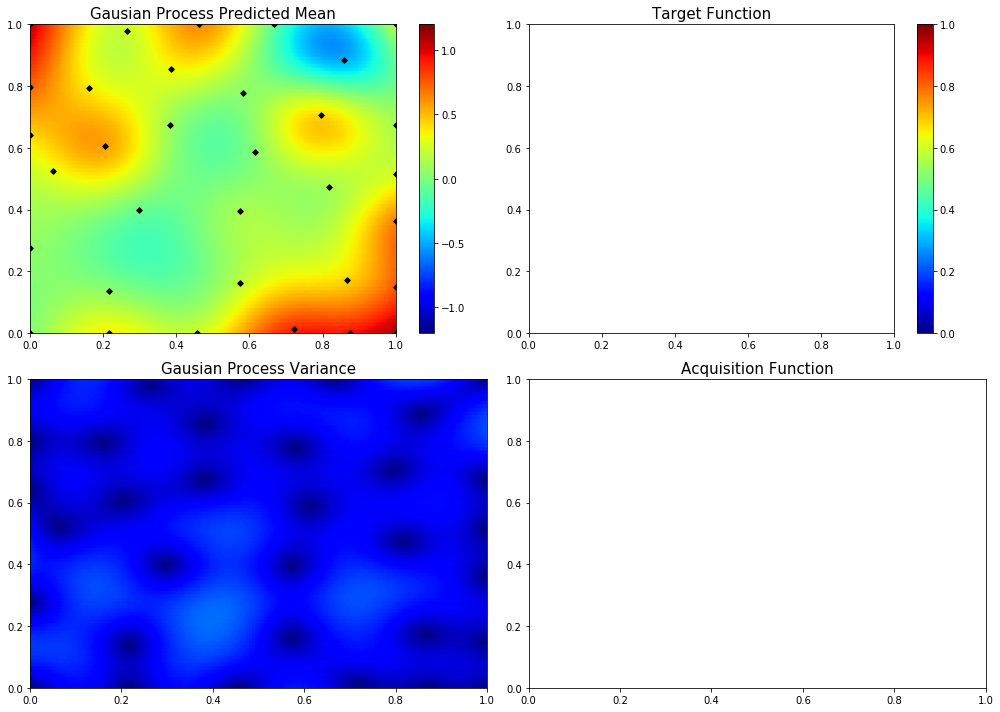

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.22185826968477573, 0.4048046496290848]
72  Evaluations Remaining
|  34       |  0.1446   |  0.2219   |  0.4048   |
myplot:  034


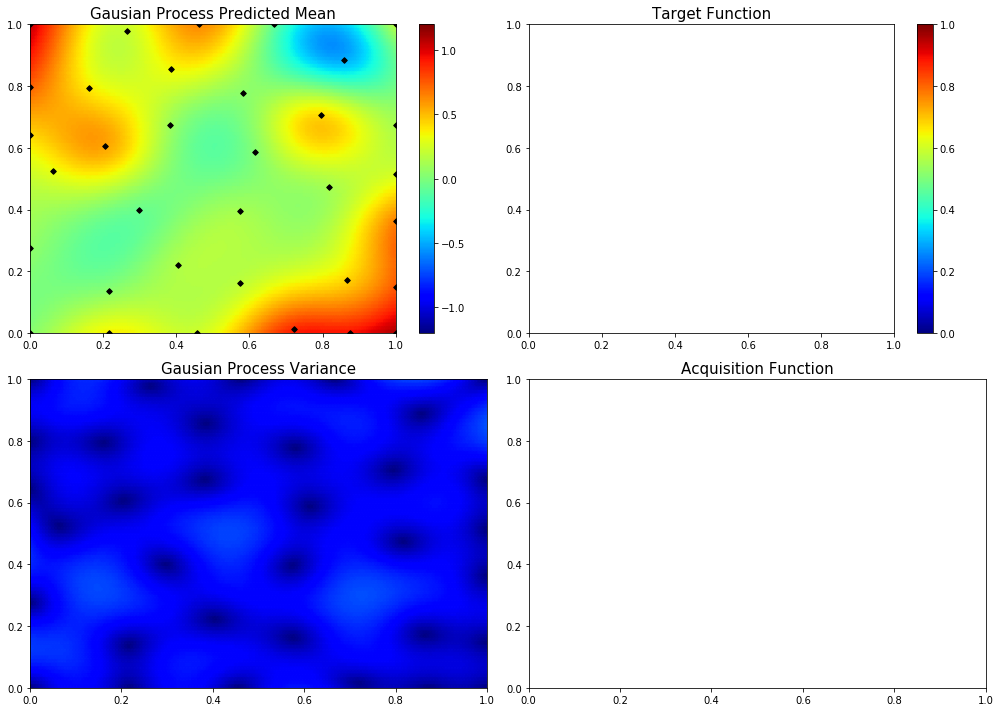

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.10447878463126743]
71  Evaluations Remaining
|  35       |  0.2945   |  1.0      |  0.1045   |
myplot:  035


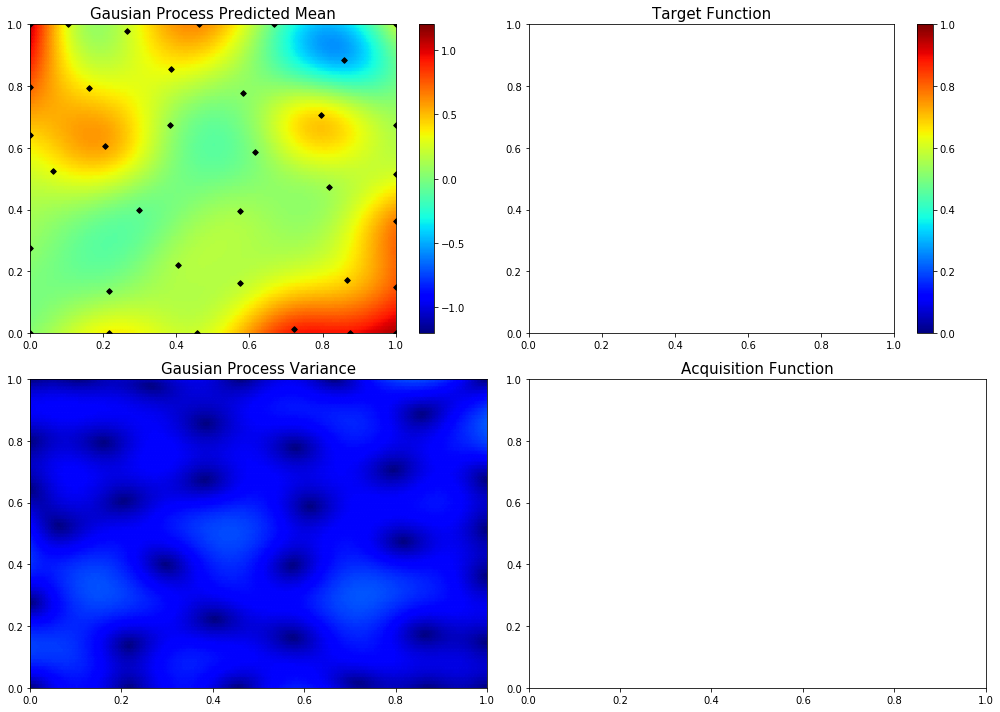

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.29107112449987493, 0.7281914437154424]
70  Evaluations Remaining
|  36       | -0.6217   |  0.2911   |  0.7282   |
myplot:  036


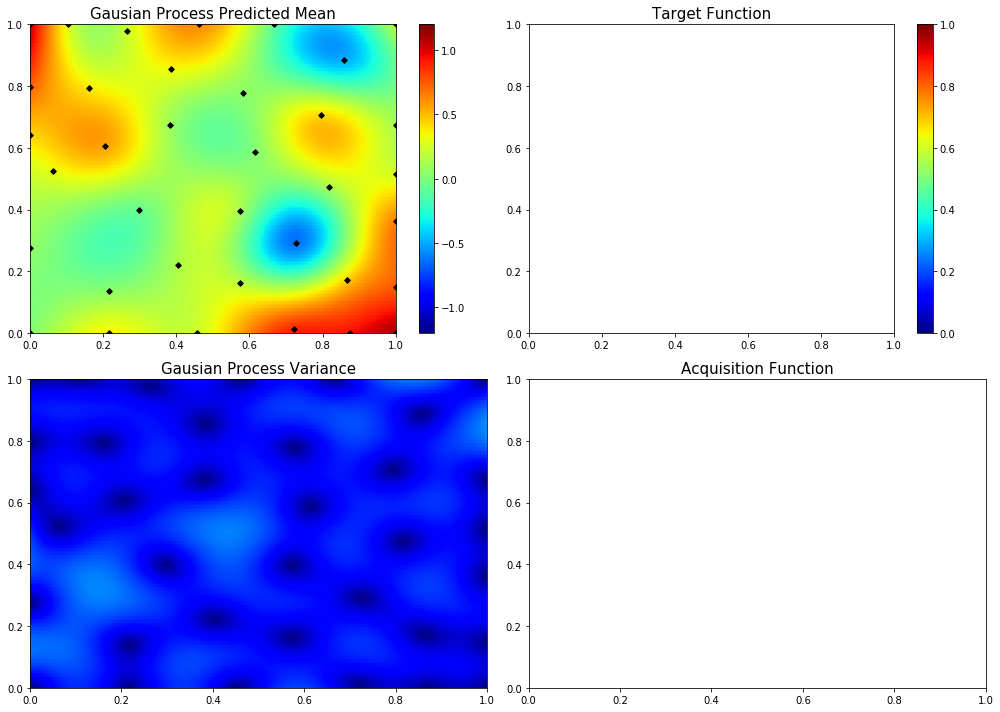

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4956034281422607, 0.43410548492392304]
69  Evaluations Remaining
|  37       |  0.02482  |  0.4956   |  0.4341   |
myplot:  037


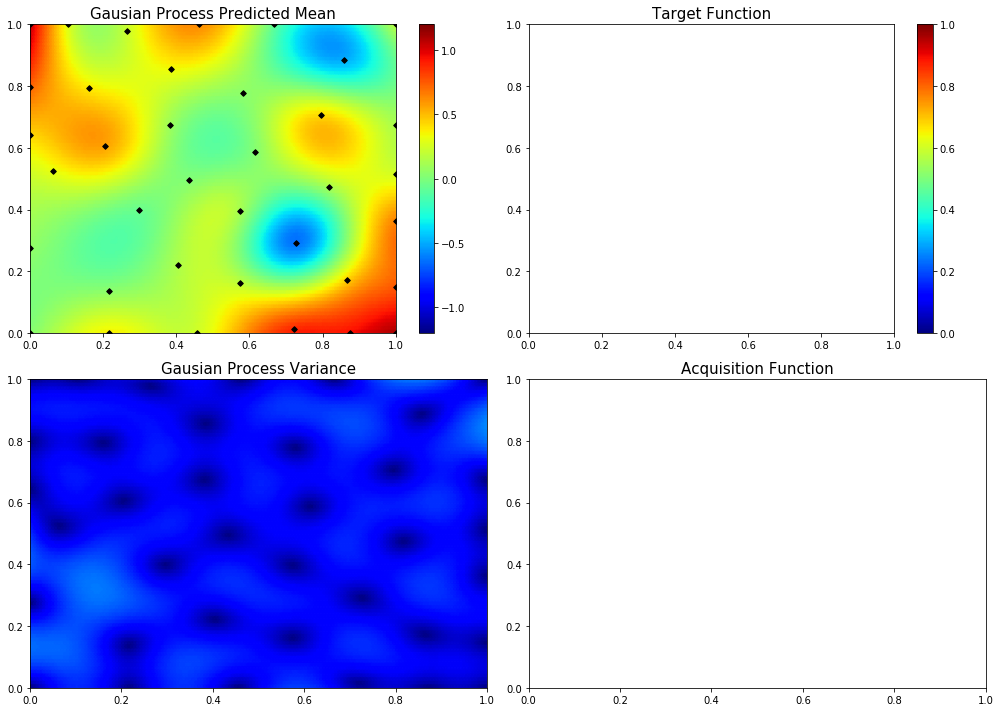

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8433849755641232, 1.0]
68  Evaluations Remaining
|  38       |  0.0902   |  0.8434   |  1.0      |
myplot:  038


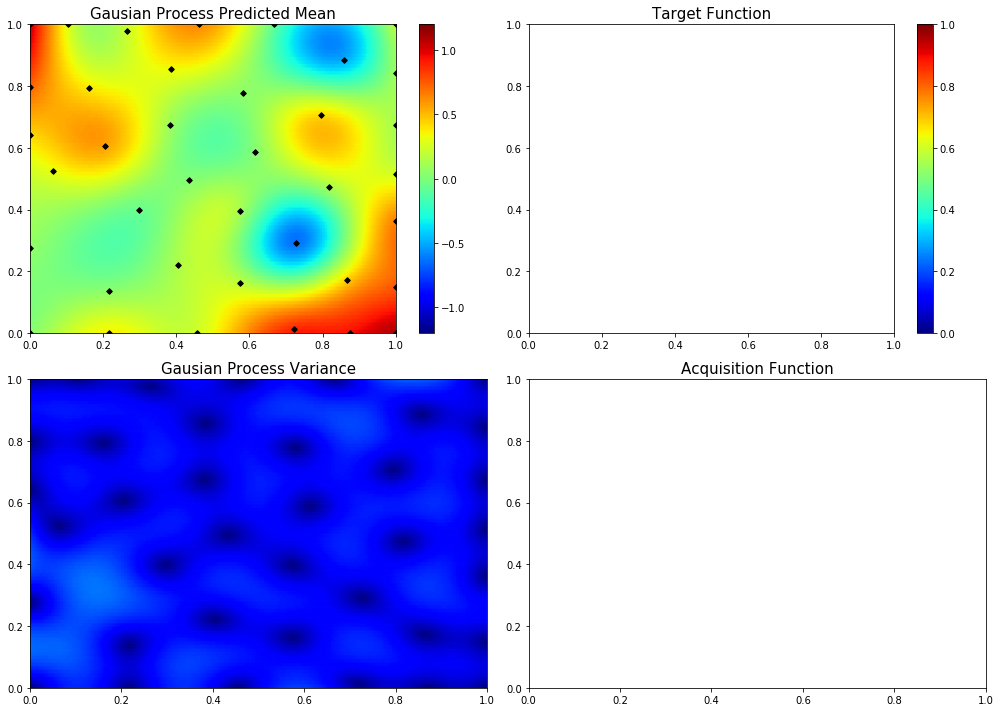

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.5992270351145569]
67  Evaluations Remaining
|  39       |  0.4399   |  0.0      |  0.5992   |
myplot:  039


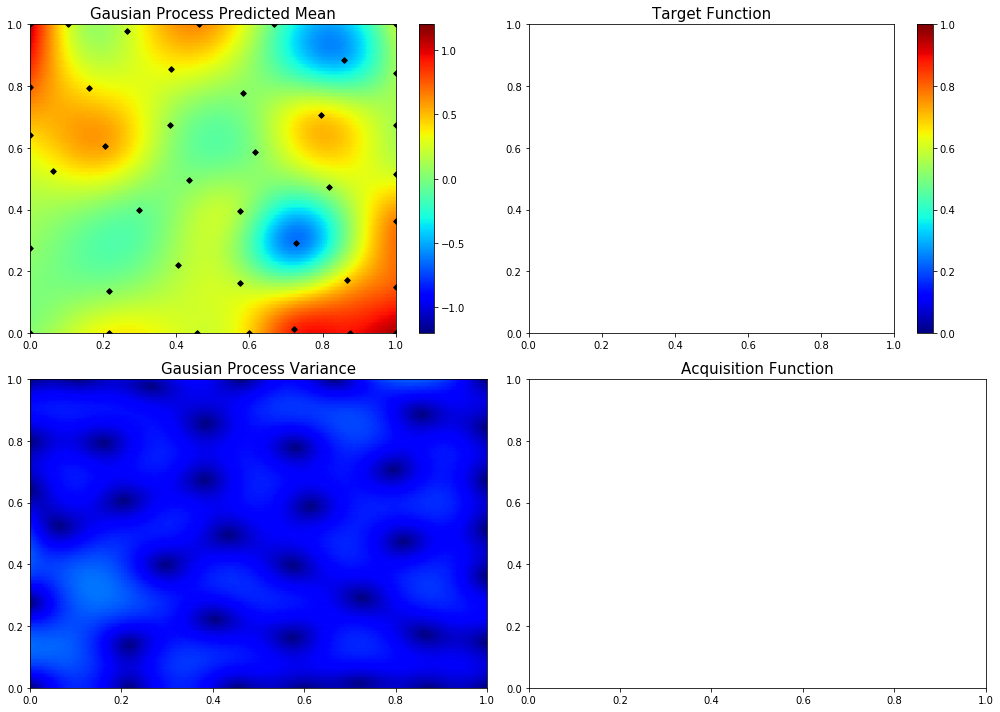

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3364040990896521, 0.13606776212913962]
66  Evaluations Remaining
|  40       | -1.068    |  0.3364   |  0.1361   |
myplot:  040


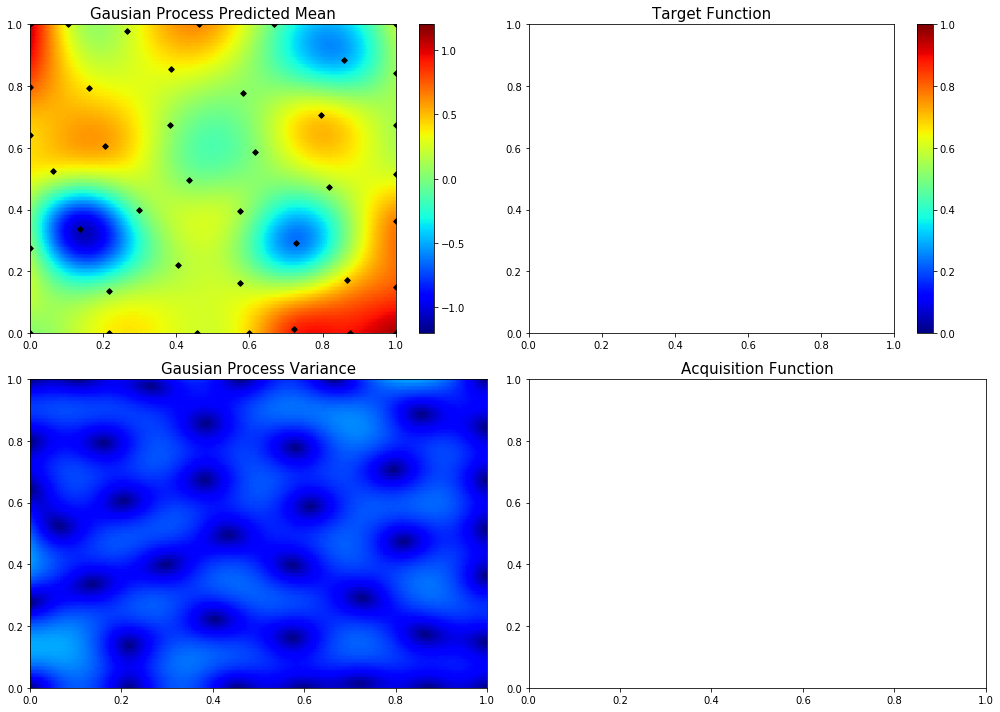

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.1351981355887366, 0.0]
65  Evaluations Remaining
|  41       |  0.02812  |  0.1352   |  0.0      |
myplot:  041


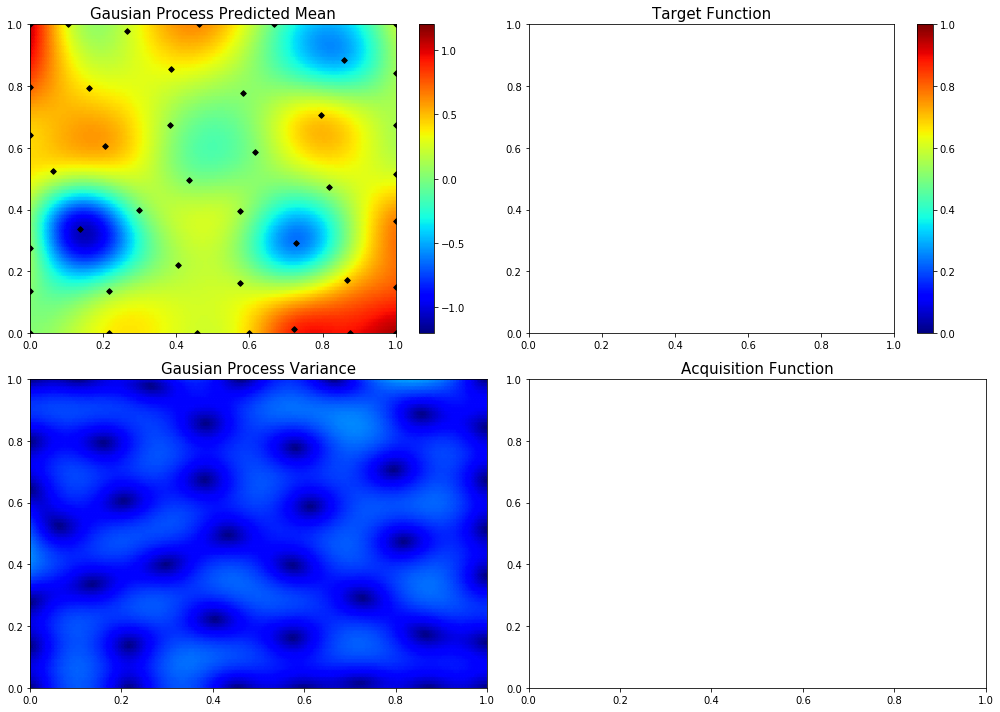

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9085092899879741, 0.0]
64  Evaluations Remaining
|  42       |  0.8181   |  0.9085   |  0.0      |
myplot:  042


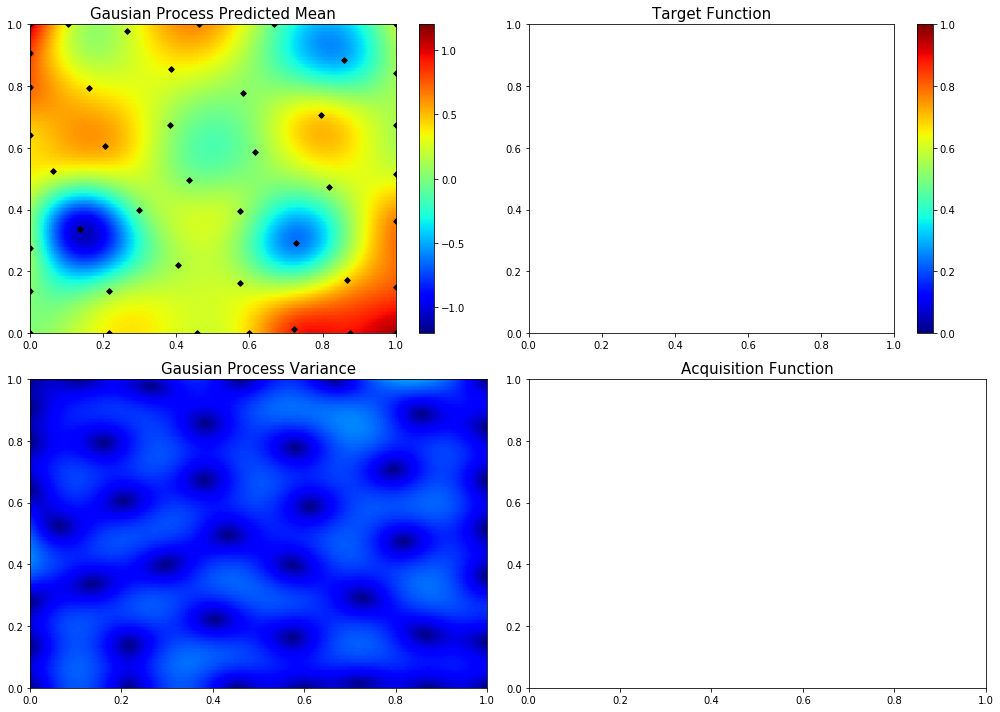

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4374082814795035, 0.0]
63  Evaluations Remaining
|  43       |  0.2035   |  0.4374   |  0.0      |
myplot:  043


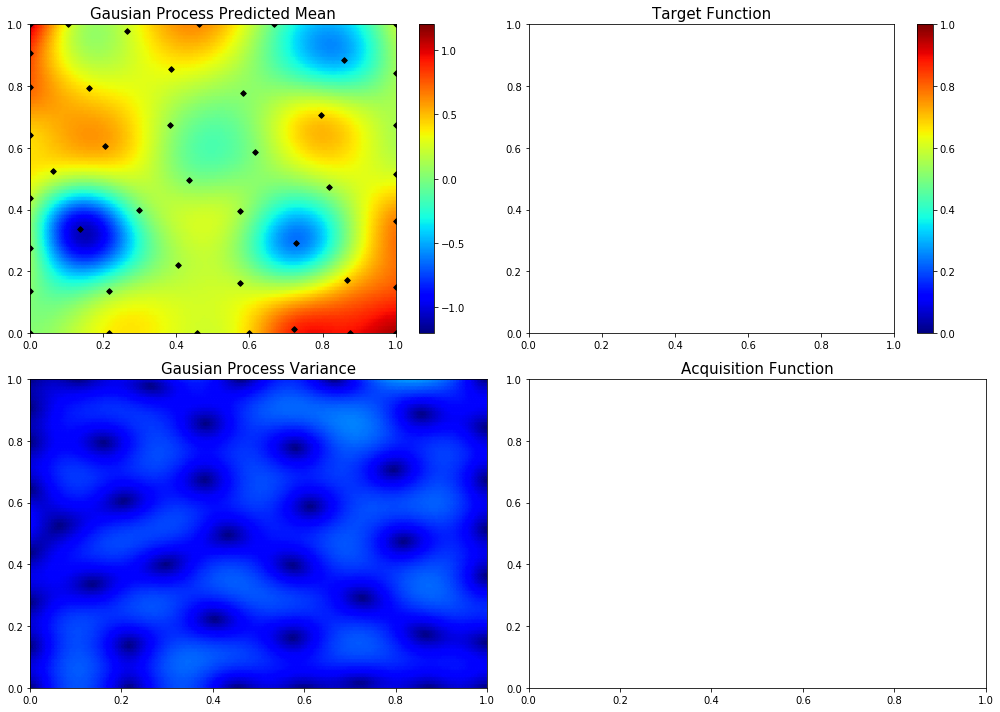

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.07561244889992412, 0.34070284709026505]
62  Evaluations Remaining
|  44       |  0.09417  |  0.07561  |  0.3407   |
myplot:  044


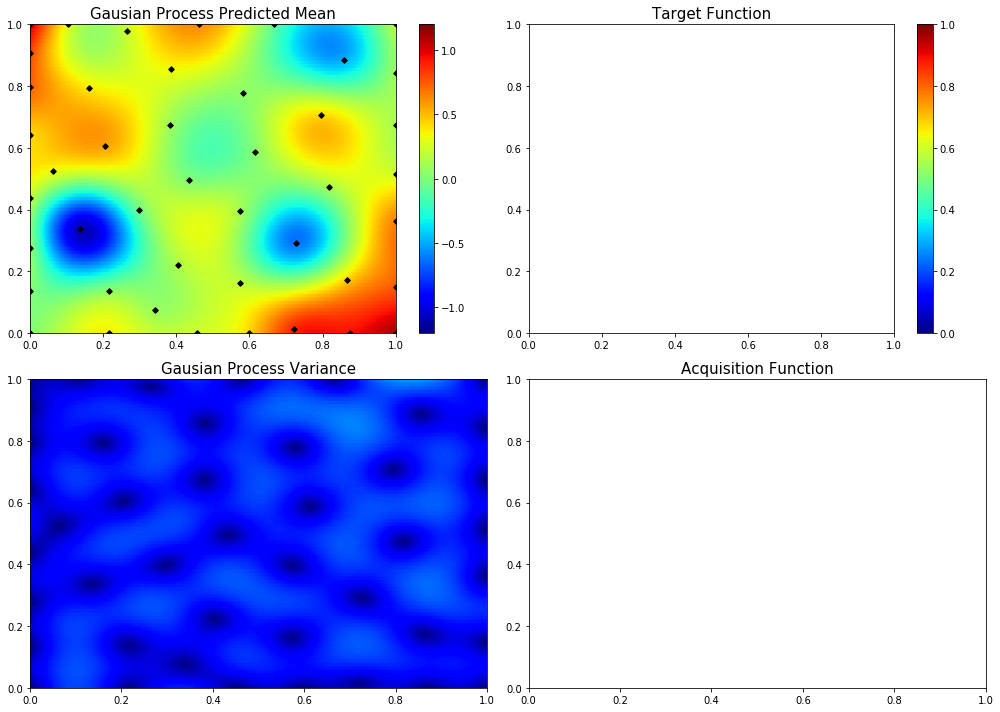

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6029564618578899, 0.8736185260261048]
61  Evaluations Remaining
|  45       |  0.2099   |  0.603    |  0.8736   |
myplot:  045


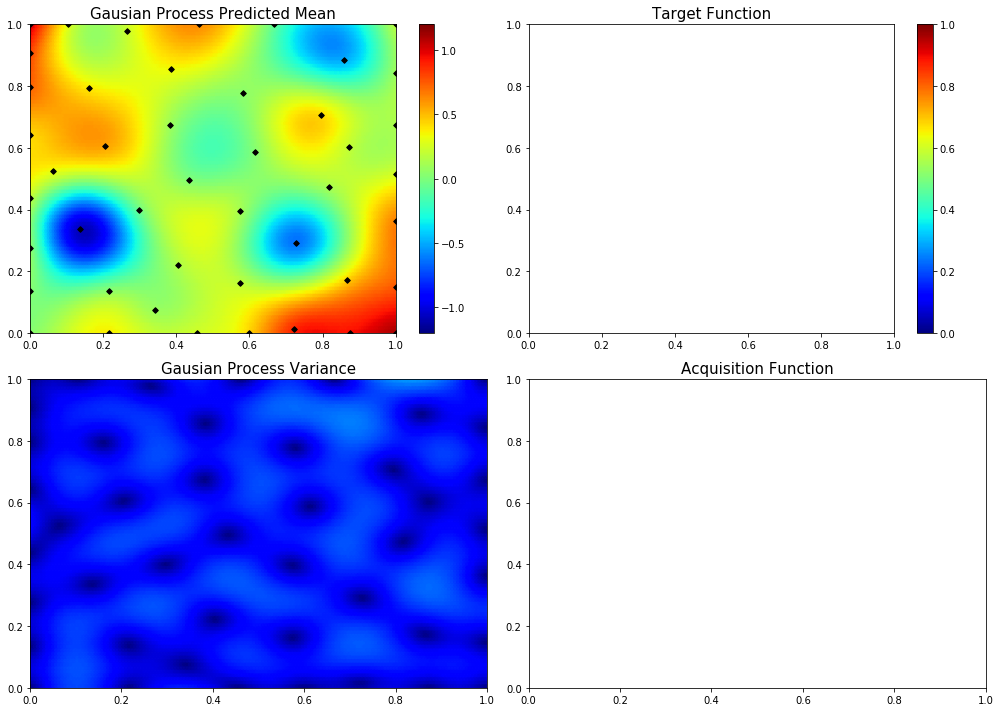

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.915214876873523, 0.549997384913041]
60  Evaluations Remaining
|  46       |  0.513    |  0.9152   |  0.55     |
myplot:  046


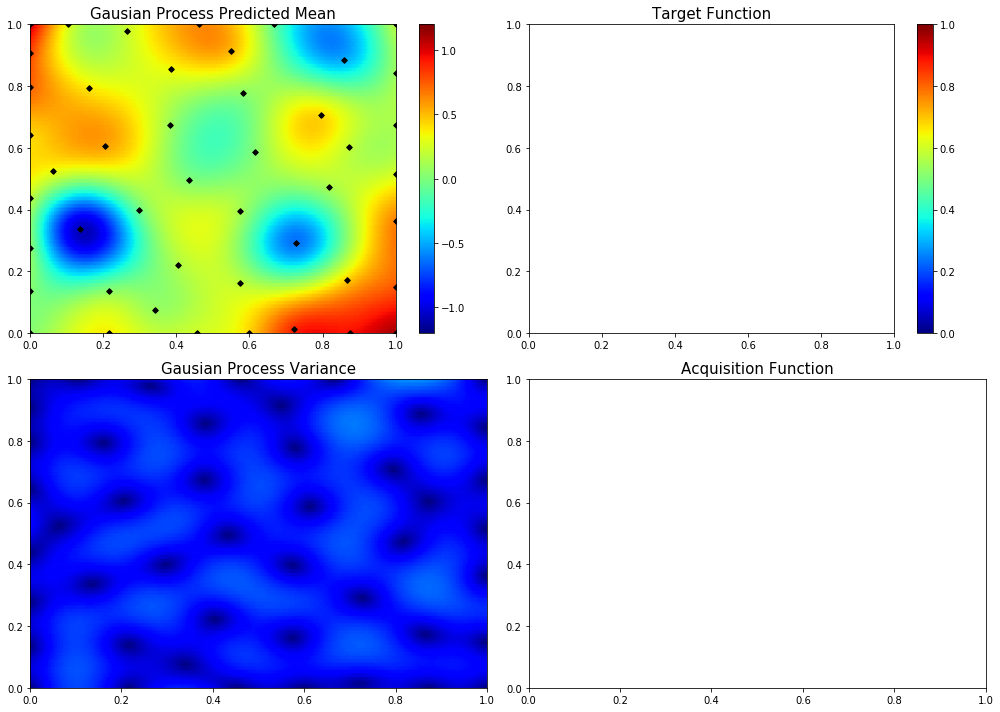

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.111934538673064, 0.7388485753114856]
59  Evaluations Remaining
|  47       |  0.6221   |  0.1119   |  0.7388   |
myplot:  047


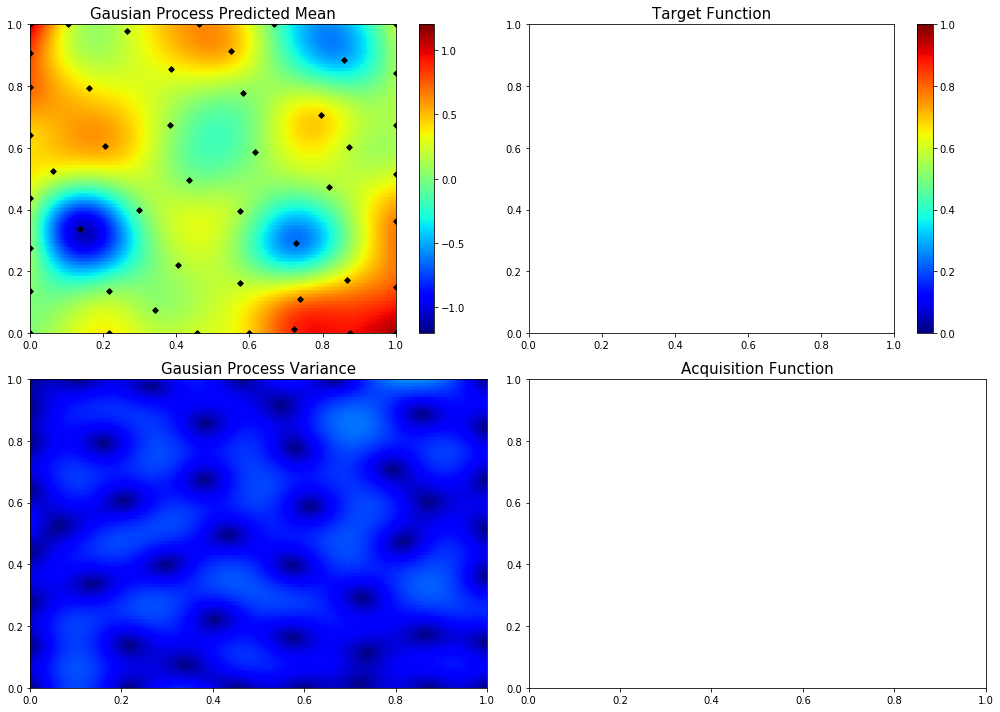

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3456809593722341, 0.45170317072177035]
58  Evaluations Remaining
|  48       |  0.4592   |  0.3457   |  0.4517   |
myplot:  048


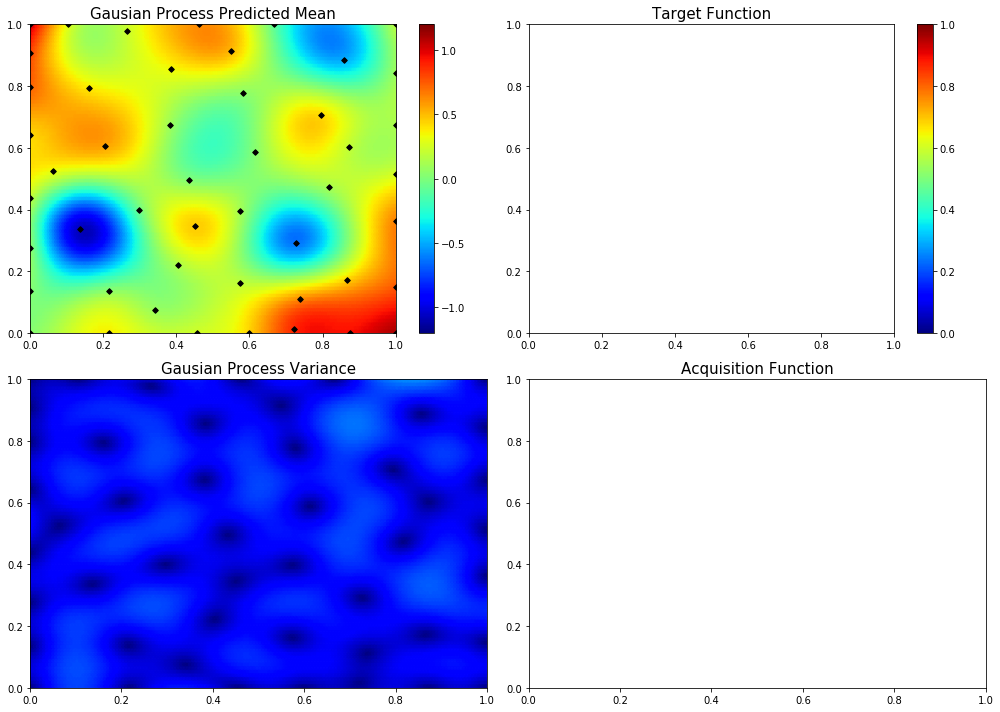

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6819486982354507, 0.10632992891783832]
57  Evaluations Remaining
|  49       |  0.7191   |  0.6819   |  0.1063   |
myplot:  049


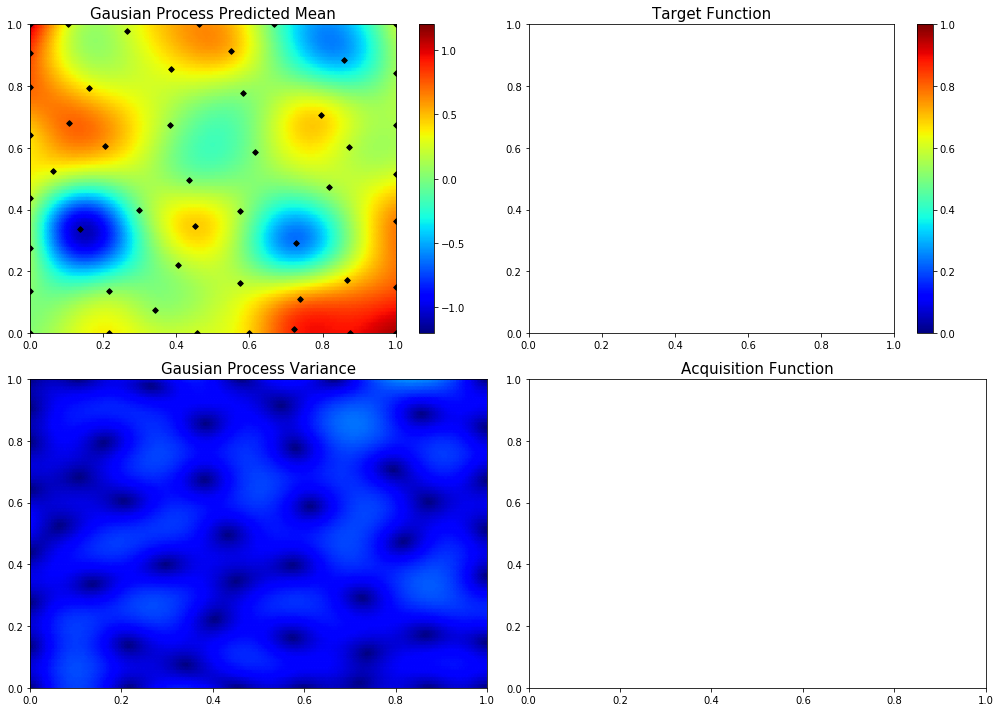

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.839470351137488, 0.7006102286118562]
56  Evaluations Remaining
|  50       | -0.1323   |  0.8395   |  0.7006   |
myplot:  050


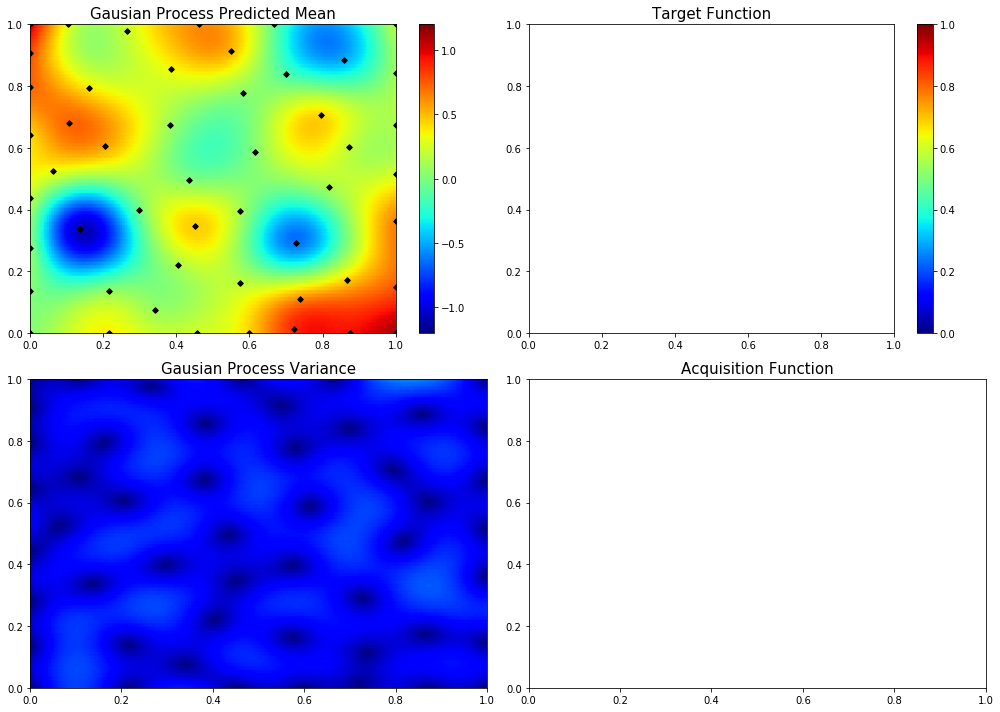

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.25495590910915844, 1.0]
55  Evaluations Remaining
|  51       |  0.8126   |  0.255    |  1.0      |
myplot:  051


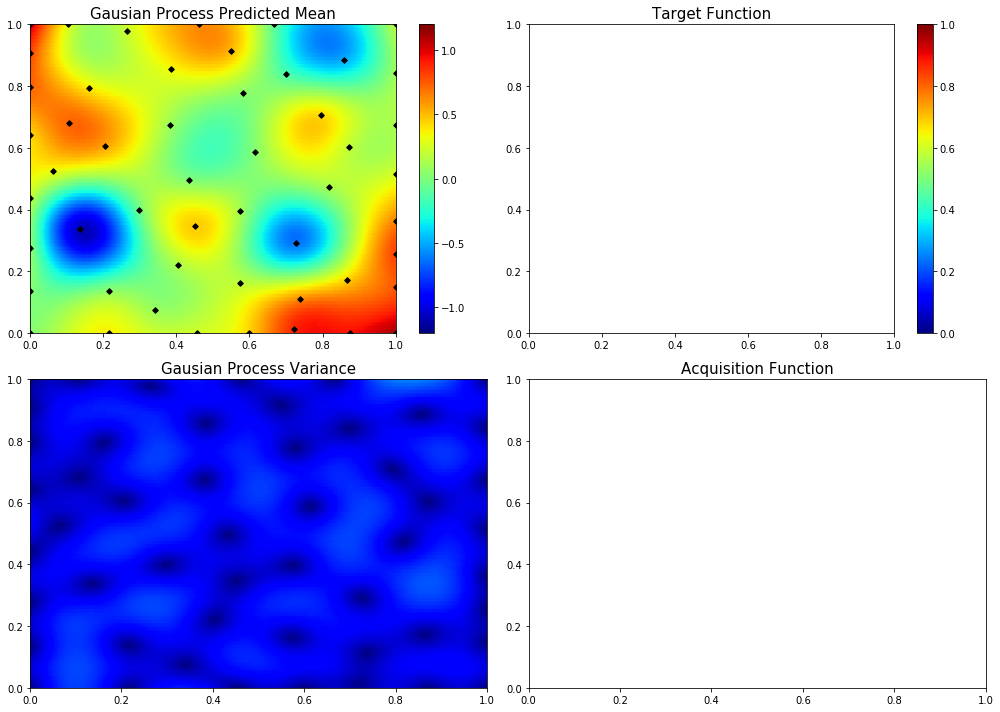

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3349933390447986, 0.8999066280760136]
54  Evaluations Remaining
|  52       |  0.04677  |  0.335    |  0.8999   |
myplot:  052


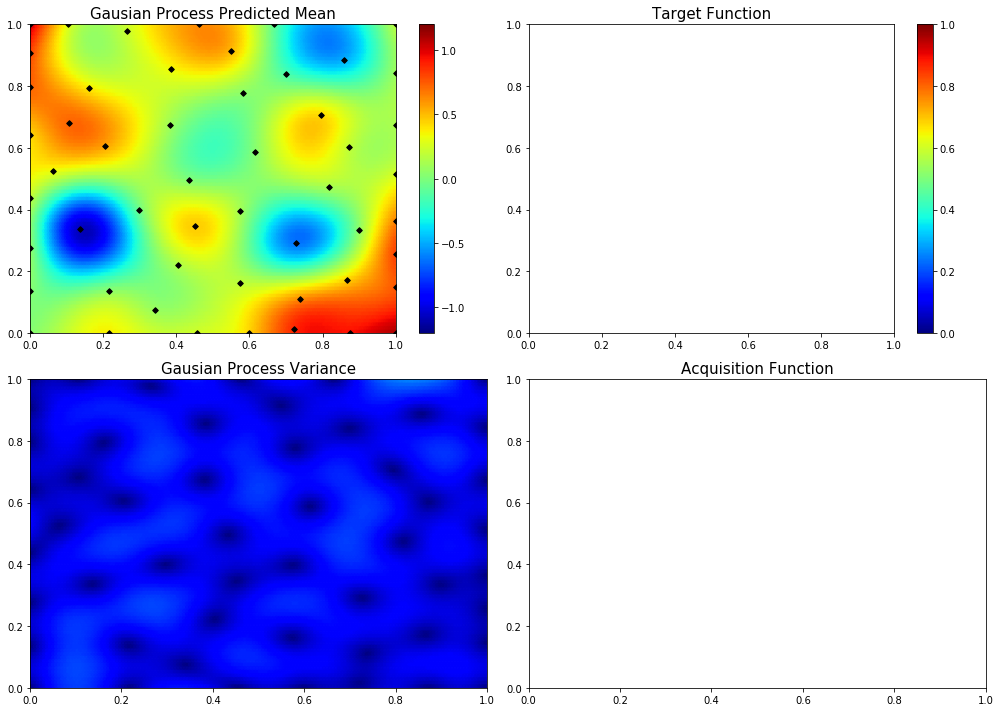

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7314781383662662, 0.265627197423373]
53  Evaluations Remaining
|  53       |  0.2743   |  0.7315   |  0.2656   |
myplot:  053


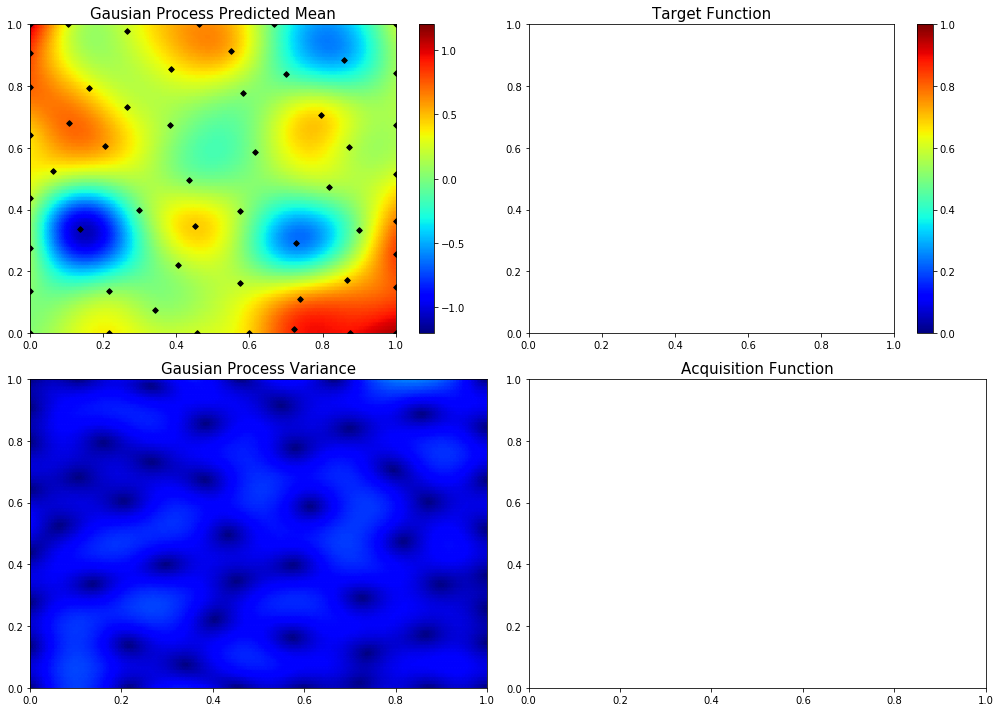

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.592863746525777, 0.7400883838094575]
52  Evaluations Remaining
|  54       |  0.4246   |  0.5929   |  0.7401   |
myplot:  054


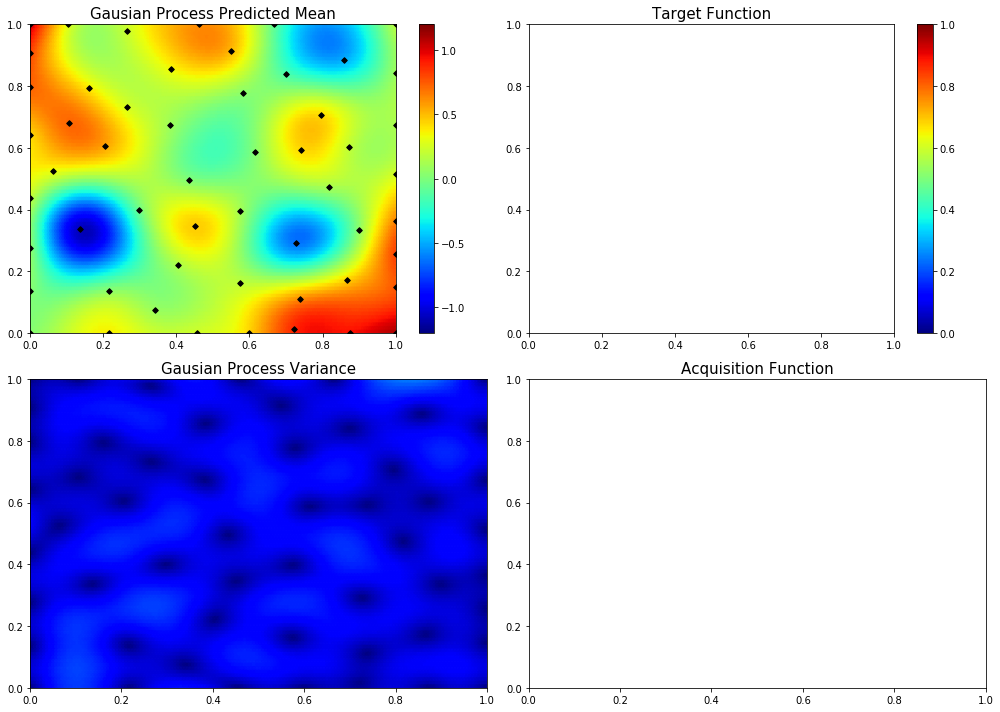

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.043513895875566165, 0.10840996961981393]
51  Evaluations Remaining
|  55       |  0.3505   |  0.04351  |  0.1084   |
myplot:  055


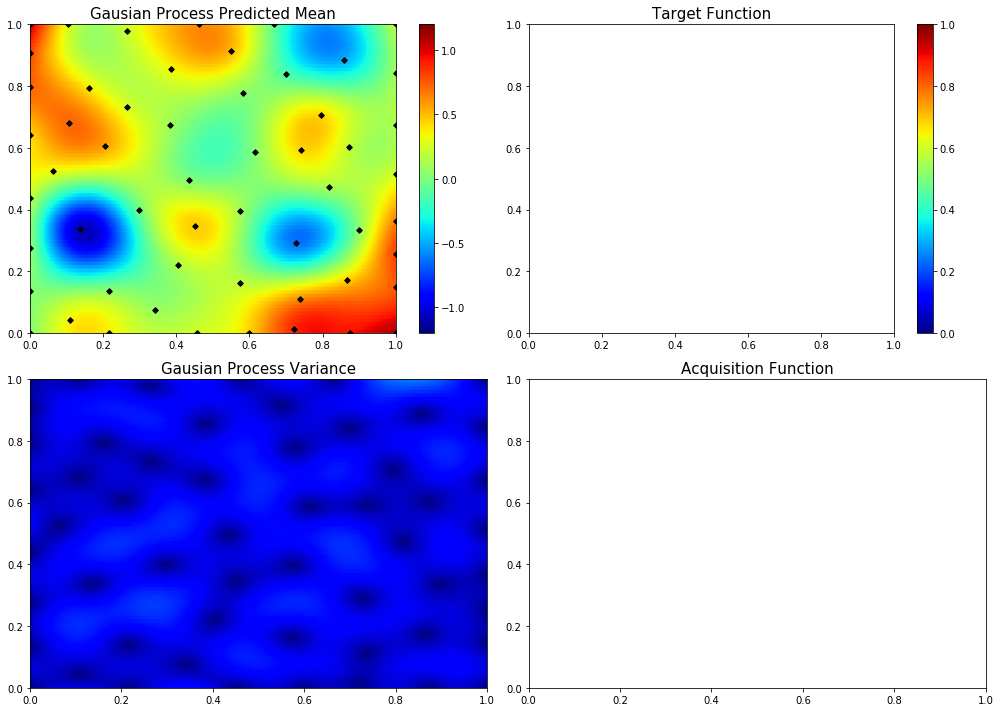

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.06446469427854071, 0.9329418239117916]
50  Evaluations Remaining
|  56       |  0.8357   |  0.06446  |  0.9329   |
myplot:  056


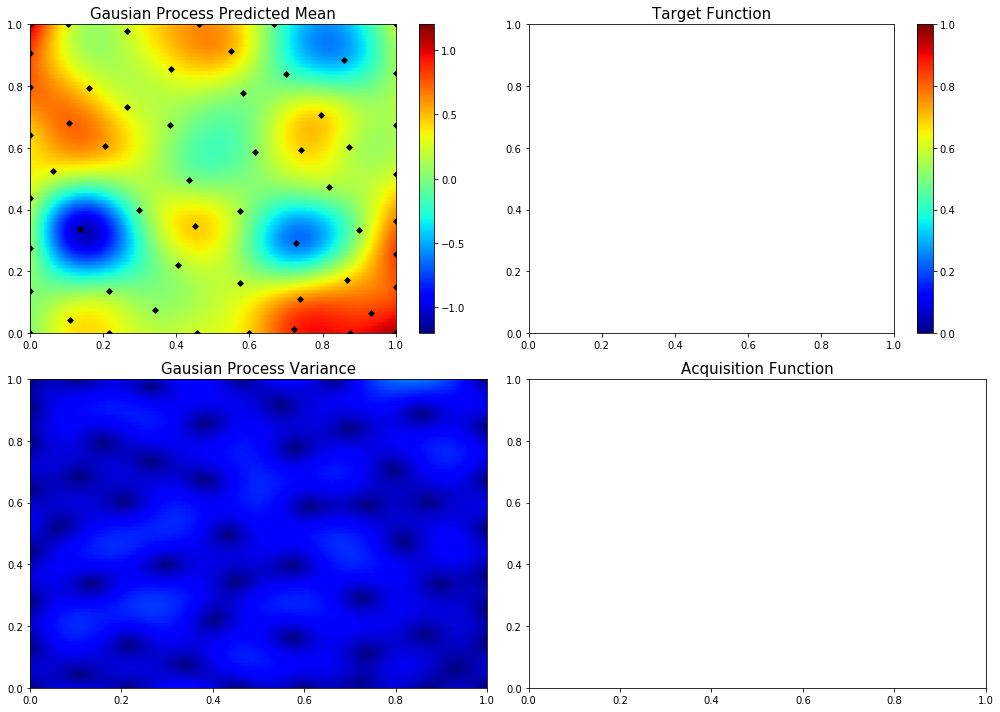

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.8463875496362302]
49  Evaluations Remaining
|  57       | -0.5081   |  1.0      |  0.8464   |
myplot:  057


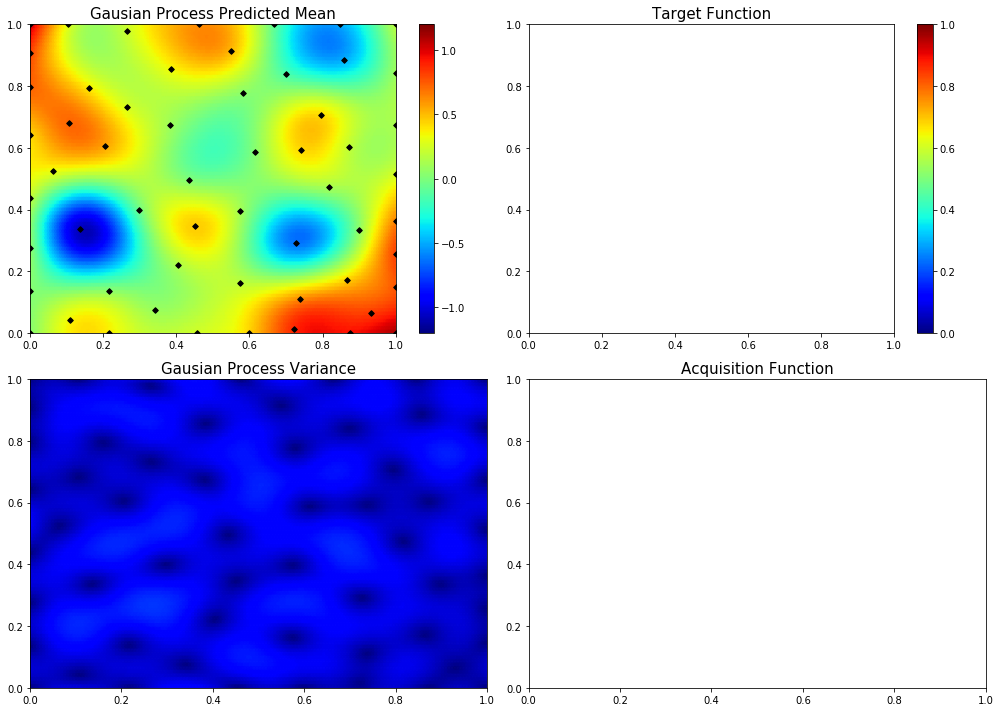

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0562724598336877, 0.8139476815282827]
48  Evaluations Remaining
|  58       |  1.094    |  0.05627  |  0.8139   |
myplot:  058


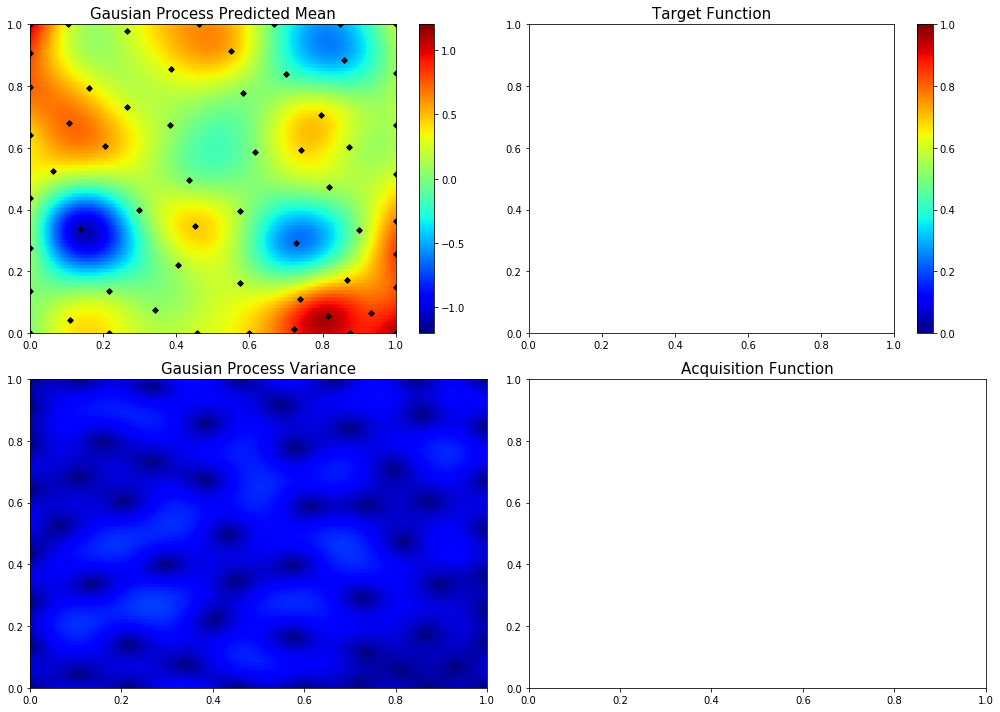

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.539715885863912, 0.3035809818478979]
47  Evaluations Remaining
|  59       |  0.07756  |  0.5397   |  0.3036   |
myplot:  059


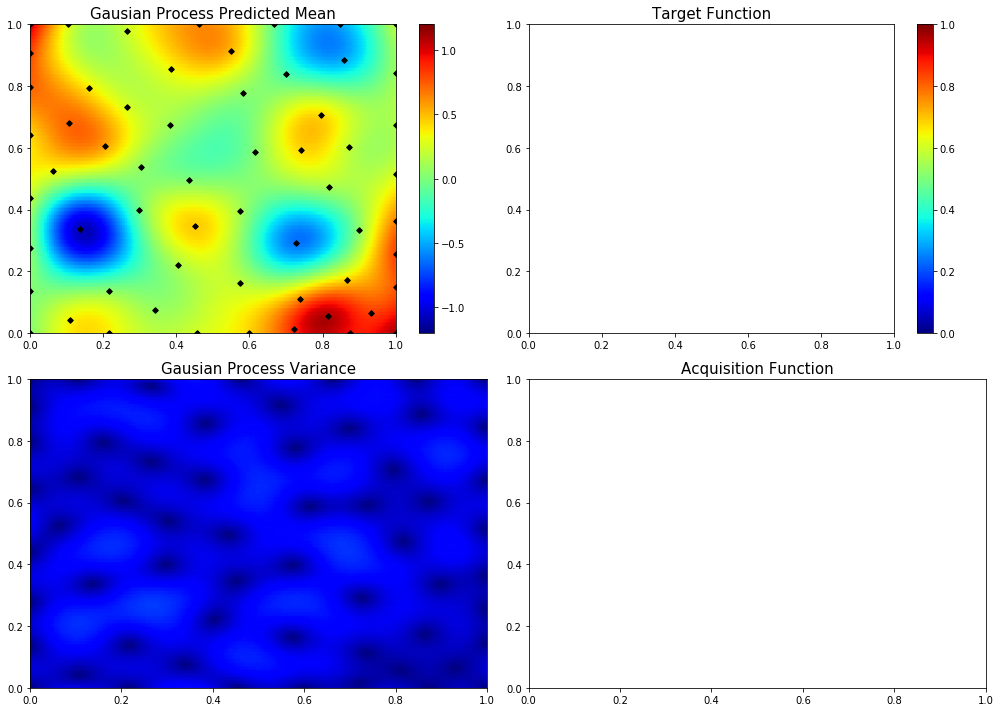

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.3664739148551772]
46  Evaluations Remaining
|  60       |  0.5881   |  1.0      |  0.3665   |
myplot:  060


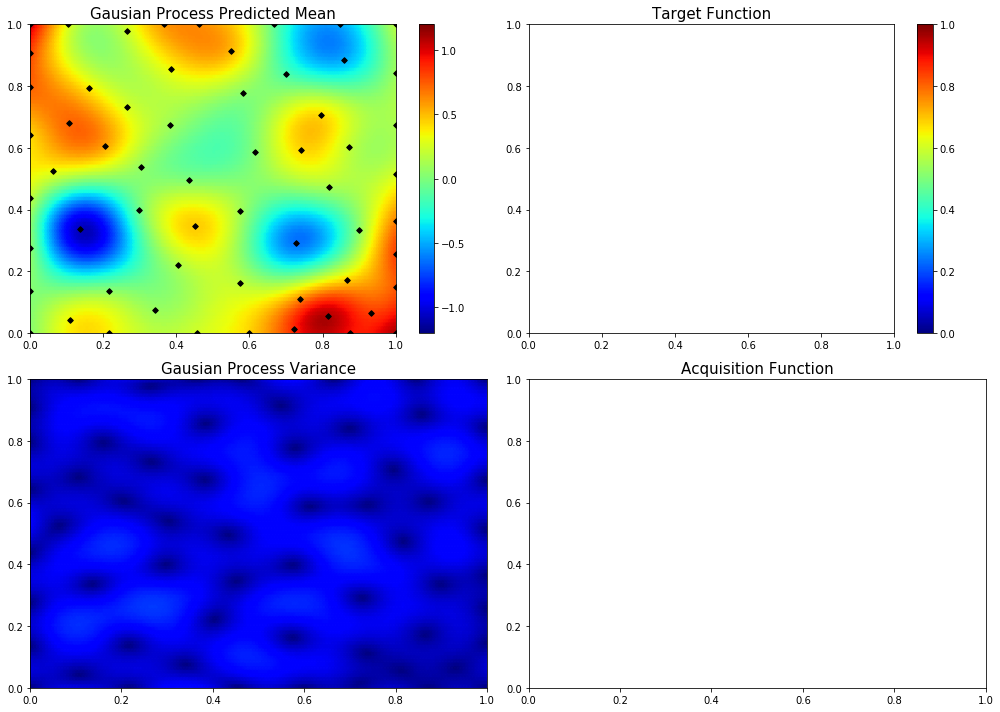

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.792960731771549]
45  Evaluations Remaining
|  61       |  1.337    |  0.0      |  0.793    |
myplot:  061


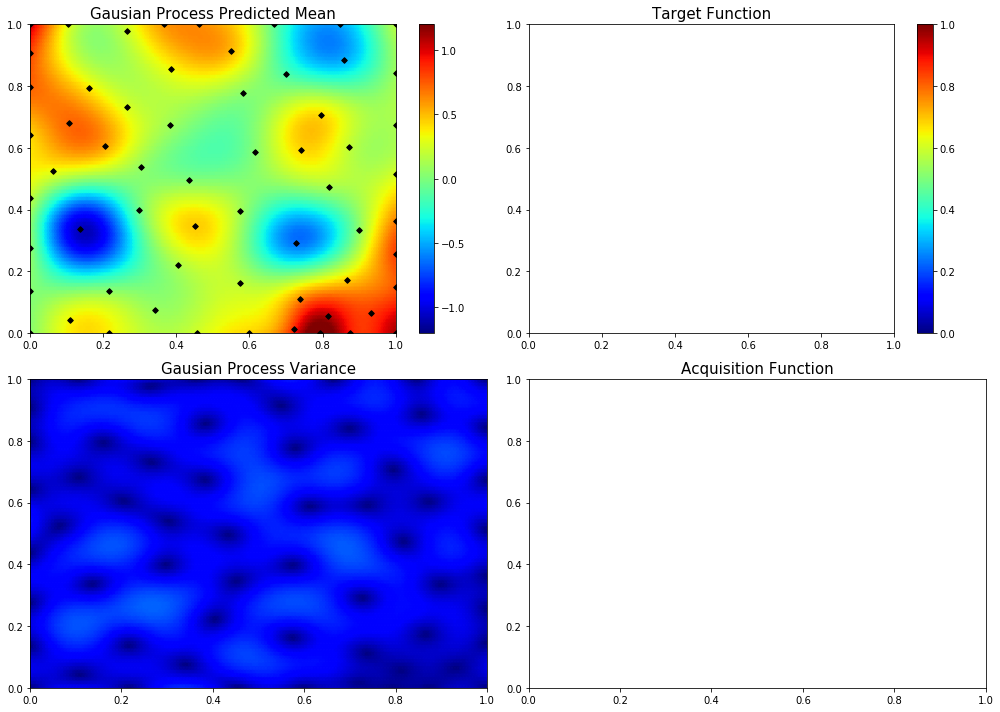

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.2757741647988716, 0.5379151142000904]
44  Evaluations Remaining
|  62       |  0.4288   |  0.2758   |  0.5379   |
myplot:  062


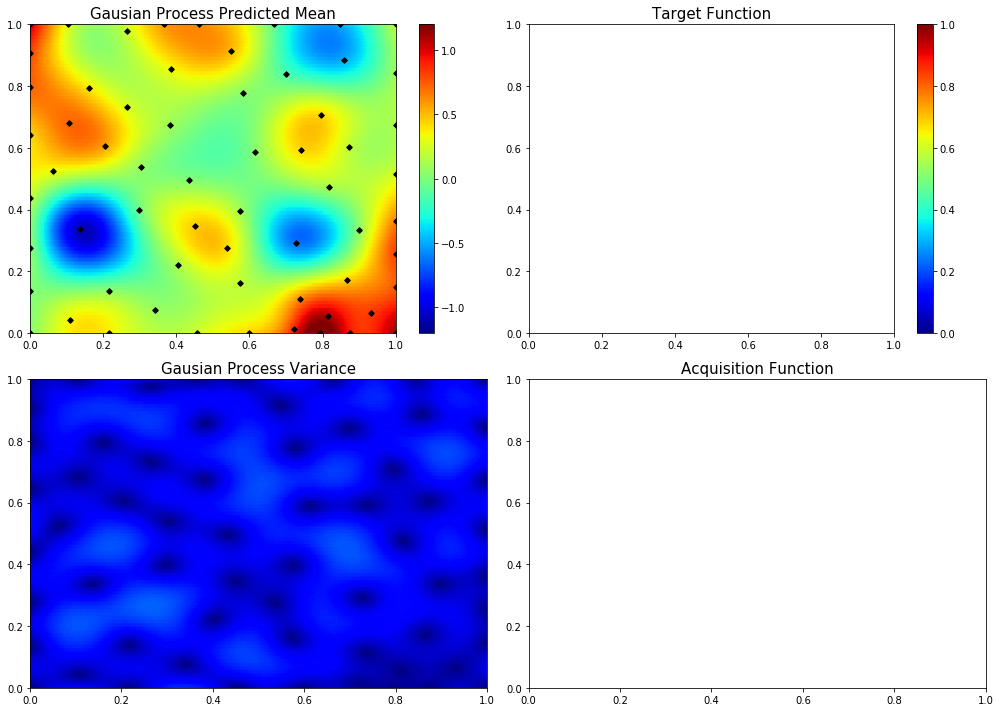

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.694591930961347, 0.6873877391901386]
43  Evaluations Remaining
|  63       |  0.09201  |  0.6946   |  0.6874   |
myplot:  063


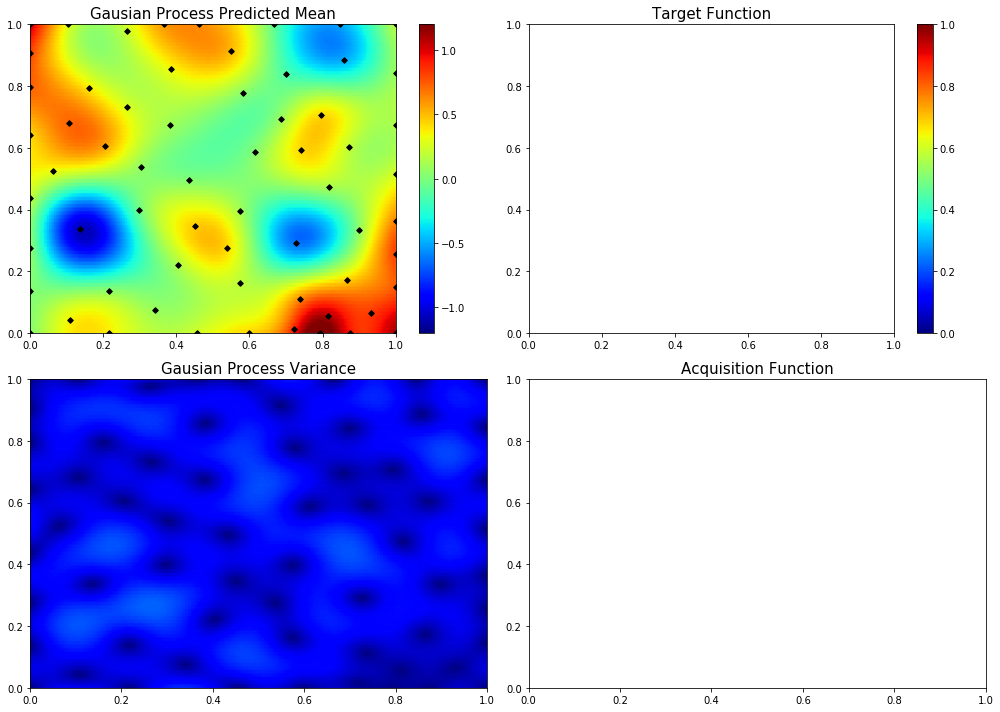

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.05860953738582214, 1.0]
42  Evaluations Remaining
|  64       |  0.995    |  0.05861  |  1.0      |
myplot:  064


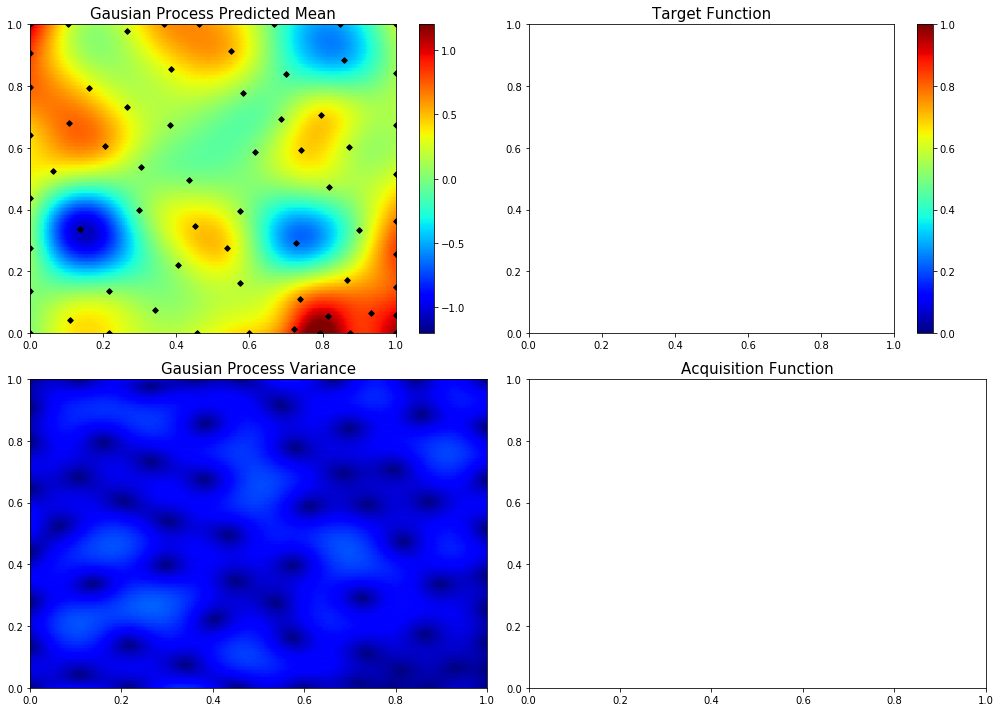

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7457650424102318, 0.9101319367103683]
41  Evaluations Remaining
|  65       |  0.04447  |  0.7458   |  0.9101   |
myplot:  065


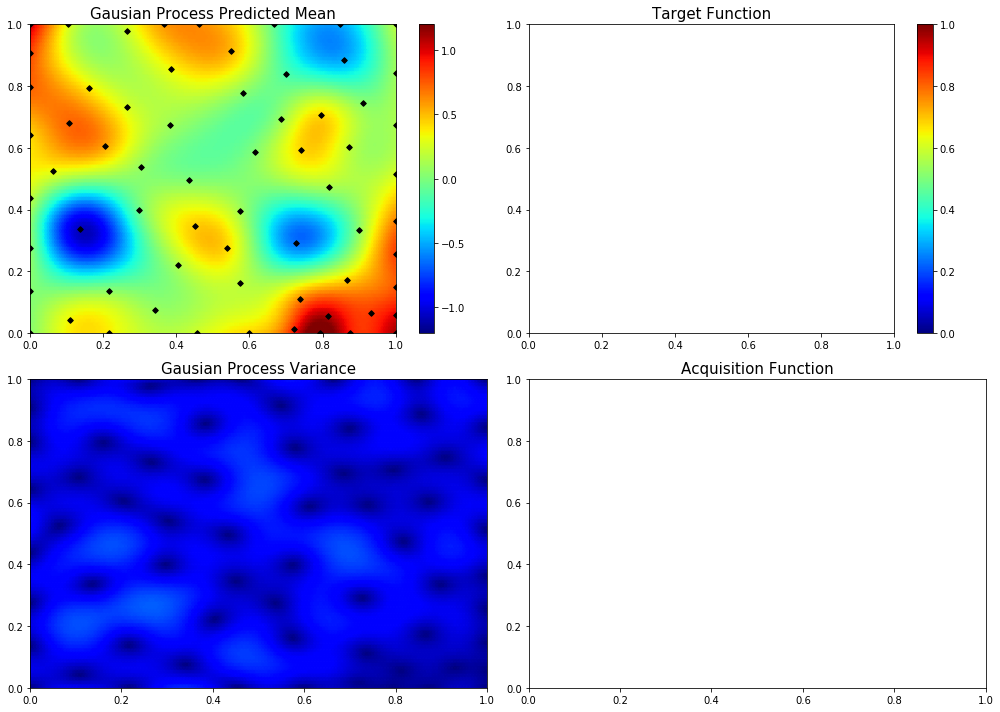

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8589415182352866, 0.0736012886144881]
40  Evaluations Remaining
|  66       |  0.4426   |  0.8589   |  0.0736   |
myplot:  066


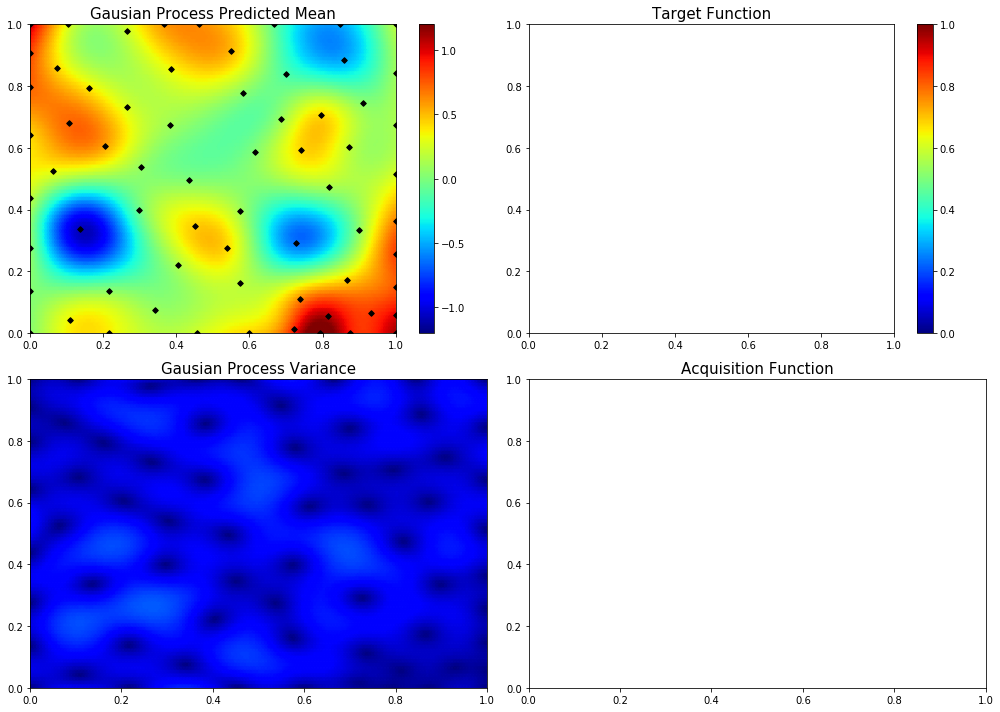

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.10366192627383168, 0.47992482855851576]
39  Evaluations Remaining
|  67       |  0.1914   |  0.1037   |  0.4799   |
myplot:  067


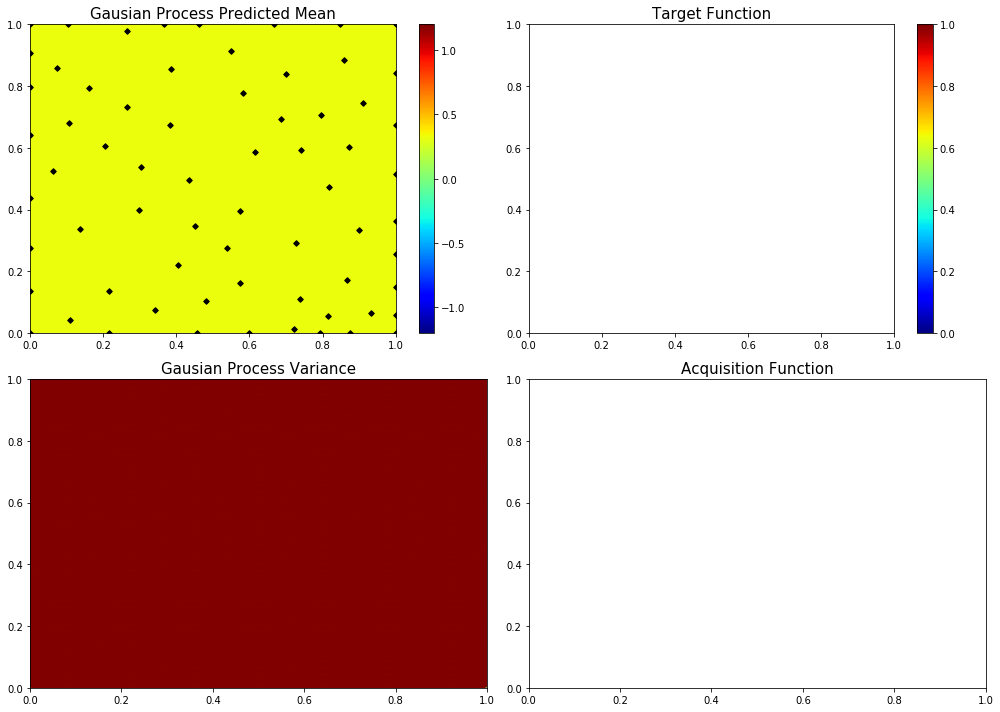

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7932602416807476, 0.4667214299950577]
38  Evaluations Remaining
|  68       |  0.164    |  0.7933   |  0.4667   |
myplot:  068


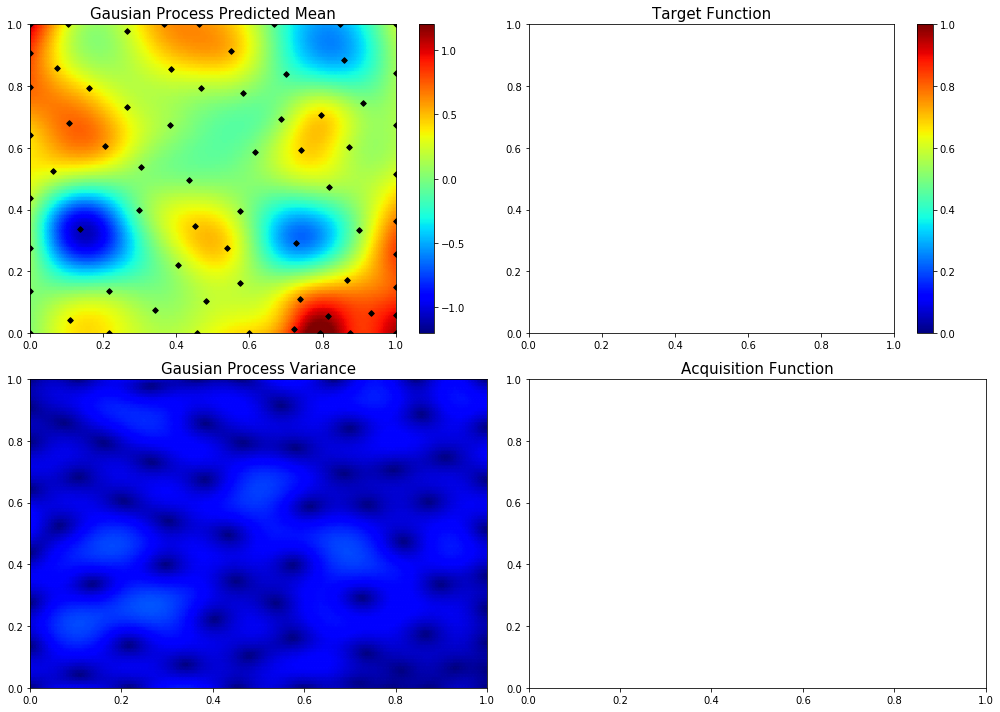

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4782357266761352, 0.6903934213202196]
37  Evaluations Remaining
|  69       |  0.04805  |  0.4782   |  0.6904   |
myplot:  069


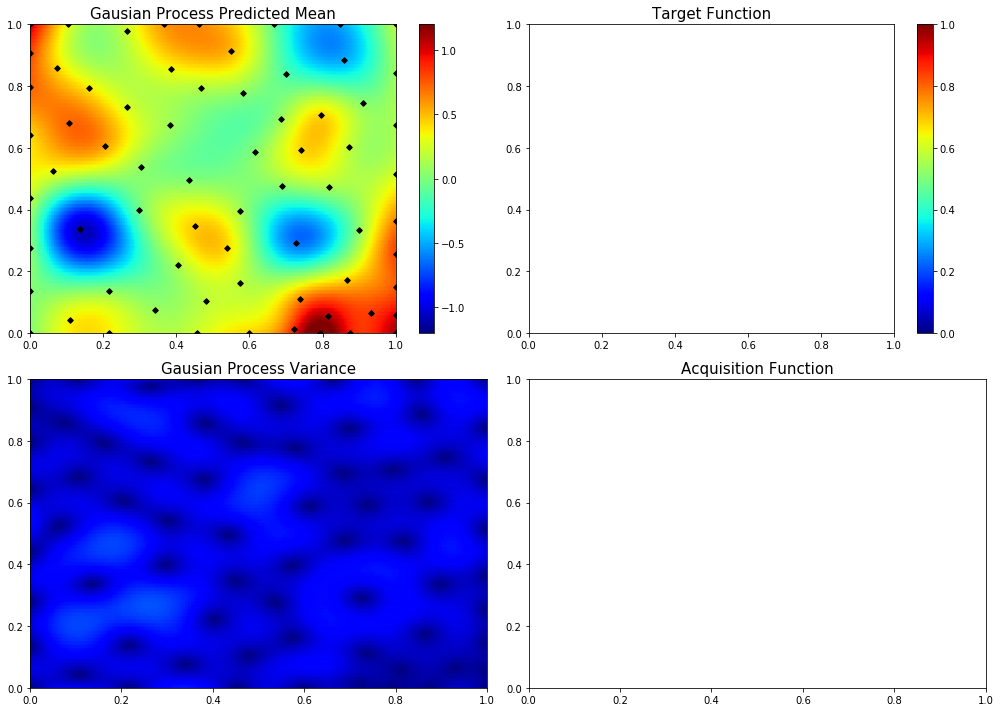

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9262029176258176, 0.4452151596151097]
36  Evaluations Remaining
|  70       |  0.8701   |  0.9262   |  0.4452   |
myplot:  070


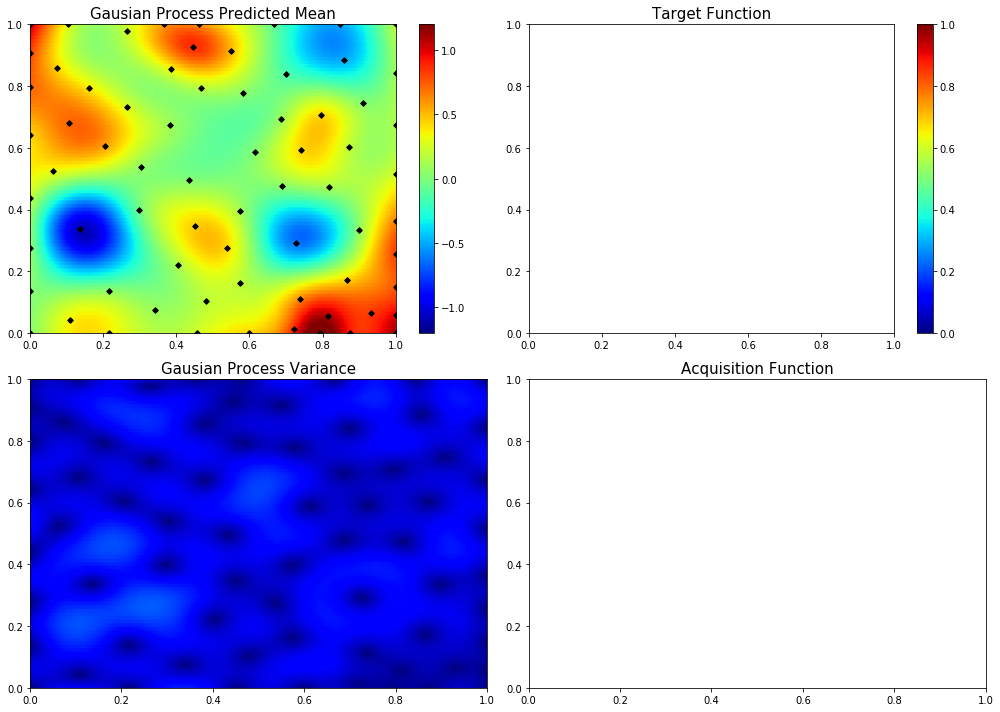

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5036221960654651, 0.18033422832073512]
35  Evaluations Remaining
|  71       |  0.2947   |  0.5036   |  0.1803   |
myplot:  071


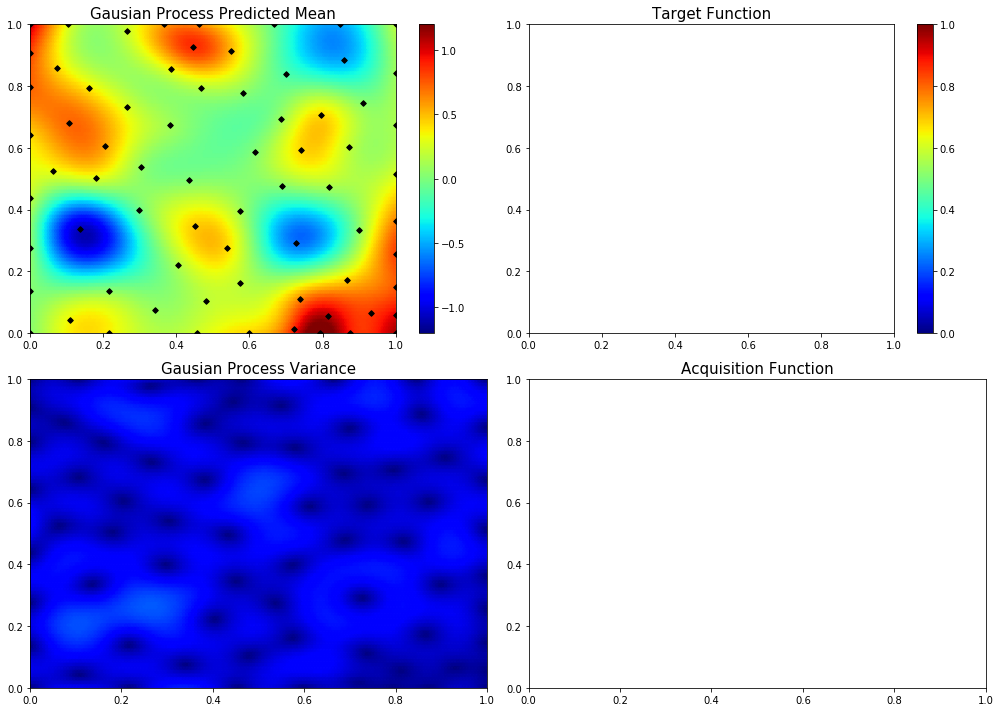

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6435641307068307, 0.4993849463102225]
34  Evaluations Remaining
|  72       |  0.04232  |  0.6436   |  0.4994   |
myplot:  072


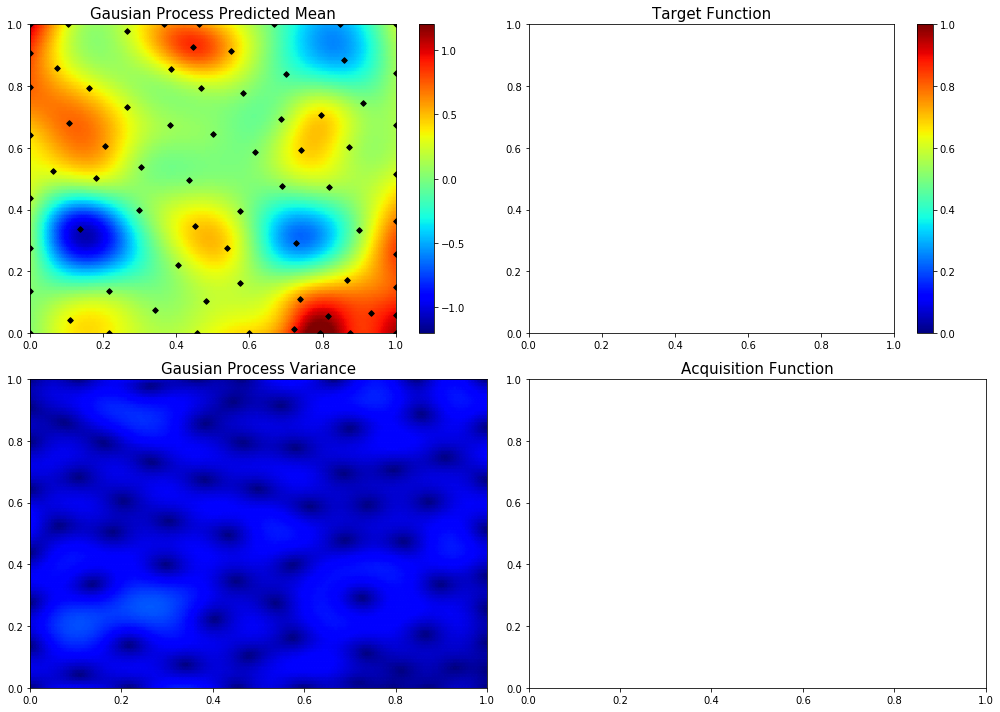

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.027600243037674384, 0.7781306667253955]
33  Evaluations Remaining
|  73       |  1.125    |  0.0276   |  0.7781   |
myplot:  073


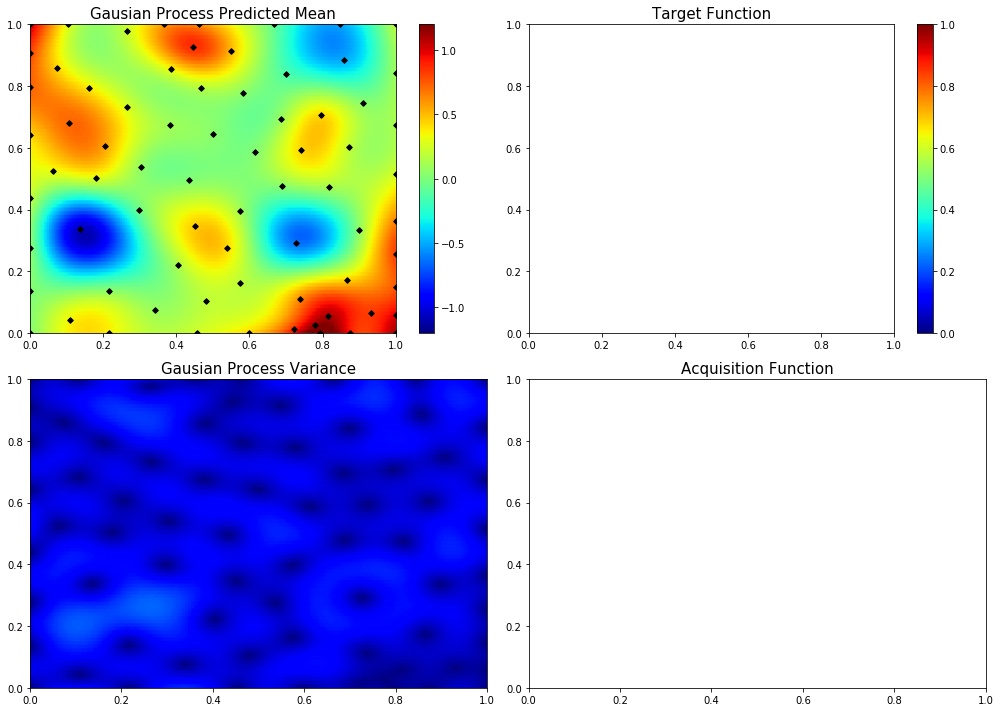

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.8709362312390978, 0.24973155410835013]
32  Evaluations Remaining
|  74       |  0.1754   |  0.8709   |  0.2497   |
myplot:  074


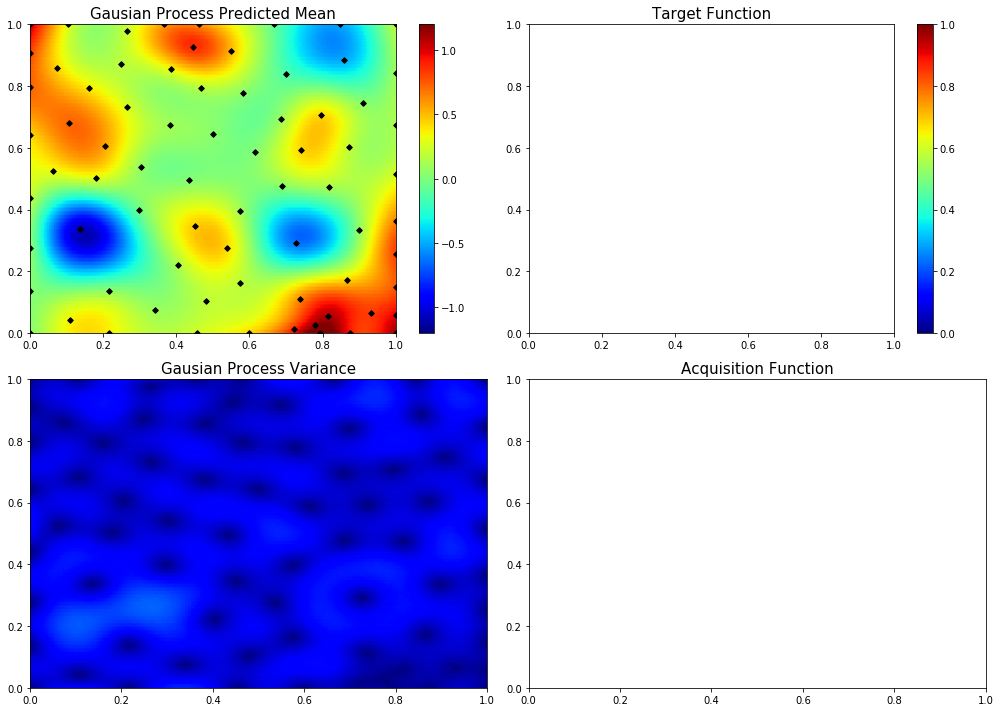

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.3302232385053696]
31  Evaluations Remaining
|  75       |  0.1566   |  0.0      |  0.3302   |
myplot:  075


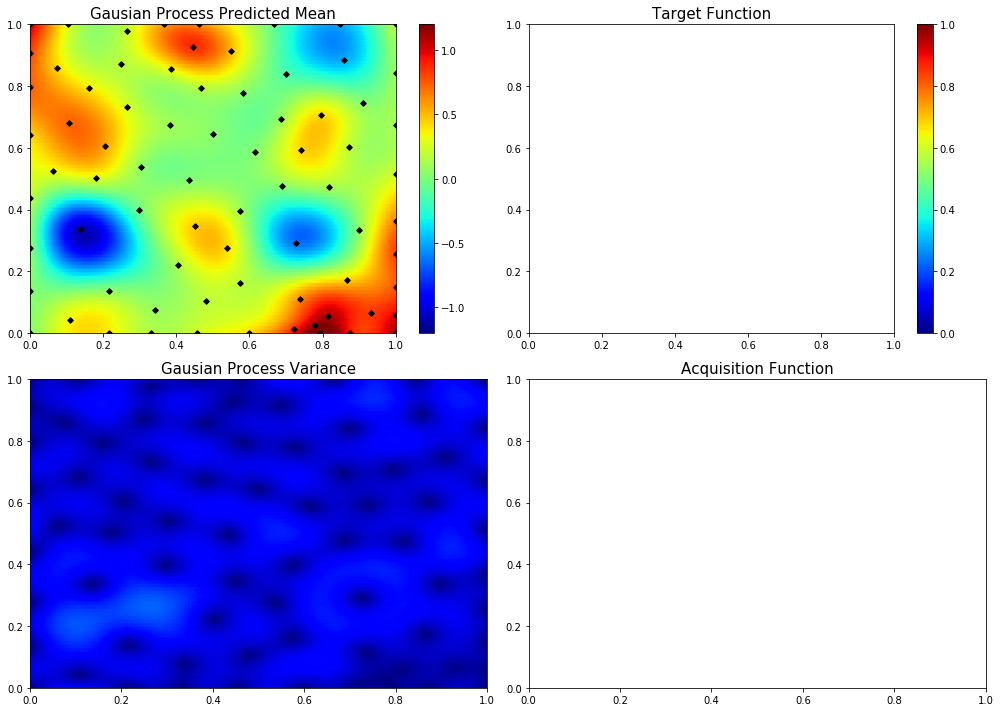

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7390945893908132, 0.05155778046929138]
30  Evaluations Remaining
|  76       |  0.6184   |  0.7391   |  0.05156  |
myplot:  076


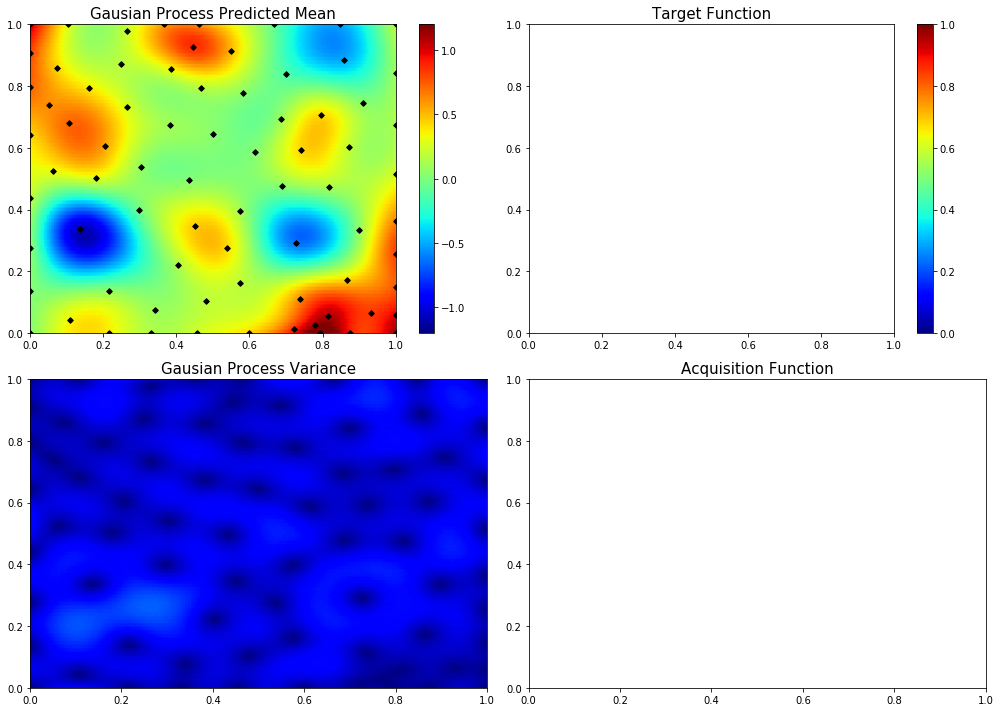

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.8192353598765871]
29  Evaluations Remaining
|  77       |  1.279    |  0.0      |  0.8192   |
myplot:  077


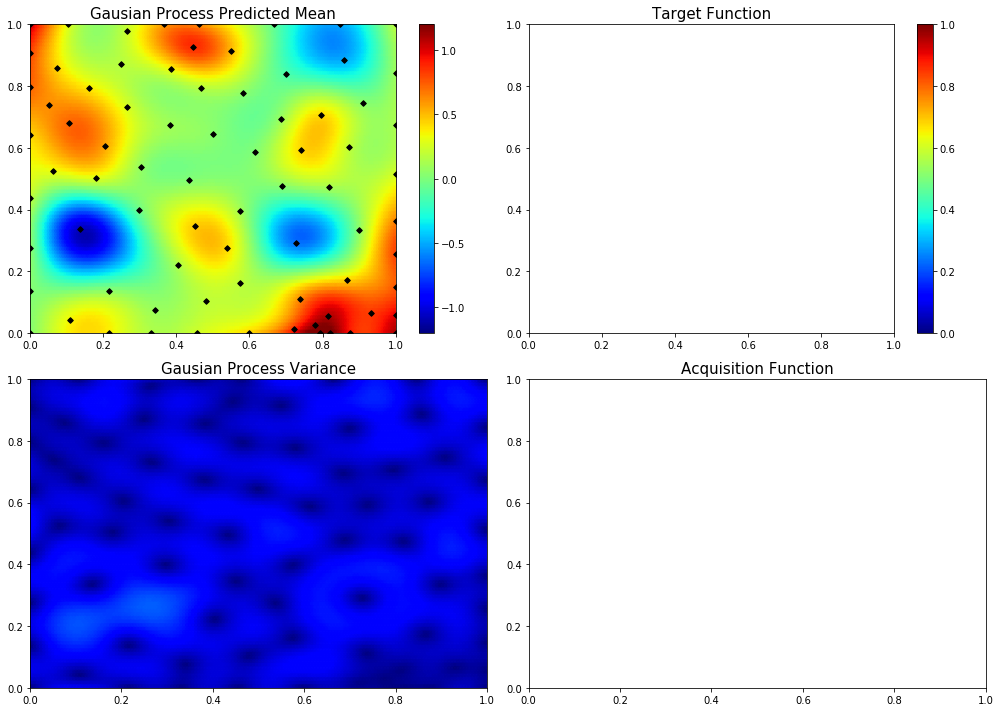

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5990834616507743, 0.11724955863881302]
28  Evaluations Remaining
|  78       |  0.654    |  0.5991   |  0.1172   |
myplot:  078


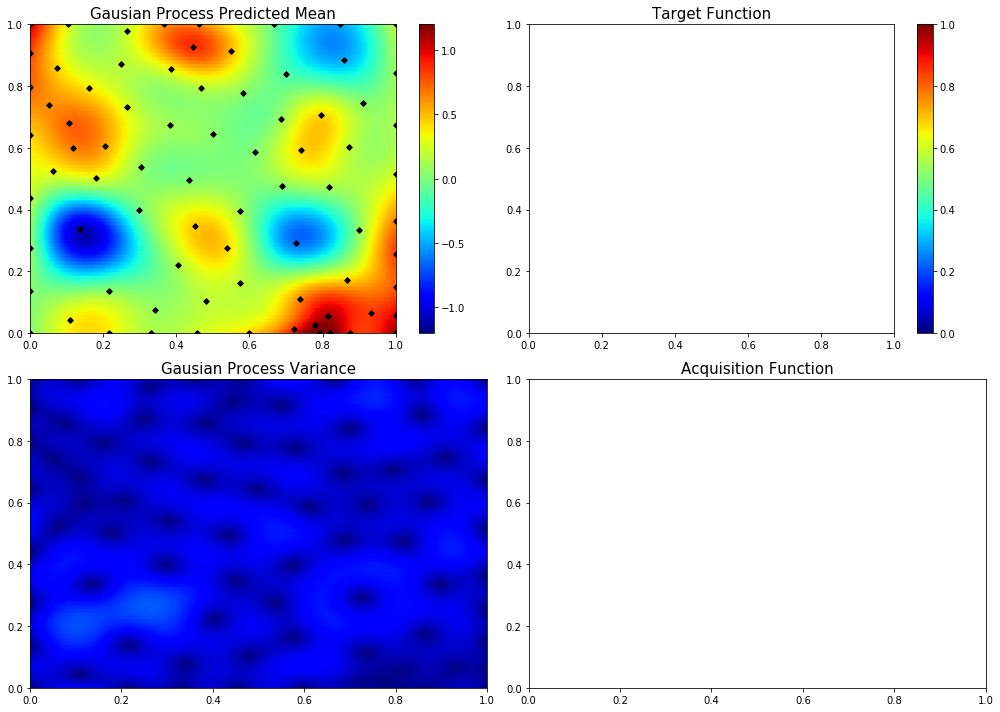

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4489513654531039, 0.9350394640273968]
27  Evaluations Remaining
|  79       |  0.2586   |  0.449    |  0.935    |
myplot:  079


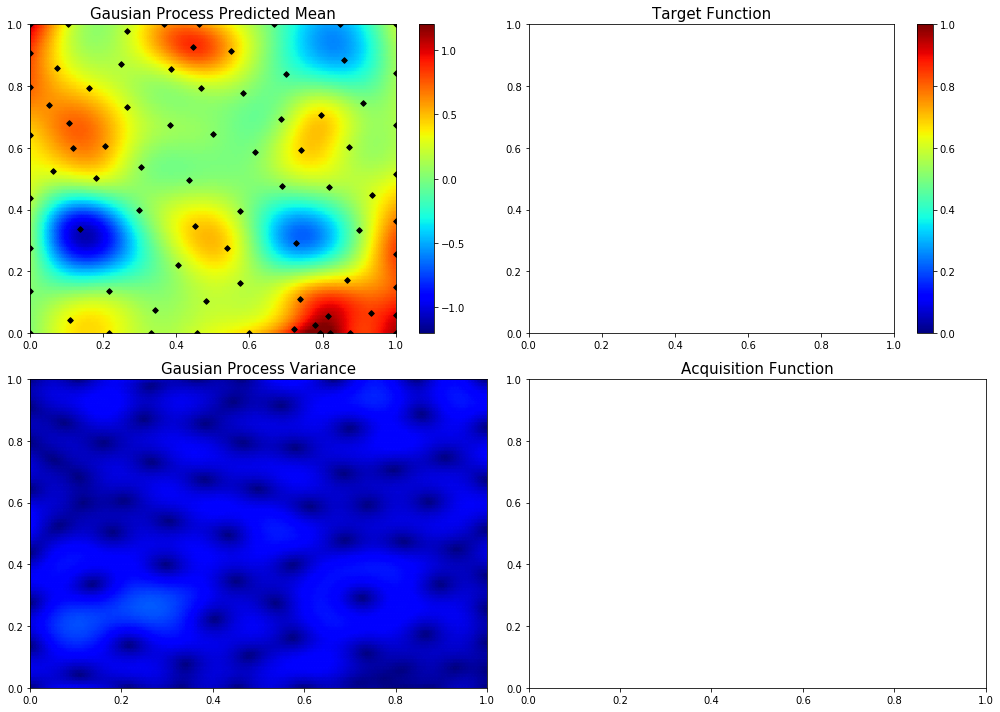

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7695514006663945]
26  Evaluations Remaining
|  80       |  1.299    |  0.0      |  0.7696   |
myplot:  080


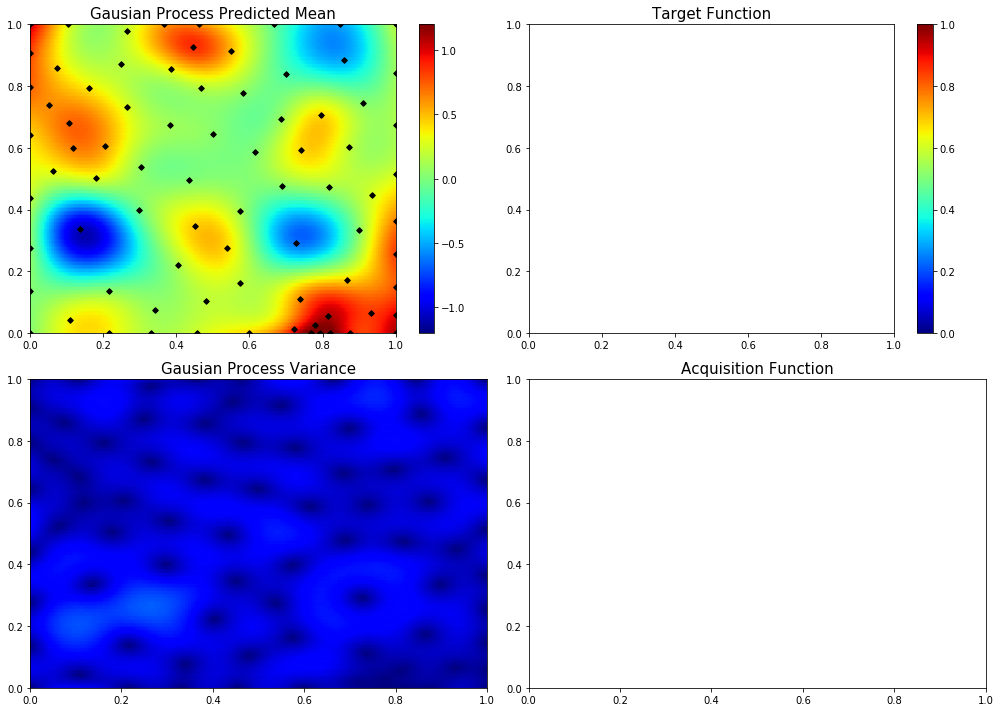

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [1.0, 0.55656766451465]
25  Evaluations Remaining
|  81       |  0.393    |  1.0      |  0.5566   |
myplot:  081


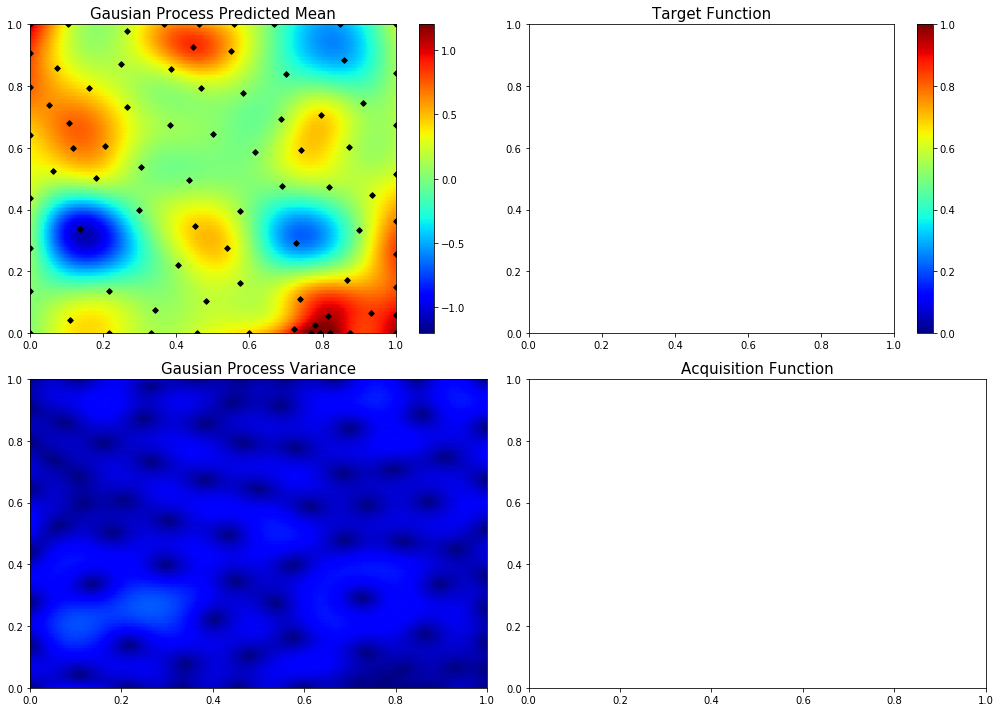

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0, 0.7866590780022104]
24  Evaluations Remaining
|  82       |  1.393    |  0.0      |  0.7867   |
myplot:  082


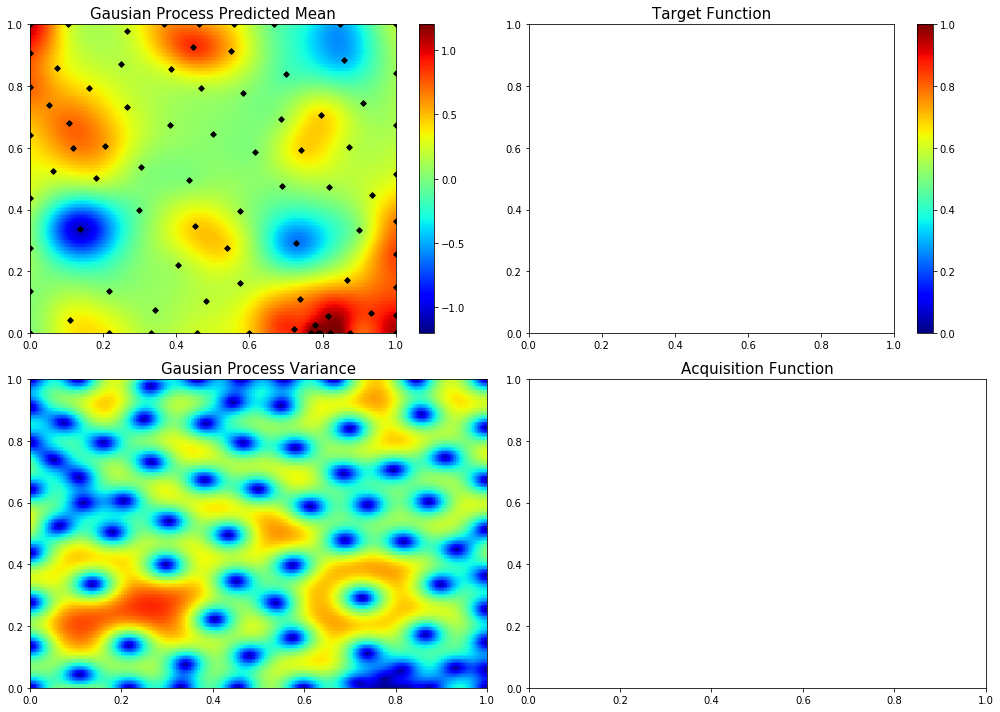

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.26026974273480125, 0.2788887306956166]
23  Evaluations Remaining
|  83       | -0.1638   |  0.2603   |  0.2789   |
myplot:  083


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\gaussian_process\gpr.py:480: ConvergenceWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([6.50587533e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 53, 'nit': 6, 'warnflag': 2}
  ConvergenceWarning)


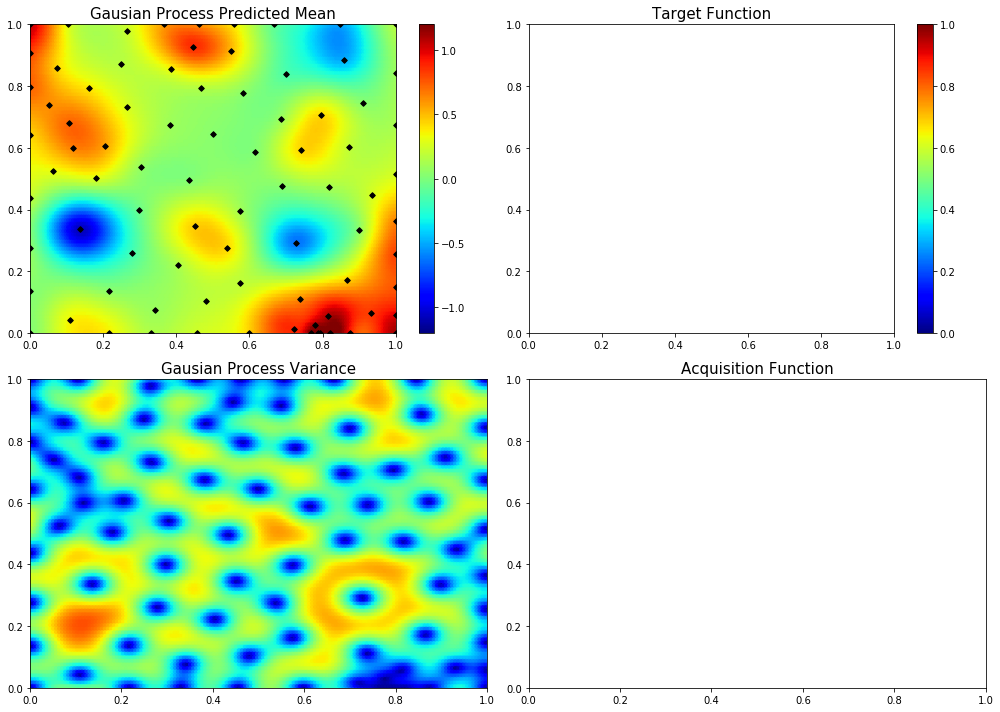

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.19244067542638915, 0.1087437867828249]
22  Evaluations Remaining
|  84       | -0.1881   |  0.1924   |  0.1087   |
myplot:  084


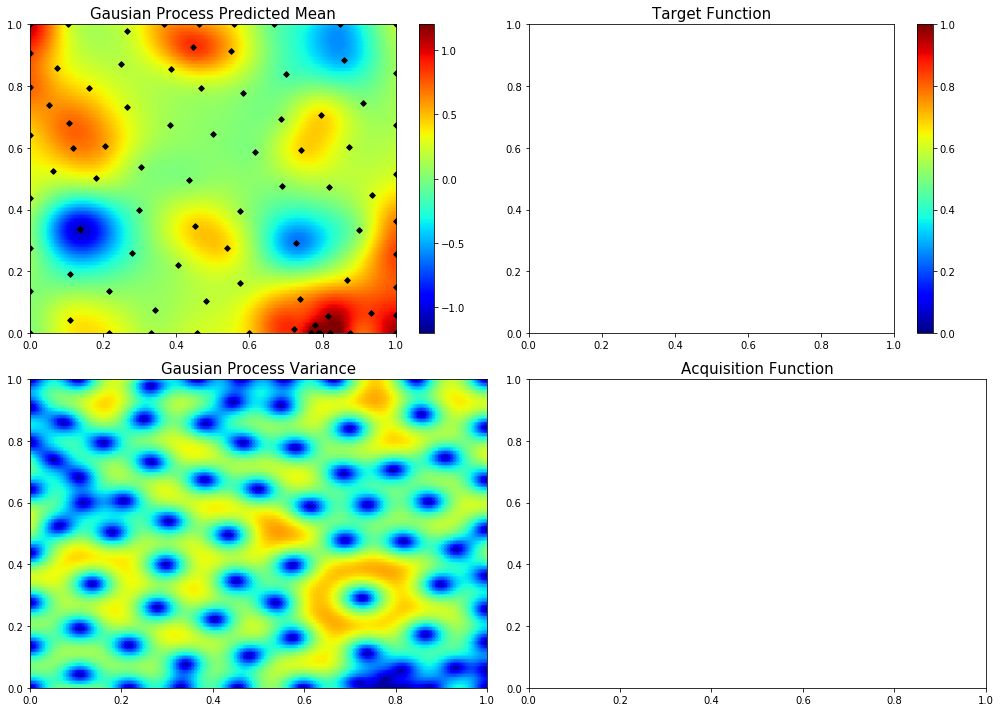

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5044735234432395, 0.5436637744483949]
21  Evaluations Remaining
|  85       |  0.0185   |  0.5045   |  0.5437   |
myplot:  085


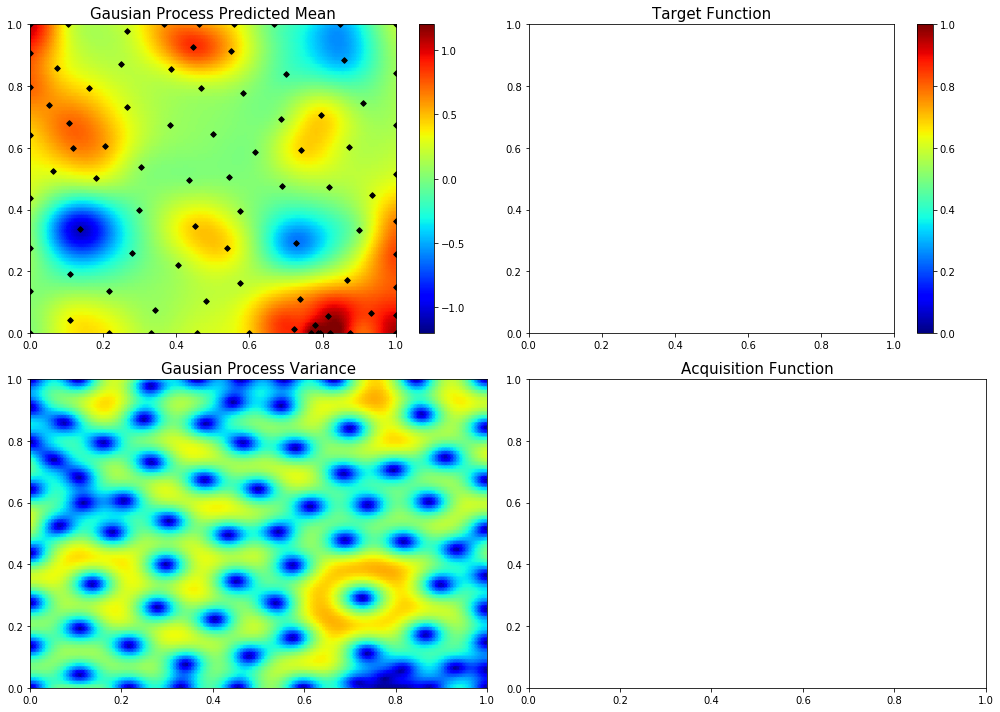

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0885775430614773, 0.6419465913637402]
20  Evaluations Remaining
|  86       |  0.3732   |  0.08858  |  0.6419   |
myplot:  086


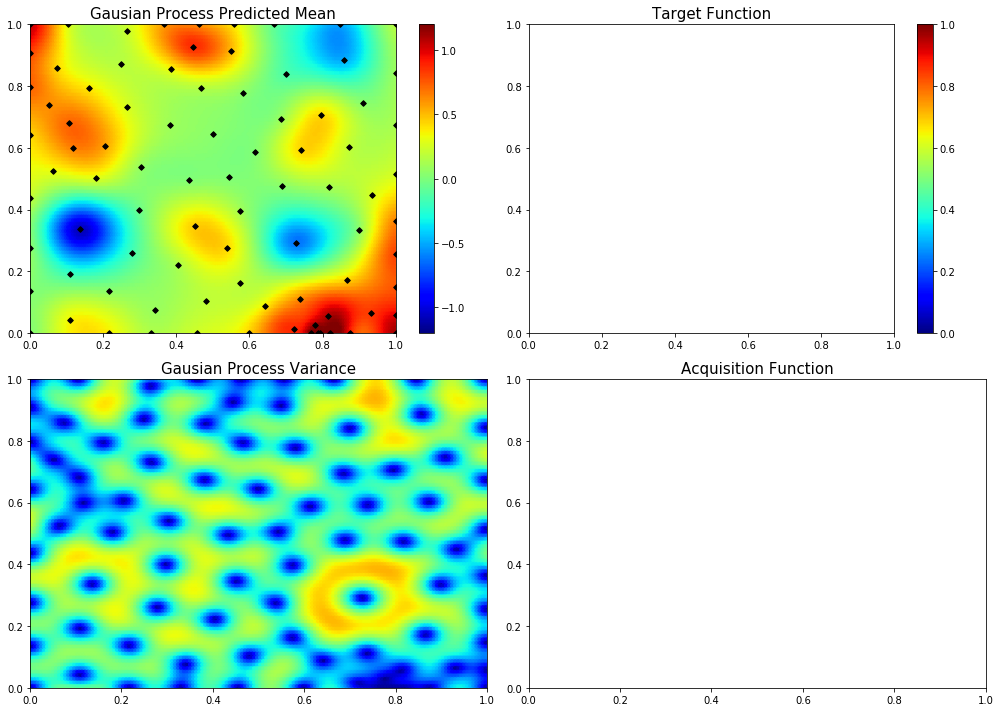

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.20335826555974937, 0.6653237840527687]
19  Evaluations Remaining
|  87       |  0.1756   |  0.2034   |  0.6653   |
myplot:  087


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\gaussian_process\gpr.py:480: ConvergenceWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([-5.70743152e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 55, 'nit': 6, 'warnflag': 2}
  ConvergenceWarning)


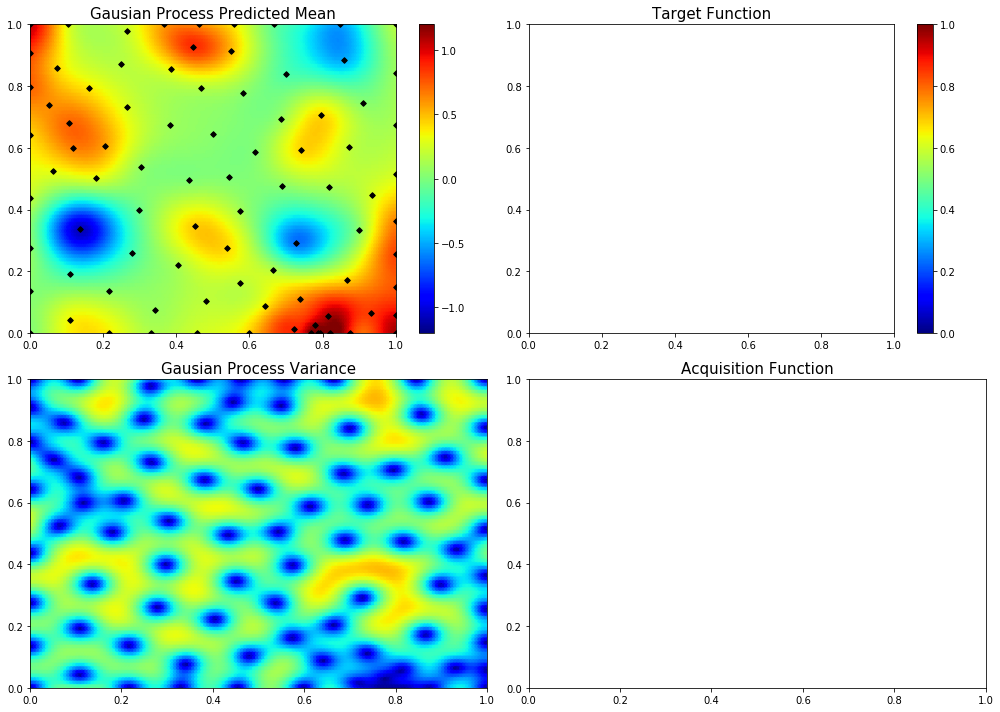

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9171945968834274, 0.16123972920853794]
18  Evaluations Remaining
|  88       | -0.4677   |  0.9172   |  0.1612   |
myplot:  088


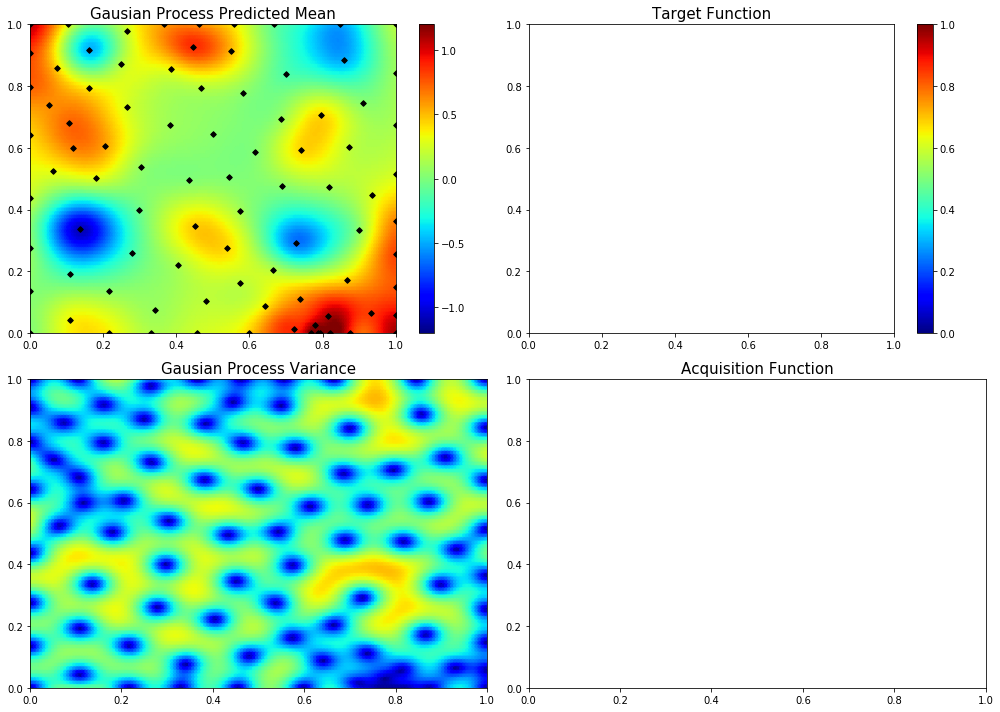

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.3223773371480564, 0.36505031961153944]
17  Evaluations Remaining
|  89       |  0.2747   |  0.3224   |  0.3651   |
myplot:  089


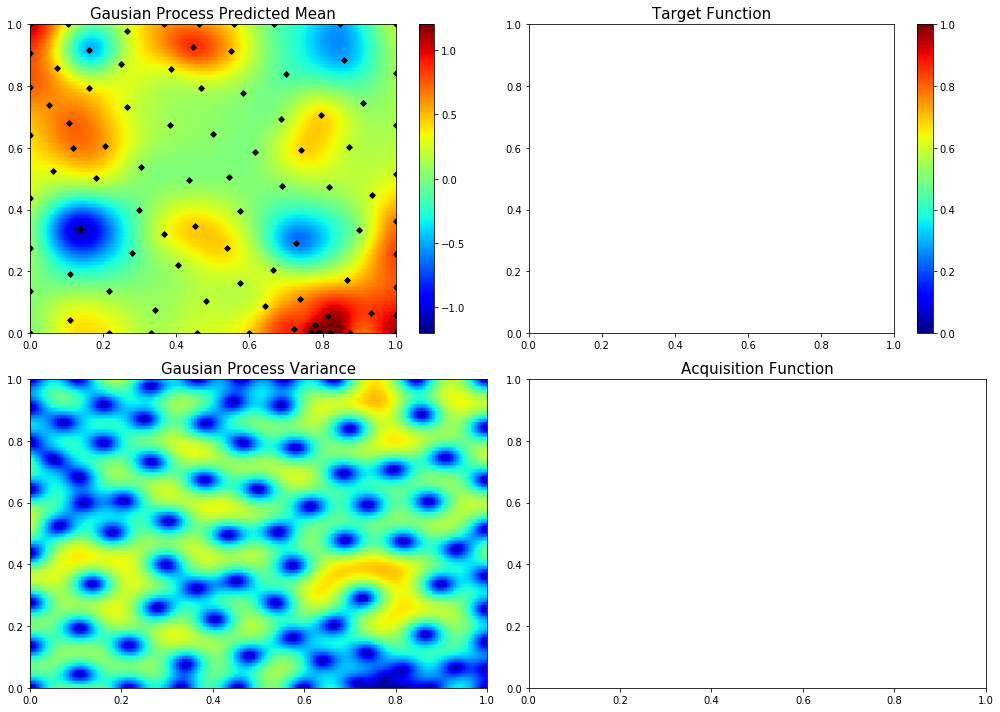

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.5508862775798492, 0.0]
16  Evaluations Remaining
|  90       |  0.3708   |  0.5509   |  0.0      |
myplot:  090


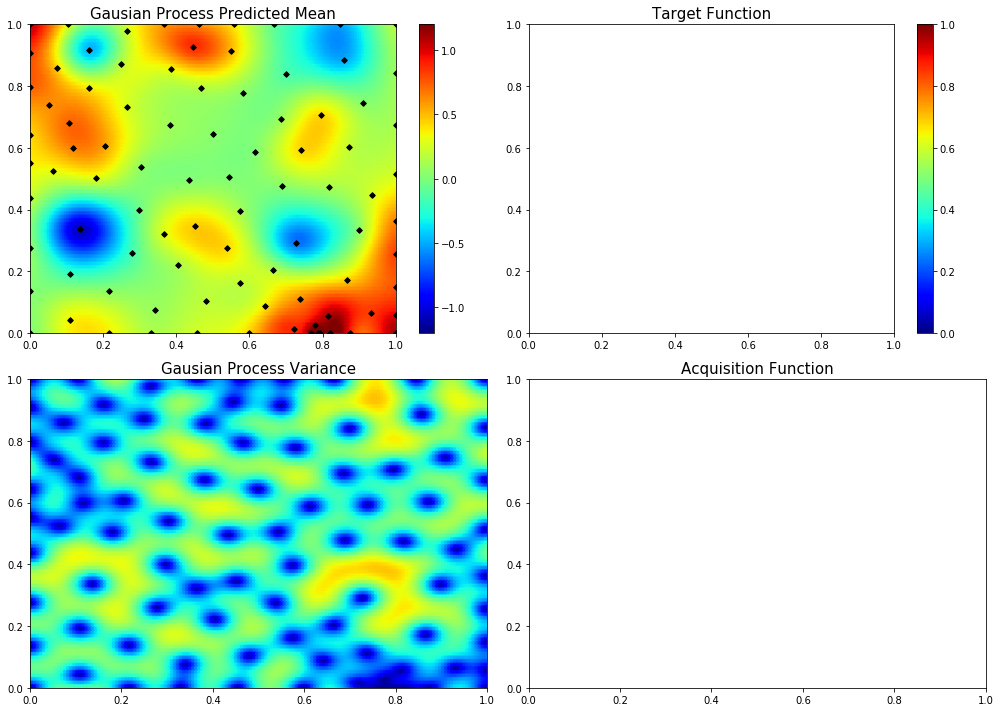

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7957072380279044, 0.7974511528862407]
15  Evaluations Remaining
|  91       | -0.1023   |  0.7957   |  0.7975   |
myplot:  091


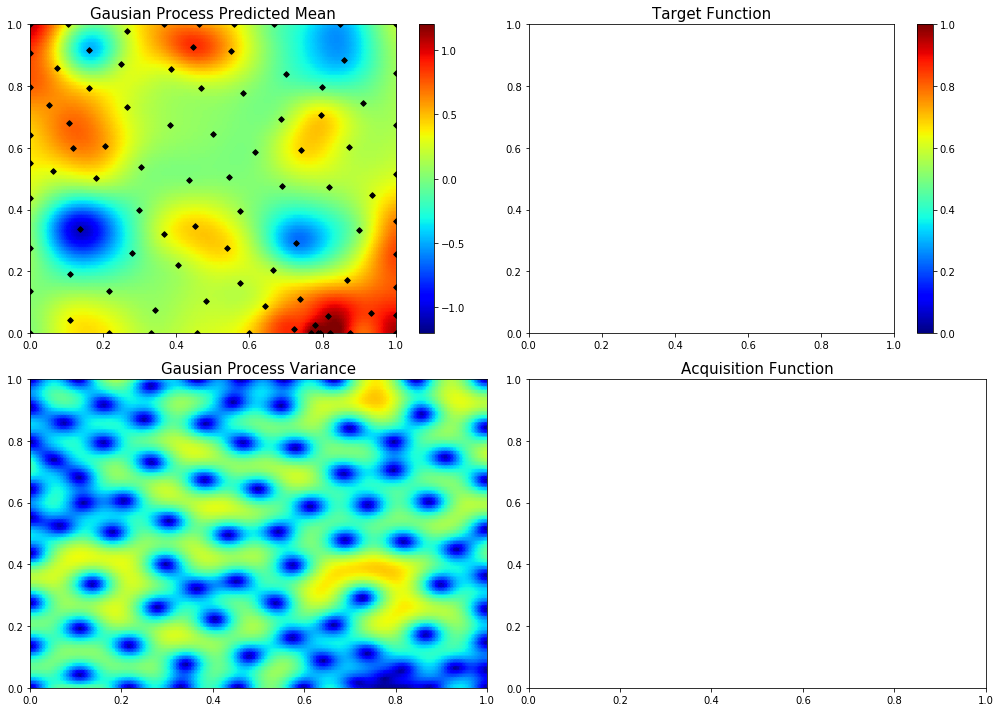

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.23240473916105728, 0.9273022823286269]
14  Evaluations Remaining
|  92       |  0.4464   |  0.2324   |  0.9273   |
myplot:  092


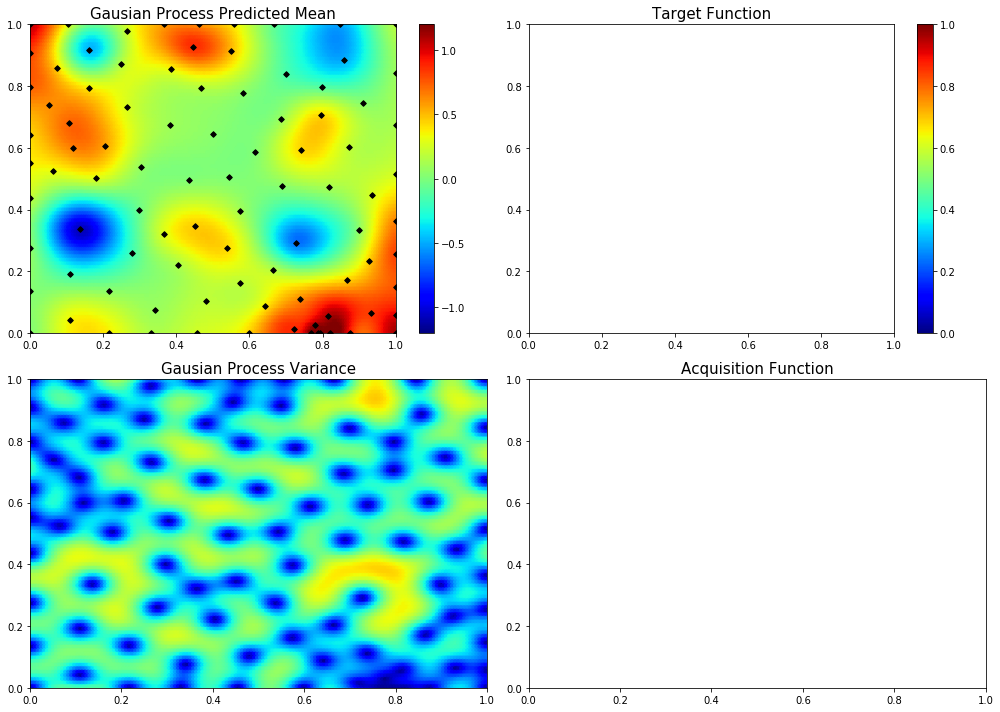

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.7704812150922581, 0.3510960594770565]
13  Evaluations Remaining
|  93       |  0.2137   |  0.7705   |  0.3511   |
myplot:  093


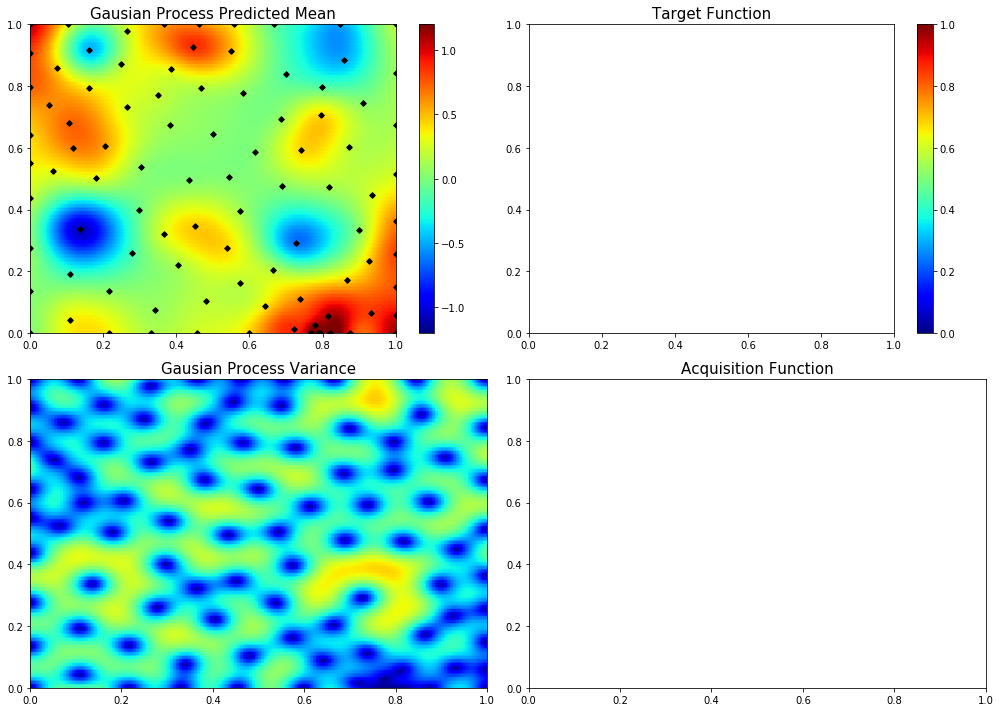

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.31154511002896834, 0.6256962491218857]
12  Evaluations Remaining
|  94       |  0.1034   |  0.3115   |  0.6257   |
myplot:  094


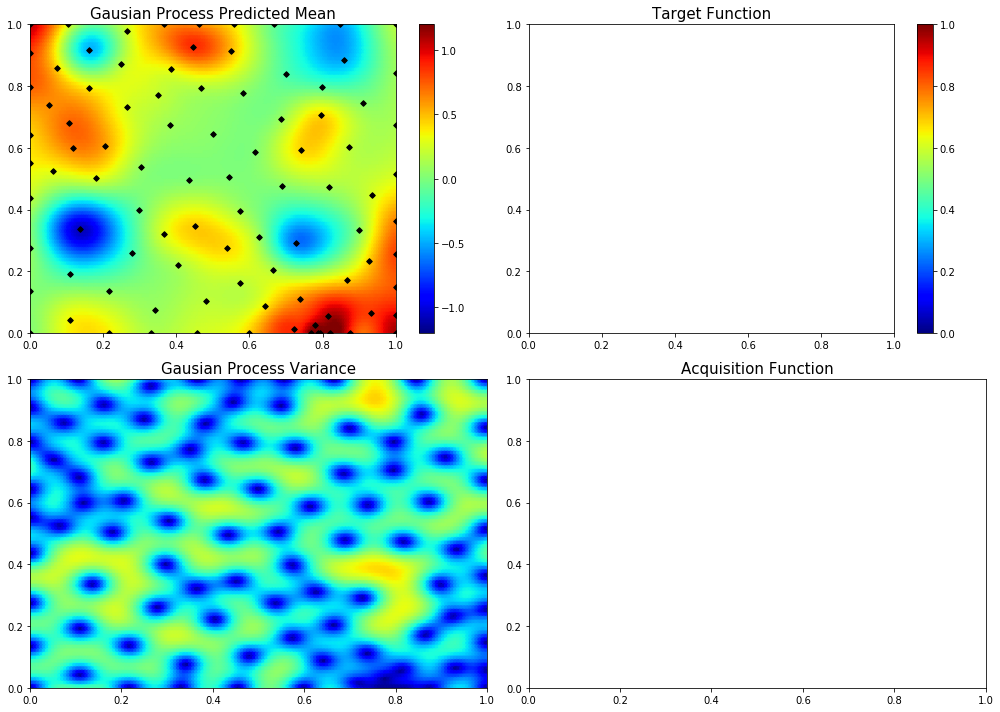

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6931962480811648, 0.18208259891945525]
11  Evaluations Remaining
|  95       |  0.7085   |  0.6932   |  0.1821   |
myplot:  095


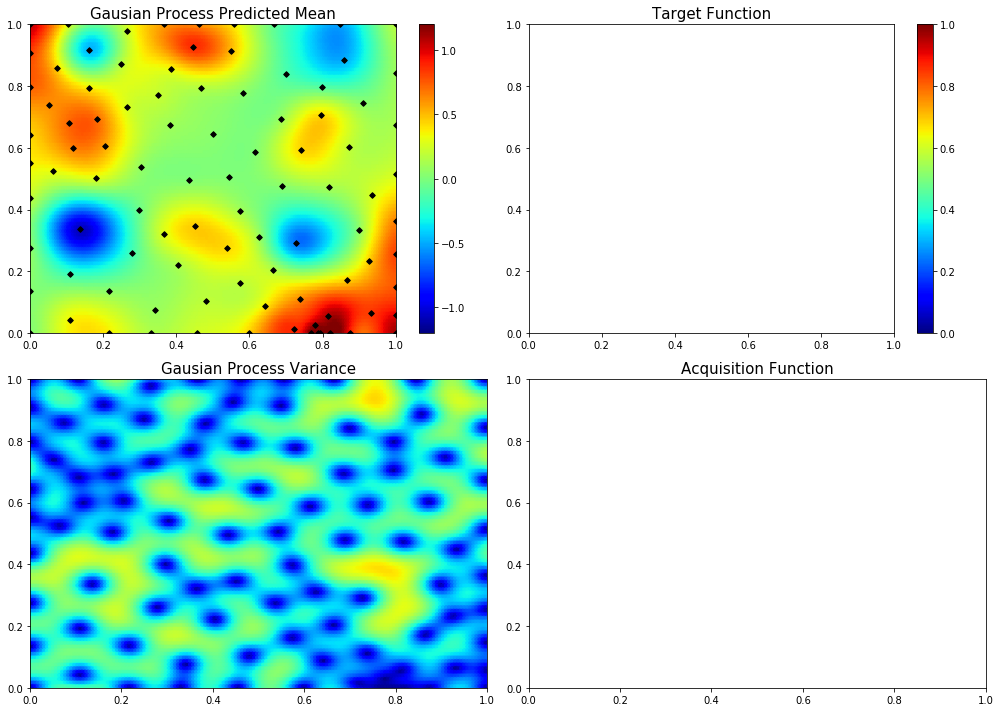

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.927288681658863, 0.34366141255572175]
10  Evaluations Remaining
|  96       |  0.5214   |  0.9273   |  0.3437   |
myplot:  096


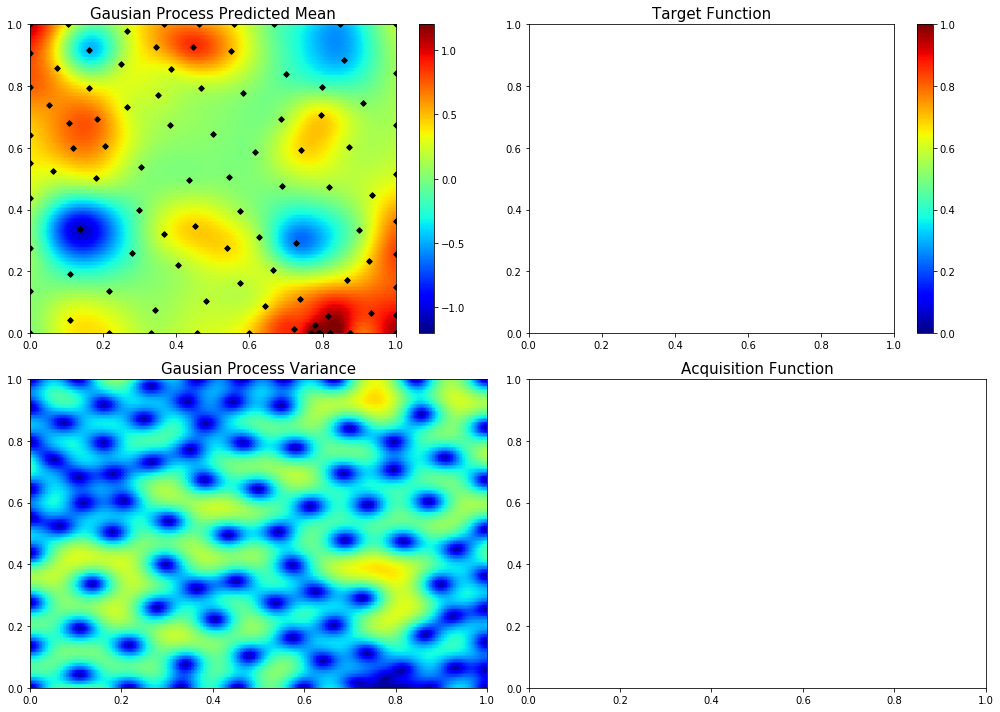

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.0947938562529019, 0.8691489146862483]
9  Evaluations Remaining
|  97       |  0.8327   |  0.09479  |  0.8691   |
myplot:  097


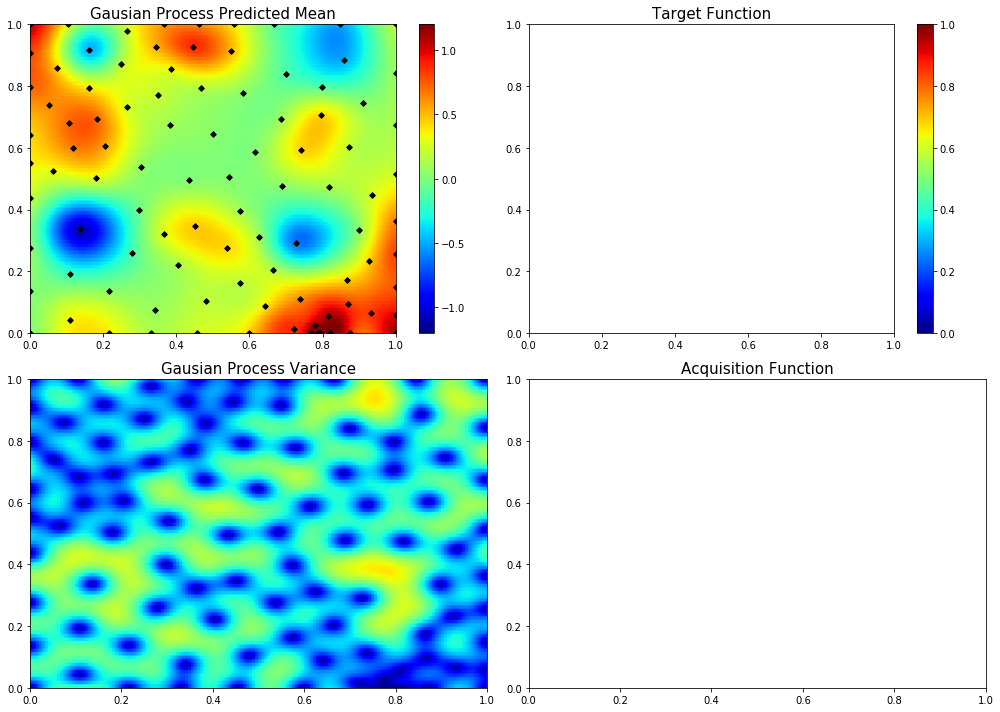

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.9582082575068488, 0.04059207601591565]
8  Evaluations Remaining
|  98       |  0.6277   |  0.9582   |  0.04059  |
myplot:  098


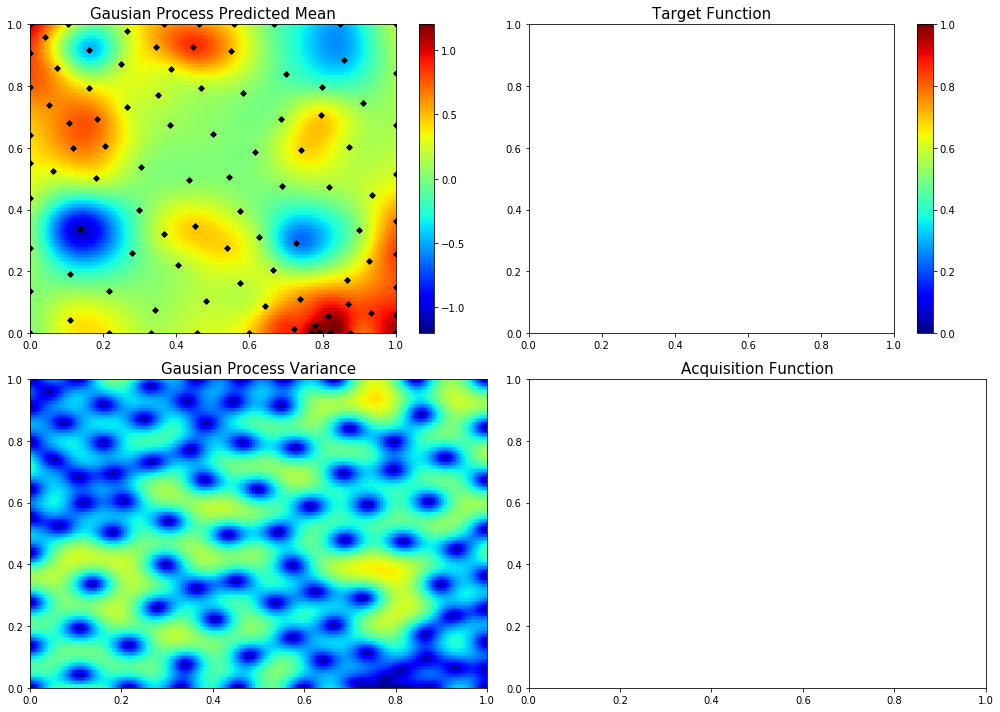

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.6400618792072196, 0.28634789252627424]
7  Evaluations Remaining
|  99       |  0.1985   |  0.6401   |  0.2863   |
myplot:  099


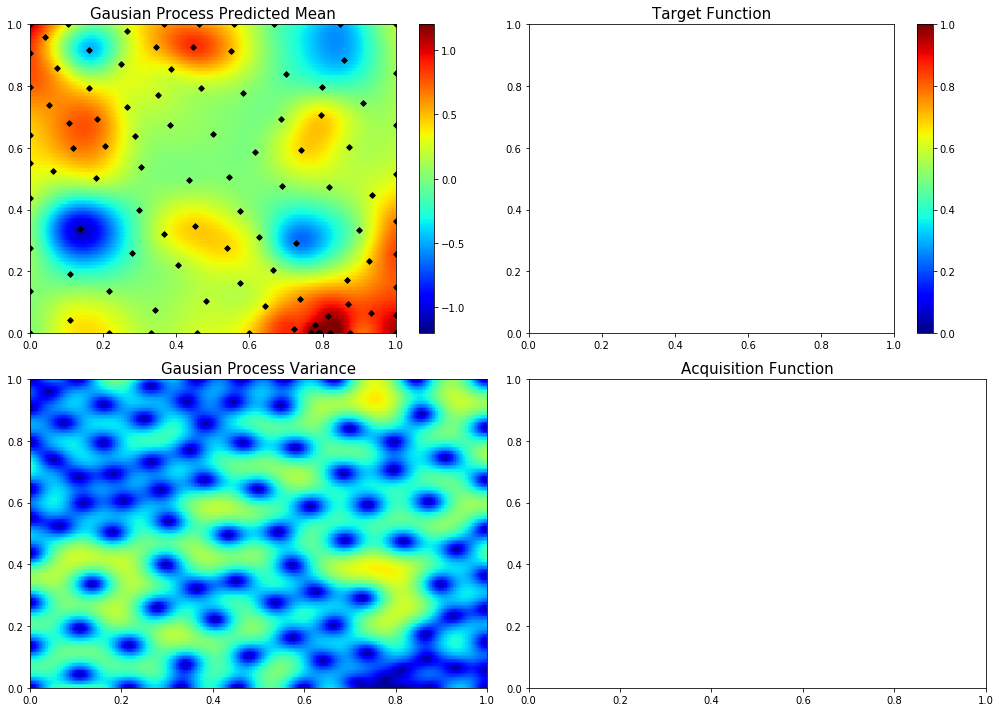

|   iter    |  target   |     x     |     y     |
-------------------------------------------------
action [0.4124787838060056, 0.39523304223758726]
6  Evaluations Remaining
|  100      |  0.07828  |  0.4125   |  0.3952   |
myplot:  100


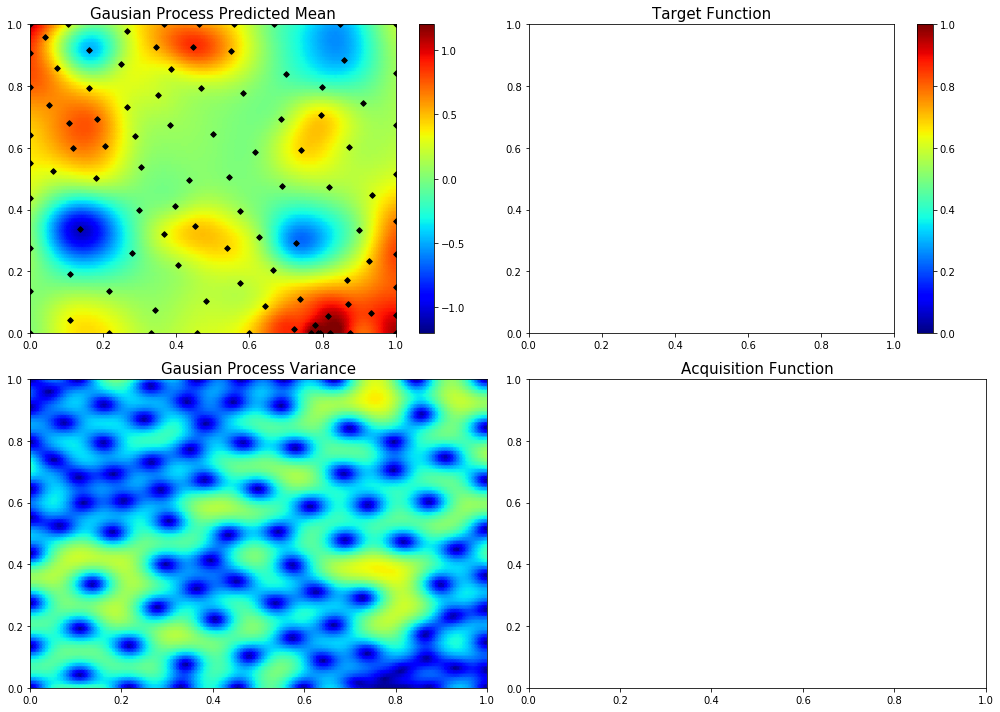

In [8]:
# Turn interactive plotting off
plt.ioff()
#policy =  [ [0.9991712478009906, 0.026881743252439638], [0.19702391566063626, 0.8142634903489118], [0.02287582405055888, 0.6499711714347374], [0.9944402045090077, 0.017507068898582667], [0.7295230492436623, 0.9926887775501024] ]

for i in range(95):
    bo.maximize(init_points=0, n_iter=1, acq='ucb', kappa=used_kappa)
    print("myplot: ", "{:03}".format(len(bo.space)) )
    plot_2d("{:03}".format(len(bo.space)))
    
    
    #invRL_score = invRL(policy)
    #if (i % 20 == 1 ): 
        #test_score = testHolePolicy(policy)
        #print("diff = ", invRL_score*90.0 - test_score)
    if (i==53):
        used_kappa = 8
    if (i==75):
        used_kappa = 7
    if (i==80):
        used_kappa = 5
    if (i==88):
        used_kappa = 3
        

In [21]:
def myRandom():
    return rand.random() # return round(rand.random(), 2)# TODO: remove this round thig # TODO run it more 

def GetRandPolicy():
    policy=[]
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()])
    policy.append([myRandom(),myRandom()]) 
    return policy


evolution = []
policies = []
maxReward= 0.0
nbTestedPolicy = 0


In [27]:
for _ in range(50000):
    if (nbTestedPolicy % 1000 == 0 ):
        print('nbTestedPolicy',nbTestedPolicy)
    nbTestedPolicy += 1
    
    policy = {}
    policy['nwemer'] = GetRandPolicy()
    with suppress_stdout():
        potentialReward = invRL(policy['nwemer'])
    if np.sum(potentialReward)<maxReward*0.9: continue
    print(policy)
        

    policy['AvgReward'] = np.mean(potentialReward)
    policy['maxRewards'] = np.max(potentialReward)
    policy['totRewards'] = np.sum(potentialReward)
    policy['Rewards'] = potentialReward
    policies.append(policy)



    policies.sort(key=lambda r: -r['totRewards'])
    evolution.append(policies[0]['AvgReward'])
    maxReward=policies[0]['totRewards']
    print("##################################################################")
    clear_output()
    
    print('totRewards',round(policies[0]['totRewards']))
    print('rewards',policies[0]['AvgReward'])
    print('maxRewards',round(policies[0]['maxRewards']))
    print('nbTestedPolicy',nbTestedPolicy)
    
    
    if len(policies)>10: 
        policies = policies[0:9]
    print(policies)
    print("##################################################################")
    print(evolution)

totRewards 388.0
rewards 77.56588986815306
maxRewards 109.0
nbTestedPolicy 199535
[{'nwemer': [[0.7360338591966769, 0.08551252543266274], [0.008773353042076446, 0.873528130763299], [0.9795704051275664, 0.012336987355697044], [0.015746371240541752, 0.7727636805532475], [0.6785701914116152, 0.04746010786699958]], 'AvgReward': 77.56588986815306, 'maxRewards': 108.88764862832154, 'totRewards': 387.82944934076534, 'Rewards': [array([57.8320982]), array([85.99011475]), array([84.11928408]), array([108.88764863]), array([51.00030368])]}, {'nwemer': [[0.020952996871980267, 0.9863894847135884], [0.8242051366901361, 0.007970423633783436], [0.06944018046851524, 0.7957965160289646], [0.7102875221697688, 0.040080075970023825], [0.050057213461744667, 0.9589879824517151]], 'AvgReward': 77.31953659097566, 'maxRewards': 95.39764175507433, 'totRewards': 386.5976829548783, 'Rewards': [array([95.39764176]), array([69.12450287]), array([87.64463965]), array([52.00331057]), array([82.4275881])]}, {'nwemer':

In [29]:
print('totRewards',policies[0]['totRewards'])
print('rewards',policies[0]['AvgReward'])
print('maxRewards',policies[0]['maxRewards'])
print('nbTestedPolicy',nbTestedPolicy)
policies[0]

totRewards 387.82944934076534
rewards 77.56588986815306
maxRewards 108.88764862832154
nbTestedPolicy 200000


{'nwemer': [[0.7360338591966769, 0.08551252543266274],
  [0.008773353042076446, 0.873528130763299],
  [0.9795704051275664, 0.012336987355697044],
  [0.015746371240541752, 0.7727636805532475],
  [0.6785701914116152, 0.04746010786699958]],
 'AvgReward': 77.56588986815306,
 'maxRewards': 108.88764862832154,
 'totRewards': 387.82944934076534,
 'Rewards': [array([57.8320982]),
  array([85.99011475]),
  array([84.11928408]),
  array([108.88764863]),
  array([51.00030368])]}

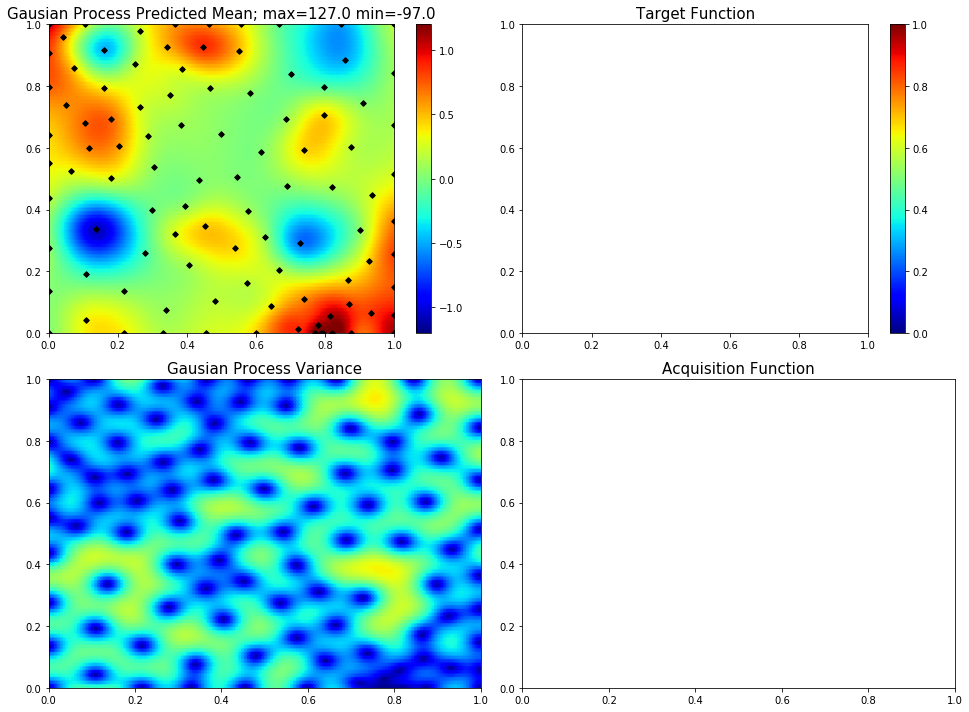

In [36]:
plot_2d()